In [1]:
import os

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import nibabel as nib
import seaborn as sns

from nilearn import plotting
from nilearn.image import new_img_like

In [2]:
import rsatoolbox
from rsatoolbox.inference import eval_fixed
from rsatoolbox.model import ModelFixed, Model
from rsatoolbox.rdm import RDMs
from rsatoolbox.vis import show_rdm, show_rdm_panel

from rsatoolbox.util.searchlight import get_volume_searchlight, get_searchlight_RDMs, evaluate_models_searchlight
from glob import glob

In [3]:
def upper_tri(RDM):
    """upper_tri returns the upper triangular index of an RDM

    Args:
        RDM 2Darray: squareform RDM

    Returns:
        1D array: upper triangular vector of the RDM
    """
    # returns the upper triangle
    m = RDM.shape[0]
    r, c = np.triu_indices(m, 1)
    return RDM[r, c]

In [4]:
project_dir = os.path.join('/bgfs/bchandrasekaran/krs228/data/', 'FLT/')
fmriprep_dir = os.path.join(project_dir, 'data_denoised/derivatives/',
                            'denoised_fmriprep-22.1.1/')

bidsroot = os.path.join(project_dir, 'data_denoised')
deriv_dir = os.path.join(bidsroot, 'derivatives')

fwhm_sub = 0
model_dir = os.path.join(deriv_dir, 'nilearn', 'level-1_fwhm-{:.02f}'.format(fwhm_sub),)

task_list = ['tonecat']
space_label = 'MNI152NLin2009cAsym'

In [5]:
statmap = 'tstat' # 'beta'

In [6]:
model_desc = 'stimulus_per_run_LSS'

In [7]:
model_dir

'/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00'

## Make categorical models

In [8]:
pattern_descriptors = {'tone': ['T1', 'T1', 'T1', 'T1', 
                                'T2', 'T2', 'T2', 'T2', 
                                'T3', 'T3', 'T3', 'T3', 
                                'T4', 'T4', 'T4', 'T4', ],
                       'talker': ['M1', 'M2', 'F1', 'F2',
                                  'M1', 'M2', 'F1', 'F2',
                                  'M1', 'M2', 'F1', 'F2',
                                  'M1', 'M2', 'F1', 'F2', ],
                      }
                                  

### Categorical RDMs

In [9]:
# make categorical RDMs
tone_rdm = np.array([[0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,],
                     [0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,],
                     [0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,],
                     [0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1,],
                     [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0,],
                     [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0,],
                     [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0,],
                     [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0,], ])

talker_rdm = np.array([[0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, ],
                       [1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, ],
                       [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, ],
                       [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, ],
                       [0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, ],
                       [1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, ],
                       [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, ],
                       [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, ],
                       [0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, ],
                       [1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, ],
                       [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, ],
                       [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, ],
                       [0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, ],
                       [1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, ],
                       [1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, ],
                       [1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, ], ])

rdms_array = np.array([tone_rdm, talker_rdm])

In [10]:
cat_rdms = RDMs(rdms_array,
                  rdm_descriptors={'categorical_model':['tone', 'talker'],},
                  pattern_descriptors=pattern_descriptors,
                  dissimilarity_measure='Euclidean'
                 )

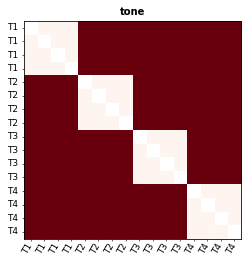

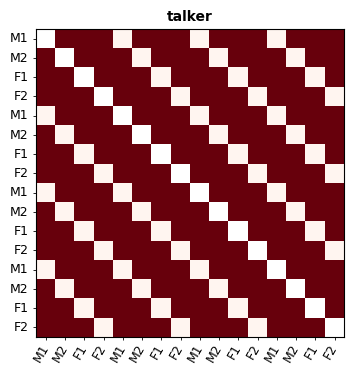

In [11]:
tone_rdms = cat_rdms.subset('categorical_model','tone')
fig, ax, ret_val = show_rdm(tone_rdms, rdm_descriptor='categorical_model', 
                            pattern_descriptor='tone', cmap='Reds', figsize=(4,4))

talker_rdms = cat_rdms.subset('categorical_model','talker')
fig, ax, ret_val = show_rdm(talker_rdms, rdm_descriptor='categorical_model', 
                            pattern_descriptor='talker', cmap='Reds', figsize=(4,4))

#### Convert from RDM to Model

In [12]:
tone_model = ModelFixed( 'Tone RDM', cat_rdms.subset('categorical_model', 'tone'))
talker_model = ModelFixed( 'Talker RDM', cat_rdms.subset('categorical_model', 'talker'))
cat_models = [tone_model, talker_model]

In [13]:
tone_model.name

'Tone RDM'

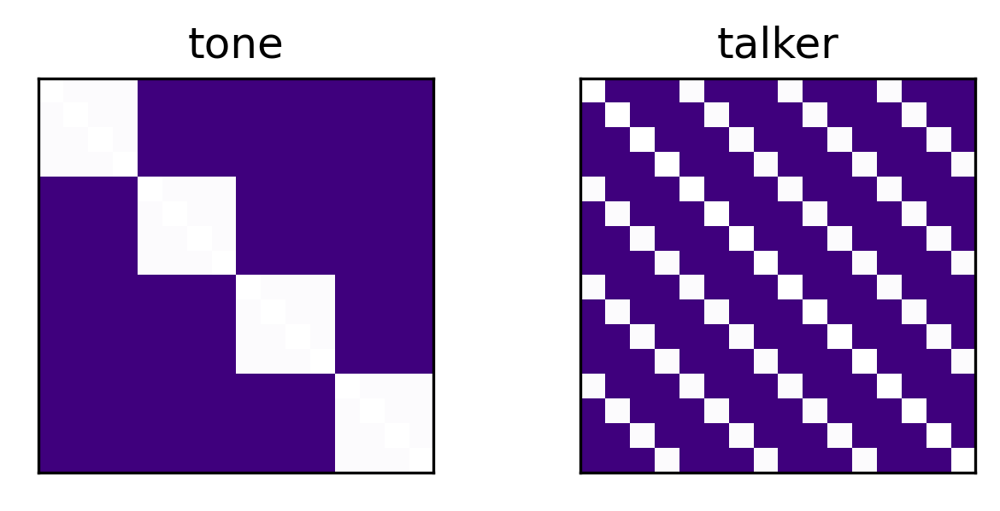

In [14]:
fig, axs = plt.subplots(1, 2, figsize=(5,2), dpi=300)

#show_rdm_panel(ffr_rdm, ax=axs.flat[0], rdm_descriptor='FFR model', cmap='inferno',)
show_rdm_panel(tone_rdms, ax=axs.flat[0], rdm_descriptor='categorical_model', cmap='Purples',)
show_rdm_panel(talker_rdms, ax=axs.flat[1], rdm_descriptor='categorical_model', cmap='Purples',)


## Set up participants

In [15]:
participants_fpath = os.path.join(bidsroot, 'participants.tsv')
participants_df = pd.read_csv(participants_fpath, sep='\t')

# subjects to ignore (not fully processed, etc.)
ignore_subs = ['sub-FLT27', # always leave out FLT27 – did not participate
               'sub-FLT07', # bad QA 11/14/23 
               'sub-FLT02', # incorrect button press coding for run00
              ]
participants_df.drop(participants_df[participants_df.participant_id.isin(ignore_subs)].index,
                     inplace=True)

# re-sort by participant ID
participants_df.sort_values(by=['participant_id'], 
                            ignore_index=True, 
                            inplace=True)

In [16]:
participants_df

,participant_id,age,sex,group,FFR_id
0,sub-FLT03,25,F,Mandarin,2002.0
1,sub-FLT04,21,F,non-Mandarin,1003.0
2,sub-FLT05,26,M,Mandarin,3010.0
3,sub-FLT06,21,F,non-Mandarin,3001.0
4,sub-FLT08,23,F,Mandarin,2005.0
5,sub-FLT09,30,F,non-Mandarin,3002.0
6,sub-FLT10,23,F,Mandarin,2006.0
7,sub-FLT11,20,F,non-Mandarin,1005.0
8,sub-FLT12,20,F,non-Mandarin,3004.0
9,sub-FLT13,23,F,non-Mandarin,3005.0


In [17]:
# create group-specific lists of subject IDs
sub_group_dict = {'Mandarin': list(participants_df.participant_id[participants_df.group=='Mandarin']),
                  'non-Mandarin': list(participants_df.participant_id[participants_df.group=='non-Mandarin'])}

In [18]:
sub_group_dict

{'Mandarin': ['sub-FLT03',
  'sub-FLT05',
  'sub-FLT08',
  'sub-FLT10',
  'sub-FLT15',
  'sub-FLT17',
  'sub-FLT18',
  'sub-FLT19',
  'sub-FLT21',
  'sub-FLT22',
  'sub-FLT23',
  'sub-FLT24',
  'sub-FLT26'],
 'non-Mandarin': ['sub-FLT04',
  'sub-FLT06',
  'sub-FLT09',
  'sub-FLT11',
  'sub-FLT12',
  'sub-FLT13',
  'sub-FLT14',
  'sub-FLT20',
  'sub-FLT25',
  'sub-FLT28',
  'sub-FLT30']}

In [19]:
participant_list = participants_df.participant_id
participant_list = [p.split('-')[1] for p in participant_list]
group_assignment = participants_df.group

# Run with striatal ROIs

## Define network ROIs

In [20]:
## define ROIs
network_name = 'tian_subcortical_S3' # 'tian_subcortical_S3' # auditory

if network_name == 'auditory':
    roi_list_ordered = [
                'L-IC', 'L-MGN', 'L-HG', 'L-PT',  'L-PP', 'L-STGp', 'L-STGa', 'L-ParsOp', 'L-ParsTri',
                'R-IC', 'R-MGN', 'R-HG', 'R-PT',  'R-PP', 'R-STGp', 'R-STGa', 'R-ParsOp', 'R-ParsTri', 
               ]
elif network_name == 'aud-striatal':
    roi_list_ordered = ['L-Caud', 'L-Put', 'L-IC', 'L-MGN',
                'L-HG', 'L-PP', 'L-PT', 'L-STGa', 'L-STGp', 
                'L-ParsOp', 'L-ParsTri',
                'R-Caud', 'R-Put','R-IC', 'R-MGN',
                'R-HG', 'R-PP', 'R-PT', 'R-STGa', 'R-STGp', 
                'R-ParsOp', 'R-ParsTri',
               ]
elif network_name == 'tian_subcortical_S3':
    roi_list_ordered = [
        'CAU-DA-lh', 'CAU-DA-rh', 
        'CAU-VA-lh', 'CAU-VA-rh', 
        'pCAU-lh', 'pCAU-rh', 
        'PUT-DA-lh', 'PUT-DA-rh', 
        'PUT-DP-lh', 'PUT-DP-rh', 
        'PUT-VA-lh', 'PUT-VA-rh', 
        'PUT-VP-lh', 'PUT-VP-rh',
        'NAc-core-lh',  'NAc-core-rh', 
        'NAc-shell-lh', 'NAc-shell-rh', 
         #'aGP-lh', 'pGP-lh', 
         #'aGP-rh', 'pGP-rh',         
               ]
    


## Load run-specific subject-specific RDMs

In [21]:
# from `rsa_roi.py`-generated outputs
group_rdm_list = []
for sx, sub_id in enumerate(participant_list): # enumerate(['FLT03']): #
    print(sub_id)
    group_id = group_assignment[sx]

    out_dir = os.path.join(model_dir, 'rsa_roi', network_name)
    sub_fpath = os.path.join(out_dir,
                         f'sub-{sub_id}_{network_name}_{model_desc}_rdms.hdf5')
    sub_rdm = rsatoolbox.rdm.rdms.load_rdm(sub_fpath)
    
    # add the group descriptor to the subject's RDM
    sub_rdm.rdm_descriptors['group'] = [group_id for x in sub_rdm.rdm_descriptors['index']]
    group_rdm_list.append(sub_rdm)
group_rdms = rsatoolbox.rdm.rdms.concat(group_rdm_list)

FLT03
FLT04
FLT05
FLT06
FLT08
FLT09
FLT10
FLT11
FLT12
FLT13
FLT14
FLT15
FLT17
FLT18
FLT19
FLT20
FLT21
FLT22
FLT23
FLT24
FLT25
FLT26
FLT28
FLT30


### Per "stage" (runcombo), per subject

In [22]:
runcombo_dict = {'early': ['run00', 'run01'], 
                 'middle': ['run02', 'run03'], 
                 'final': ['run04','run05']}

#### Load run-specific subject-specific behavioral confusion matrices

In [23]:
beh_mat_dict = {}
for sx, sub_id in enumerate(participant_list): 
    print(sub_id)
    group_id = group_assignment[sx]
    
    sub_beh_dir = os.path.join(deriv_dir, 'behavior', f'sub-{sub_id}')
    
    sub_cm_dict = {}
    sub_cm_list = []
    for rx, run in enumerate(np.unique(group_rdms.rdm_descriptors['run'])):
        sub_run_stim_cm = np.genfromtxt(os.path.join(sub_beh_dir, f'sub-{sub_id}_run-0{rx+1}_stimulus_confusion_matrix.tsv'))
        
        sub_cm_dict[run] = sub_run_stim_cm
        sub_cm_list.append(sub_run_stim_cm)
        
    beh_mat_dict[sub_id] = sub_cm_dict

FLT03
FLT04
FLT05
FLT06
FLT08
FLT09
FLT10
FLT11
FLT12
FLT13
FLT14
FLT15
FLT17
FLT18
FLT19
FLT20
FLT21
FLT22
FLT23
FLT24
FLT25
FLT26
FLT28
FLT30


#### Combine early, middle, and final run behavior RDMs

In [24]:
stage_beh_mat_dict = {}
for sub_id in beh_mat_dict:
    print(sub_id)
    
    sub_dict = {}
    sub_early_mat = np.mean(np.array([beh_mat_dict[sub_id]['run00'], beh_mat_dict[sub_id]['run01']]), axis=0)
    sub_middle_mat = np.mean(np.array([beh_mat_dict[sub_id]['run02'], beh_mat_dict[sub_id]['run03']]), axis=0)
    sub_final_mat = np.mean(np.array([beh_mat_dict[sub_id]['run04'], beh_mat_dict[sub_id]['run05']]), axis=0)
    
    sub_dict['early'] = sub_early_mat
    sub_dict['middle'] = sub_middle_mat
    sub_dict['final'] = sub_final_mat
    
    stage_beh_mat_dict[sub_id] = sub_dict

FLT03
FLT04
FLT05
FLT06
FLT08
FLT09
FLT10
FLT11
FLT12
FLT13
FLT14
FLT15
FLT17
FLT18
FLT19
FLT20
FLT21
FLT22
FLT23
FLT24
FLT25
FLT26
FLT28
FLT30


### Participant-specific across-model comparisons

In [25]:
group_dict = {}

for group_id in np.unique(group_rdms.rdm_descriptors['group']):

    for full_sub_id in sub_group_dict[group_id]:
        sub_id = full_sub_id[4:]
        try:
            ffr_id = str(int(participants_df[participants_df['participant_id'] == full_sub_id]['FFR_id'].values[0]))
            print(f'{sub_id} | ffr_id: {ffr_id}')
        except ValueError:
            print(f'no ffr_id for {sub_id}')
            continue

        sub_dict = {}

        for runcombo in runcombo_dict:
            # initialize results list
            runcombo_roi_res_dict = {}
            
            # create beh model from confusion matrix
            beh_mat = stage_beh_mat_dict[sub_id][runcombo]
            beh_dis_mat = beh_mat * -1 +1
        
            beh_rdm = RDMs(np.array([beh_dis_mat],))
            beh_model = ModelFixed('Behavior Model', rdm=beh_rdm)
            
            # combine all four models to run concurrently
            all_models = [tone_model, talker_model, beh_model]

            for ROI in roi_list_ordered: #np.unique(group_rdms.rdm_descriptors['ROI']):
                if 'GP' not in ROI:
                    print(f'{sub_id} runcombo-{runcombo} ROI-{ROI}')
                    runs = runcombo_dict[runcombo]

                    results_grr = rsatoolbox.inference.eval_fixed(all_models, #ffr_model, 
                                                                  group_rdms.subset('participant', value=sub_id).subset('run',value=runs).subset('ROI',value=ROI),  
                                                                  method='corr',)
                    #print(f'p-value vs. 0: {results_grr.test_zero()[0]:.04f}')
                    runcombo_roi_res_dict[ROI] = results_grr.get_means()#[0]
                    #runcombo_roi_res_dict[ROI] = results_grr

            sub_dict[runcombo] = runcombo_roi_res_dict

        #except:
        #    print(f'no FFR data for {sub_id}')
        group_dict[sub_id] = sub_dict

FLT03 | ffr_id: 2002
FLT03 runcombo-early ROI-CAU-DA-lh
FLT03 runcombo-early ROI-CAU-DA-rh
FLT03 runcombo-early ROI-CAU-VA-lh
FLT03 runcombo-early ROI-CAU-VA-rh
FLT03 runcombo-early ROI-pCAU-lh
FLT03 runcombo-early ROI-pCAU-rh
FLT03 runcombo-early ROI-PUT-DA-lh
FLT03 runcombo-early ROI-PUT-DA-rh
FLT03 runcombo-early ROI-PUT-DP-lh
FLT03 runcombo-early ROI-PUT-DP-rh
FLT03 runcombo-early ROI-PUT-VA-lh
FLT03 runcombo-early ROI-PUT-VA-rh
FLT03 runcombo-early ROI-PUT-VP-lh
FLT03 runcombo-early ROI-PUT-VP-rh
FLT03 runcombo-early ROI-NAc-core-lh
FLT03 runcombo-early ROI-NAc-core-rh
FLT03 runcombo-early ROI-NAc-shell-lh
FLT03 runcombo-early ROI-NAc-shell-rh
FLT03 runcombo-middle ROI-CAU-DA-lh
FLT03 runcombo-middle ROI-CAU-DA-rh
FLT03 runcombo-middle ROI-CAU-VA-lh
FLT03 runcombo-middle ROI-CAU-VA-rh
FLT03 runcombo-middle ROI-pCAU-lh
FLT03 runcombo-middle ROI-pCAU-rh
FLT03 runcombo-middle ROI-PUT-DA-lh
FLT03 runcombo-middle ROI-PUT-DA-rh
FLT03 runcombo-middle ROI-PUT-DP-lh
FLT03 runcombo-middle R

In [26]:
print(results_grr)

Results for running fixed evaluation for corr on 3 models:

Model          |   Eval ± SEM   | p (against 0) | p (against NC) |
------------------------------------------------------------------
Tone RDM       |  0.043 ± 0.085 |        0.351  |         0.987  |
Talker RDM     | -0.047 ± 0.077 |        0.674  |         0.445  |
Behavior Model | -0.023 ± 0.065 |        0.607  |         0.487  |

p-values are based on uncorrected t-tests


#### Make dataframe

In [27]:
group_df_list = []
for group_id in np.unique(group_rdms.rdm_descriptors['group']):
    print(group_id)
    sub_df_list = []
    
    for full_sub_id in sub_group_dict[group_id]:
        try:
            sub_id = full_sub_id[4:]

            sub_df = pd.DataFrame.from_dict(group_dict[sub_id])
            sub_df['sub_id'] = sub_id
            sub_df_list.append(sub_df)
        except KeyError:
            print(f'not available for {full_sub_id}')

    group_df = pd.concat(sub_df_list)
    group_df.reset_index(inplace=True)
    long_group_df = group_df.melt(value_vars=['early','middle','final'], id_vars='index', value_name='corr', var_name='stage', ignore_index=False)
    long_group_df['participant_group'] = group_id
    long_group_df.rename(columns={"index": "ROI"}, inplace=True)
    
    group_df_list.append(long_group_df)

long_df = pd.concat(group_df_list)

Mandarin
not available for sub-FLT17
not available for sub-FLT26
non-Mandarin
not available for sub-FLT28
not available for sub-FLT30


In [28]:
# get model names for the models in the RSA operation
model_names = [x.name for x in results_grr.models]
print(model_names)

['Tone RDM', 'Talker RDM', 'Behavior Model']


In [29]:
# split the results arrays into single-element columns by model
long_df[model_names] = long_df['corr'].to_list()
long_df.drop('corr', axis='columns', inplace=True) 

In [30]:
long_df

,ROI,stage,participant_group,Tone RDM,Talker RDM,Behavior Model
0,CAU-DA-lh,early,Mandarin,0.035841,0.090843,0.021942
1,CAU-DA-rh,early,Mandarin,0.067888,-0.035757,0.054554
2,CAU-VA-lh,early,Mandarin,-0.052462,0.094342,-0.056194
3,CAU-VA-rh,early,Mandarin,-0.012262,0.092696,-0.020055
4,pCAU-lh,early,Mandarin,0.121956,0.026201,0.109411
...,...,...,...,...,...,...
157,PUT-VP-rh,final,non-Mandarin,0.024422,-0.030956,-0.094297
158,NAc-core-lh,final,non-Mandarin,0.008486,-0.036883,-0.190773
159,NAc-core-rh,final,non-Mandarin,0.004570,-0.051711,-0.143751
160,NAc-shell-lh,final,non-Mandarin,0.019007,0.002302,-0.048034


In [31]:
# reshape the dataframe again
model_long_df = long_df.melt(value_vars=model_names, 
                             id_vars=['ROI', 'stage', 'participant_group'], 
                             value_name='corr', 
                             var_name='model', 
                             ignore_index=False)
model_long_df.reset_index(inplace=True)

# get rid of "middle" stage
model_long_df.drop(model_long_df[model_long_df.stage=='middle'].index, inplace=True)

In [32]:
model_long_df

,index,ROI,stage,participant_group,model,corr
0,0,CAU-DA-lh,early,Mandarin,Tone RDM,0.035841
1,1,CAU-DA-rh,early,Mandarin,Tone RDM,0.067888
2,2,CAU-VA-lh,early,Mandarin,Tone RDM,-0.052462
3,3,CAU-VA-rh,early,Mandarin,Tone RDM,-0.012262
4,4,pCAU-lh,early,Mandarin,Tone RDM,0.121956
...,...,...,...,...,...,...
3235,157,PUT-VP-rh,final,non-Mandarin,Behavior Model,-0.094297
3236,158,NAc-core-lh,final,non-Mandarin,Behavior Model,-0.190773
3237,159,NAc-core-rh,final,non-Mandarin,Behavior Model,-0.143751
3238,160,NAc-shell-lh,final,non-Mandarin,Behavior Model,-0.048034


#### Move hemisphere to separate column

In [33]:
laterality_df = model_long_df.copy()
laterality_df['hemisphere'] = laterality_df['ROI'].str[-2:]
laterality_df['ROI'] = laterality_df['ROI'].str[:-3]

In [34]:
laterality_df

,index,ROI,stage,participant_group,model,corr,hemisphere
0,0,CAU-DA,early,Mandarin,Tone RDM,0.035841,lh
1,1,CAU-DA,early,Mandarin,Tone RDM,0.067888,rh
2,2,CAU-VA,early,Mandarin,Tone RDM,-0.052462,lh
3,3,CAU-VA,early,Mandarin,Tone RDM,-0.012262,rh
4,4,pCAU,early,Mandarin,Tone RDM,0.121956,lh
...,...,...,...,...,...,...,...
3235,157,PUT-VP,final,non-Mandarin,Behavior Model,-0.094297,rh
3236,158,NAc-core,final,non-Mandarin,Behavior Model,-0.190773,lh
3237,159,NAc-core,final,non-Mandarin,Behavior Model,-0.143751,rh
3238,160,NAc-shell,final,non-Mandarin,Behavior Model,-0.048034,lh


In [35]:
np.unique(laterality_df.ROI)

array(['CAU-DA', 'CAU-VA', 'NAc-core', 'NAc-shell', 'PUT-DA', 'PUT-DP',
       'PUT-VA', 'PUT-VP', 'pCAU'], dtype=object)

#### Move subdivision to separate column

In [36]:
'CAU-DA'.split('-')[1]

'DA'

In [37]:
striatal_df = laterality_df.copy()
split_df = striatal_df['ROI'].str.split('-', expand=True)
split_df.columns = ['region','subdivision']
split_df.loc[split_df.region=='pCAU','subdivision'] = 'post'
striatal_df = striatal_df.join(split_df)
striatal_df

,index,ROI,stage,participant_group,model,corr,hemisphere,region,subdivision
0,0,CAU-DA,early,Mandarin,Tone RDM,0.035841,lh,CAU,DA
1,1,CAU-DA,early,Mandarin,Tone RDM,0.067888,rh,CAU,DA
2,2,CAU-VA,early,Mandarin,Tone RDM,-0.052462,lh,CAU,VA
3,3,CAU-VA,early,Mandarin,Tone RDM,-0.012262,rh,CAU,VA
4,4,pCAU,early,Mandarin,Tone RDM,0.121956,lh,pCAU,post
...,...,...,...,...,...,...,...,...,...
3235,157,PUT-VP,final,non-Mandarin,Behavior Model,-0.094297,rh,PUT,VP
3236,158,NAc-core,final,non-Mandarin,Behavior Model,-0.190773,lh,NAc,core
3237,159,NAc-core,final,non-Mandarin,Behavior Model,-0.143751,rh,NAc,core
3238,160,NAc-shell,final,non-Mandarin,Behavior Model,-0.048034,lh,NAc,shell


#### Make rostral/caudal column

In [130]:
rostcaud_df = striatal_df.copy()

# create a new column based on rostral–caudal axis
rostcaud_df['Axis'] = np.nan

rostcaud_df['Axis'].loc[antpost_df['ROI']=='pCAU'] = 'Caudal'
rostcaud_df['Axis'].loc[antpost_df['ROI']=='PUT-VP'] = 'Caudal'
rostcaud_df['Axis'].loc[antpost_df['ROI']=='PUT-DP'] = 'Caudal'

rostcaud_df['Axis'].loc[antpost_df['region']=='CAU'] = 'Rostral'
rostcaud_df['Axis'].loc[antpost_df['ROI']=='PUT-VA'] = 'Rostral'
rostcaud_df['Axis'].loc[antpost_df['ROI']=='PUT-DA'] = 'Rostral'
rostcaud_df['Axis'].loc[antpost_df['region']=='NAc'] = 'Ventral'

rostcaud_df

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


,index,ROI,stage,participant_group,model,corr,hemisphere,region,subdivision,Axis
0,0,CAU-DA,early,Mandarin,Tone RDM,0.035841,lh,CAU,DA,Rostral
1,1,CAU-DA,early,Mandarin,Tone RDM,0.067888,rh,CAU,DA,Rostral
2,2,CAU-VA,early,Mandarin,Tone RDM,-0.052462,lh,CAU,VA,Rostral
3,3,CAU-VA,early,Mandarin,Tone RDM,-0.012262,rh,CAU,VA,Rostral
4,4,pCAU,early,Mandarin,Tone RDM,0.121956,lh,pCAU,post,Caudal
...,...,...,...,...,...,...,...,...,...,...
3235,157,PUT-VP,final,non-Mandarin,Behavior Model,-0.094297,rh,PUT,VP,Caudal
3236,158,NAc-core,final,non-Mandarin,Behavior Model,-0.190773,lh,NAc,core,Ventral
3237,159,NAc-core,final,non-Mandarin,Behavior Model,-0.143751,rh,NAc,core,Ventral
3238,160,NAc-shell,final,non-Mandarin,Behavior Model,-0.048034,lh,NAc,shell,Ventral


In [131]:
# separately, split the 4 putamen subdivisions into anterior and posterior
rostcaud_df['region_split'] = rostcaud_df['region']
rostcaud_df['region_split'].loc[rostcaud_df['ROI']=='PUT-VP'] = 'pPUT'
rostcaud_df['region_split'].loc[rostcaud_df['ROI']=='PUT-DP'] = 'pPUT'
rostcaud_df['region_split'].loc[rostcaud_df['ROI']=='PUT-VA'] = 'aPUT'
rostcaud_df['region_split'].loc[rostcaud_df['ROI']=='PUT-DA'] = 'aPUT'

rostcaud_df

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


,index,ROI,stage,participant_group,model,corr,hemisphere,region,subdivision,Axis,region_split
0,0,CAU-DA,early,Mandarin,Tone RDM,0.035841,lh,CAU,DA,Rostral,CAU
1,1,CAU-DA,early,Mandarin,Tone RDM,0.067888,rh,CAU,DA,Rostral,CAU
2,2,CAU-VA,early,Mandarin,Tone RDM,-0.052462,lh,CAU,VA,Rostral,CAU
3,3,CAU-VA,early,Mandarin,Tone RDM,-0.012262,rh,CAU,VA,Rostral,CAU
4,4,pCAU,early,Mandarin,Tone RDM,0.121956,lh,pCAU,post,Caudal,pCAU
...,...,...,...,...,...,...,...,...,...,...,...
3235,157,PUT-VP,final,non-Mandarin,Behavior Model,-0.094297,rh,PUT,VP,Caudal,pPUT
3236,158,NAc-core,final,non-Mandarin,Behavior Model,-0.190773,lh,NAc,core,Ventral,NAc
3237,159,NAc-core,final,non-Mandarin,Behavior Model,-0.143751,rh,NAc,core,Ventral,NAc
3238,160,NAc-shell,final,non-Mandarin,Behavior Model,-0.048034,lh,NAc,shell,Ventral,NAc


In [132]:
rostcaud_df[rostcaud_df['region_split']=='aPUT']

,index,ROI,stage,participant_group,model,corr,hemisphere,region,subdivision,Axis,region_split
6,6,PUT-DA,early,Mandarin,Tone RDM,0.055641,lh,PUT,DA,Rostral,aPUT
7,7,PUT-DA,early,Mandarin,Tone RDM,0.046433,rh,PUT,DA,Rostral,aPUT
10,10,PUT-VA,early,Mandarin,Tone RDM,0.031601,lh,PUT,VA,Rostral,aPUT
11,11,PUT-VA,early,Mandarin,Tone RDM,0.056141,rh,PUT,VA,Rostral,aPUT
24,24,PUT-DA,early,Mandarin,Tone RDM,-0.043404,lh,PUT,DA,Rostral,aPUT
...,...,...,...,...,...,...,...,...,...,...,...
3215,137,PUT-VA,final,non-Mandarin,Behavior Model,0.049463,rh,PUT,VA,Rostral,aPUT
3228,150,PUT-DA,final,non-Mandarin,Behavior Model,-0.226597,lh,PUT,DA,Rostral,aPUT
3229,151,PUT-DA,final,non-Mandarin,Behavior Model,-0.103853,rh,PUT,DA,Rostral,aPUT
3232,154,PUT-VA,final,non-Mandarin,Behavior Model,-0.137259,lh,PUT,VA,Rostral,aPUT


## statistics

In [62]:
from scipy import stats

#### By group, all runs

In [131]:
# Combining hemispheres
print('all runs')
#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'

group_long_df = laterality_df.where(laterality_df.participant_group==group_id).dropna()
print(f'\ngroup = {group_id}')

for model_id in model_names:
    print(f'\n{model_id}')
    model_df = group_long_df.where(group_long_df.model==model_id).dropna()

    roi_list = []
    p_vals = []
    t_stats = []

    for roi in np.unique(model_df.ROI): # roi_list_ordered: # np.unique(group_rdms.rdm_descriptors['ROI']):
        #print(roi)
        groi_data = model_df.where(model_df.ROI==roi).dropna()['corr']
        res = stats.ttest_1samp(groi_data, popmean=0)

        p_vals.append(res.pvalue)
        t_stats.append(res.statistic)
        roi_list.append(roi)
        #print(res.pvalue)
    p_vals_adj = stats.false_discovery_control(p_vals)


    print('\nFDR-adjusted statistics')
    for rx, roi in enumerate(roi_list):
        if p_vals_adj[rx] < 0.05:
            ast = '**'
        elif p_vals[rx] < 0.05:
            ast = ' *'
        else:
            ast = '  '
        print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')


all runs

group = non-Mandarin

Tone RDM

FDR-adjusted statistics
**t = 3.75 FDR-corr p = 0.0029 uncorr p = 0.0006 region = CAU-DA
**t = 2.76 FDR-corr p = 0.0178 uncorr p = 0.0092 region = CAU-VA
**t = 2.38 FDR-corr p = 0.0296 uncorr p = 0.0230 region = NAc-core
  t = 1.34 FDR-corr p = 0.2137 uncorr p = 0.1900 region = NAc-shell
**t = 2.59 FDR-corr p = 0.0210 uncorr p = 0.0140 region = PUT-DA
**t = 2.73 FDR-corr p = 0.0178 uncorr p = 0.0099 region = PUT-DP
**t = 2.89 FDR-corr p = 0.0178 uncorr p = 0.0066 region = PUT-VA
  t = 1.16 FDR-corr p = 0.2524 uncorr p = 0.2524 region = PUT-VP
**t = 5.21 FDR-corr p = 0.0001 uncorr p = 0.0000 region = pCAU

Talker RDM

FDR-adjusted statistics
  t = 1.22 FDR-corr p = 0.8935 uncorr p = 0.2292 region = CAU-DA
  t = 0.46 FDR-corr p = 0.8935 uncorr p = 0.6490 region = CAU-VA
  t = -0.31 FDR-corr p = 0.8935 uncorr p = 0.7553 region = NAc-core
  t = 0.61 FDR-corr p = 0.8935 uncorr p = 0.5441 region = NAc-shell
  t = -0.13 FDR-corr p = 0.8935 uncorr p = 

In [85]:
np.unique(group_long_df.region_split)

array(['CAU', 'NAc', 'pCAU', 'pPUT'], dtype=object)

In [113]:
# Combining subdivisions
print('all runs')
#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'

group_long_df = rostcaud_df.where(rostcaud_df.participant_group==group_id).dropna()
print(f'\ngroup = {group_id}')

for model_id in model_names:
    print(f'\n{model_id}')
    model_df = group_long_df.where(group_long_df.model==model_id).dropna()

    roi_list = []
    p_vals = []
    t_stats = []

    for roi in np.unique(model_df.region_split): # roi_list_ordered: # np.unique(group_rdms.rdm_descriptors['ROI']):
        #print(roi)
        groi_data = model_df.where(model_df.region_split==roi).dropna()['corr']
        res = stats.ttest_1samp(groi_data, popmean=0)

        p_vals.append(res.pvalue)
        t_stats.append(res.statistic)
        roi_list.append(roi)
        #print(res.pvalue)
    p_vals_adj = stats.false_discovery_control(p_vals)

    for rx, roi in enumerate(np.unique(model_df.region_split)):
        if p_vals_adj[rx] < 0.05:
            ast = '**'
        elif p_vals[rx] < 0.05:
            ast = ' *'
        else:
            ast = '  '
        print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')


all runs

group = non-Mandarin

Tone RDM
**t = 4.55 FDR-corr p = 0.0001 uncorr p = 0.0000 region = CAU
**t = 2.57 FDR-corr p = 0.0123 uncorr p = 0.0123 region = NAc
**t = 3.90 FDR-corr p = 0.0004 uncorr p = 0.0002 region = aPUT
**t = 5.21 FDR-corr p = 0.0000 uncorr p = 0.0000 region = pCAU
**t = 2.63 FDR-corr p = 0.0123 uncorr p = 0.0104 region = pPUT

Talker RDM
  t = 1.18 FDR-corr p = 0.8944 uncorr p = 0.2407 region = CAU
  t = 0.27 FDR-corr p = 0.8944 uncorr p = 0.7890 region = NAc
  t = 0.13 FDR-corr p = 0.8944 uncorr p = 0.8944 region = aPUT
  t = 0.64 FDR-corr p = 0.8944 uncorr p = 0.5292 region = pCAU
  t = -0.26 FDR-corr p = 0.8944 uncorr p = 0.7969 region = pPUT

Behavior Model
**t = 4.48 FDR-corr p = 0.0001 uncorr p = 0.0000 region = CAU
**t = 3.27 FDR-corr p = 0.0016 uncorr p = 0.0016 region = NAc
**t = 3.63 FDR-corr p = 0.0007 uncorr p = 0.0005 region = aPUT
**t = 4.46 FDR-corr p = 0.0002 uncorr p = 0.0001 region = pCAU
**t = 4.06 FDR-corr p = 0.0002 uncorr p = 0.0001 regio

In [114]:
# Combining subdivisions
print('all runs')
#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'

group_long_df = striatal_df.where(striatal_df.participant_group==group_id).dropna()
print(f'\ngroup = {group_id}')

for model_id in model_names:
    print(f'\n{model_id}')
    model_df = group_long_df.where(group_long_df.model==model_id).dropna()

    roi_list = []
    p_vals = []
    t_stats = []

    for roi in np.unique(model_df.region): # roi_list_ordered: # np.unique(group_rdms.rdm_descriptors['ROI']):
        #print(roi)
        groi_data = model_df.where(model_df.region==roi).dropna()['corr']
        res = stats.ttest_1samp(groi_data, popmean=0)

        p_vals.append(res.pvalue)
        t_stats.append(res.statistic)
        roi_list.append(roi)
        #print(res.pvalue)
    p_vals_adj = stats.false_discovery_control(p_vals)

    for rx, roi in enumerate(roi_list):
        if p_vals_adj[rx] < 0.05:
            ast = '**'
        elif p_vals[rx] < 0.05:
            ast = ' *'
        else:
            ast = '  '
        print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')


all runs

group = non-Mandarin

Tone RDM
**t = 4.55 FDR-corr p = 0.0000 uncorr p = 0.0000 region = CAU
**t = 2.57 FDR-corr p = 0.0123 uncorr p = 0.0123 region = NAc
**t = 4.57 FDR-corr p = 0.0000 uncorr p = 0.0000 region = PUT
**t = 5.21 FDR-corr p = 0.0000 uncorr p = 0.0000 region = pCAU

Talker RDM
  t = 1.18 FDR-corr p = 0.9306 uncorr p = 0.2407 region = CAU
  t = 0.27 FDR-corr p = 0.9306 uncorr p = 0.7890 region = NAc
  t = -0.09 FDR-corr p = 0.9306 uncorr p = 0.9306 region = PUT
  t = 0.64 FDR-corr p = 0.9306 uncorr p = 0.5292 region = pCAU

Behavior Model
**t = 4.48 FDR-corr p = 0.0001 uncorr p = 0.0000 region = CAU
**t = 3.27 FDR-corr p = 0.0016 uncorr p = 0.0016 region = NAc
**t = 5.41 FDR-corr p = 0.0000 uncorr p = 0.0000 region = PUT
**t = 4.46 FDR-corr p = 0.0001 uncorr p = 0.0001 region = pCAU


In [133]:
# Rostral–caudal axis
print('all runs')
#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'

group_long_df = rostcaud_df.where(rostcaud_df.participant_group==group_id).dropna()
print(f'\ngroup = {group_id}')

for model_id in model_names:
    print(f'\n{model_id}')
    model_df = group_long_df.where(group_long_df.model==model_id).dropna()

    roi_list = []
    p_vals = []
    t_stats = []

    for roi in np.unique(model_df['Axis']): # roi_list_ordered: # np.unique(group_rdms.rdm_descriptors['ROI']):
        #print(roi)
        groi_data = model_df.where(model_df['Axis']==roi).dropna()['corr']
        res = stats.ttest_1samp(groi_data, popmean=0)

        p_vals.append(res.pvalue)
        t_stats.append(res.statistic)
        roi_list.append(roi)
        #print(res.pvalue)
    p_vals_adj = stats.false_discovery_control(p_vals)

    for rx, roi in enumerate(roi_list):
        if p_vals_adj[rx] < 0.05:
            ast = '**'
        elif p_vals[rx] < 0.05:
            ast = ' *'
        else:
            ast = '  '
        print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')


all runs

group = non-Mandarin

Tone RDM
**t = 5.08 FDR-corr p = 0.0000 uncorr p = 0.0000 region = Caudal
**t = 5.98 FDR-corr p = 0.0000 uncorr p = 0.0000 region = Rostral
**t = 2.57 FDR-corr p = 0.0123 uncorr p = 0.0123 region = Ventral

Talker RDM
  t = 0.23 FDR-corr p = 0.8192 uncorr p = 0.8192 region = Caudal
  t = 1.01 FDR-corr p = 0.8192 uncorr p = 0.3146 region = Rostral
  t = 0.27 FDR-corr p = 0.8192 uncorr p = 0.7890 region = Ventral

Behavior Model
**t = 5.90 FDR-corr p = 0.0000 uncorr p = 0.0000 region = Caudal
**t = 5.68 FDR-corr p = 0.0000 uncorr p = 0.0000 region = Rostral
**t = 3.27 FDR-corr p = 0.0016 uncorr p = 0.0016 region = Ventral


In [116]:
# Combining subdivisions
print('all runs')
#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'

group_long_df = striatal_df.where(striatal_df.participant_group==group_id).dropna()
print(f'\ngroup = {group_id}')

for model_id in model_names:
    print(f'\n{model_id}')
    model_df = group_long_df.where(group_long_df.model==model_id).dropna()

    roi_list = []
    p_vals = []
    t_stats = []

    groi_data = model_df.dropna()['corr']
    res = stats.ttest_1samp(groi_data, popmean=0)

    p_vals.append(res.pvalue)
    t_stats.append(res.statistic)
    roi_list.append(roi)
    #print(res.pvalue)
    p_vals_adj = stats.false_discovery_control(p_vals)

    for rx, roi in enumerate(roi_list):
        if p_vals_adj[rx] < 0.05:
            ast = '**'
        elif p_vals[rx] < 0.05:
            ast = ' *'
        else:
            ast = '  '
        print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.20f}',
              f'uncorr p = {p_vals[rx]:.06f}, all striatal regions')


all runs

group = non-Mandarin

Tone RDM
**t = 8.07 FDR-corr p = 0.00000000000001355672 uncorr p = 0.000000, all striatal regions

Talker RDM
  t = 0.94 FDR-corr p = 0.34703891390997287925 uncorr p = 0.347039, all striatal regions

Behavior Model
**t = 8.64 FDR-corr p = 0.00000000000000026026 uncorr p = 0.000000, all striatal regions


#### By group, separate runs/stages

In [117]:
#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'

group_long_df = laterality_df.where(laterality_df.participant_group==group_id)
print(f'\ngroup = {group_id}')

for model_id in model_names:
    print(f'\n{model_id}')
    for runcombo in ['early','final']:
        rc_df = group_long_df.where(group_long_df.stage==runcombo).where(group_long_df.model==model_id).dropna()
        print(f'\n{runcombo} runs')

        roi_list = []
        p_vals = []
        t_stats = []

        for roi in np.unique(rc_df.ROI): # roi_list_ordered: #np.unique(group_rdms.rdm_descriptors['ROI']):
            groi_data = rc_df.where(rc_df.ROI==roi).dropna()['corr']
            res = stats.ttest_1samp(groi_data, popmean=0)

            p_vals.append(res.pvalue)
            t_stats.append(res.statistic)
            roi_list.append(roi)
        p_vals_adj = stats.false_discovery_control(p_vals)

        for rx, roi in enumerate(roi_list):
            if p_vals_adj[rx] < 0.05:
                ast = '**'
            elif p_vals[rx] < 0.05:
                ast = ' *'
            else:
                ast = '  '
            print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')



group = non-Mandarin

Tone RDM

early runs
 *t = 2.28 FDR-corr p = 0.1626 uncorr p = 0.0361 region = CAU-DA
  t = 1.04 FDR-corr p = 0.4725 uncorr p = 0.3150 region = CAU-VA
  t = 0.24 FDR-corr p = 0.8496 uncorr p = 0.8133 region = NAc-core
  t = 0.19 FDR-corr p = 0.8496 uncorr p = 0.8496 region = NAc-shell
  t = 1.42 FDR-corr p = 0.3900 uncorr p = 0.1733 region = PUT-DA
  t = 1.92 FDR-corr p = 0.2145 uncorr p = 0.0715 region = PUT-DP
  t = 1.05 FDR-corr p = 0.4725 uncorr p = 0.3076 region = PUT-VA
  t = 0.34 FDR-corr p = 0.8496 uncorr p = 0.7403 region = PUT-VP
**t = 3.53 FDR-corr p = 0.0231 uncorr p = 0.0026 region = pCAU

final runs
**t = 2.96 FDR-corr p = 0.0226 uncorr p = 0.0087 region = CAU-DA
**t = 2.93 FDR-corr p = 0.0226 uncorr p = 0.0094 region = CAU-VA
**t = 2.69 FDR-corr p = 0.0277 uncorr p = 0.0154 region = NAc-core
  t = 1.51 FDR-corr p = 0.1676 uncorr p = 0.1490 region = NAc-shell
 *t = 2.16 FDR-corr p = 0.0683 uncorr p = 0.0455 region = PUT-DA
  t = 1.91 FDR-corr p = 0.

In [118]:
# Combining subdivisions
#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'

group_long_df = striatal_df.where(striatal_df.participant_group==group_id)
print(f'\ngroup = {group_id}')

for model_id in model_names:
    print(f'\n{model_id}')
    for runcombo in ['early','final']:
        rc_df = group_long_df.where(group_long_df.stage==runcombo).where(group_long_df.model==model_id).dropna()
        print(f'\n{runcombo} runs')

        roi_list = []
        p_vals = []
        t_stats = []

        for roi in np.unique(rc_df.region): # roi_list_ordered: #np.unique(group_rdms.rdm_descriptors['ROI']):
            groi_data = rc_df.where(rc_df.region==roi).dropna()['corr']
            res = stats.ttest_1samp(groi_data, popmean=0)

            p_vals.append(res.pvalue)
            t_stats.append(res.statistic)
            roi_list.append(roi)
        p_vals_adj = stats.false_discovery_control(p_vals)

        for rx, roi in enumerate(roi_list):
            if p_vals_adj[rx] < 0.05:
                ast = '**'
            elif p_vals[rx] < 0.05:
                ast = ' *'
            else:
                ast = '  '
            print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')



group = non-Mandarin

Tone RDM

early runs
**t = 2.23 FDR-corr p = 0.0432 uncorr p = 0.0324 region = CAU
  t = 0.29 FDR-corr p = 0.7711 uncorr p = 0.7711 region = NAc
**t = 2.21 FDR-corr p = 0.0432 uncorr p = 0.0306 region = PUT
**t = 3.53 FDR-corr p = 0.0102 uncorr p = 0.0026 region = pCAU

final runs
**t = 4.22 FDR-corr p = 0.0003 uncorr p = 0.0002 region = CAU
**t = 2.94 FDR-corr p = 0.0058 uncorr p = 0.0058 region = NAc
**t = 4.16 FDR-corr p = 0.0003 uncorr p = 0.0001 region = PUT
**t = 3.96 FDR-corr p = 0.0014 uncorr p = 0.0010 region = pCAU

Talker RDM

early runs
  t = 0.13 FDR-corr p = 0.8957 uncorr p = 0.8957 region = CAU
  t = 0.61 FDR-corr p = 0.8957 uncorr p = 0.5485 region = NAc
  t = 0.28 FDR-corr p = 0.8957 uncorr p = 0.7789 region = PUT
  t = -0.59 FDR-corr p = 0.8957 uncorr p = 0.5622 region = pCAU

final runs
  t = 1.57 FDR-corr p = 0.2524 uncorr p = 0.1262 region = CAU
  t = -0.17 FDR-corr p = 0.8630 uncorr p = 0.8630 region = NAc
  t = -0.44 FDR-corr p = 0.8630 unc

In [120]:
# Combining subdivisions
#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'

group_long_df = rostcaud_df.where(rostcaud_df.participant_group==group_id)
print(f'\ngroup = {group_id}')

for model_id in model_names:
    print(f'\n{model_id}')
    for runcombo in ['early','final']:
        rc_df = group_long_df.where(group_long_df.stage==runcombo).where(group_long_df.model==model_id).dropna()
        print(f'\n{runcombo} runs')

        roi_list = []
        p_vals = []
        t_stats = []

        for roi in np.unique(rc_df.region_split): # roi_list_ordered: #np.unique(group_rdms.rdm_descriptors['ROI']):
            groi_data = rc_df.where(rc_df.region_split==roi).dropna()['corr']
            res = stats.ttest_1samp(groi_data, popmean=0)

            p_vals.append(res.pvalue)
            t_stats.append(res.statistic)
            roi_list.append(roi)
        p_vals_adj = stats.false_discovery_control(p_vals)

        for rx, roi in enumerate(roi_list):
            if p_vals_adj[rx] < 0.05:
                ast = '**'
            elif p_vals[rx] < 0.05:
                ast = ' *'
            else:
                ast = '  '
            print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')



group = non-Mandarin

Tone RDM

early runs
 *t = 2.23 FDR-corr p = 0.0810 uncorr p = 0.0324 region = CAU
  t = 0.29 FDR-corr p = 0.7711 uncorr p = 0.7711 region = NAc
  t = 1.79 FDR-corr p = 0.1382 uncorr p = 0.0829 region = aPUT
**t = 3.53 FDR-corr p = 0.0128 uncorr p = 0.0026 region = pCAU
  t = 1.39 FDR-corr p = 0.2157 uncorr p = 0.1726 region = pPUT

final runs
**t = 4.22 FDR-corr p = 0.0008 uncorr p = 0.0002 region = CAU
**t = 2.94 FDR-corr p = 0.0073 uncorr p = 0.0058 region = NAc
**t = 3.61 FDR-corr p = 0.0017 uncorr p = 0.0010 region = aPUT
**t = 3.96 FDR-corr p = 0.0017 uncorr p = 0.0010 region = pCAU
**t = 2.29 FDR-corr p = 0.0280 uncorr p = 0.0280 region = pPUT

Talker RDM

early runs
  t = 0.13 FDR-corr p = 0.9247 uncorr p = 0.8957 region = CAU
  t = 0.61 FDR-corr p = 0.9247 uncorr p = 0.5485 region = NAc
  t = 0.32 FDR-corr p = 0.9247 uncorr p = 0.7501 region = aPUT
  t = -0.59 FDR-corr p = 0.9247 uncorr p = 0.5622 region = pCAU
  t = 0.10 FDR-corr p = 0.9247 uncorr p = 0

In [134]:
# Combining subdivisions
#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'

group_long_df = rostcaud_df.where(rostcaud_df.participant_group==group_id)
print(f'\ngroup = {group_id}')

for model_id in model_names:
    print(f'\n{model_id}')
    for runcombo in ['early','final']:
        rc_df = group_long_df.where(group_long_df.stage==runcombo).where(group_long_df.model==model_id).dropna()
        print(f'\n{runcombo} runs')

        roi_list = []
        p_vals = []
        t_stats = []

        for roi in np.unique(rc_df['Axis']): # roi_list_ordered: #np.unique(group_rdms.rdm_descriptors['ROI']):
            groi_data = rc_df.where(rc_df['Axis']==roi).dropna()['corr']
            res = stats.ttest_1samp(groi_data, popmean=0)

            p_vals.append(res.pvalue)
            t_stats.append(res.statistic)
            roi_list.append(roi)
        p_vals_adj = stats.false_discovery_control(p_vals)

        for rx, roi in enumerate(roi_list):
            if p_vals_adj[rx] < 0.05:
                ast = '**'
            elif p_vals[rx] < 0.05:
                ast = ' *'
            else:
                ast = '  '
            print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')



group = non-Mandarin

Tone RDM

early runs
**t = 2.99 FDR-corr p = 0.0085 uncorr p = 0.0042 region = Caudal
**t = 2.85 FDR-corr p = 0.0085 uncorr p = 0.0057 region = Rostral
  t = 0.29 FDR-corr p = 0.7711 uncorr p = 0.7711 region = Ventral

final runs
**t = 4.14 FDR-corr p = 0.0002 uncorr p = 0.0001 region = Caudal
**t = 5.57 FDR-corr p = 0.0000 uncorr p = 0.0000 region = Rostral
**t = 2.94 FDR-corr p = 0.0058 uncorr p = 0.0058 region = Ventral

Talker RDM

early runs
  t = -0.32 FDR-corr p = 0.7648 uncorr p = 0.7502 region = Caudal
  t = 0.30 FDR-corr p = 0.7648 uncorr p = 0.7648 region = Rostral
  t = 0.61 FDR-corr p = 0.7648 uncorr p = 0.5485 region = Ventral

final runs
  t = 0.81 FDR-corr p = 0.6324 uncorr p = 0.4216 region = Caudal
  t = 1.11 FDR-corr p = 0.6324 uncorr p = 0.2696 region = Rostral
  t = -0.17 FDR-corr p = 0.8630 uncorr p = 0.8630 region = Ventral

Behavior Model

early runs
**t = 7.01 FDR-corr p = 0.0000 uncorr p = 0.0000 region = Caudal
**t = 7.02 FDR-corr p = 0

#### By group, early vs. late stages

In [159]:
# early vs. late runs

#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'


print(f'\ngroup = {group_id}')
print(f'\nearly vs. late runs')

group_long_df = laterality_df.where(laterality_df.participant_group==group_id)

for model_id in model_names:
    print(f'\n{model_id}')
    roi_list = []
    p_vals = []
    t_stats = []

    early_df = group_long_df.where(group_long_df.stage=='early').where(group_long_df.model==model_id).dropna()
    final_df = group_long_df.where(group_long_df.stage=='final').where(group_long_df.model==model_id).dropna()


    for roi in np.unique(rc_df.ROI): # roi_list_ordered: #np.unique(group_rdms.rdm_descriptors['ROI']):
        early_data = early_df.where(early_df.ROI==roi).dropna()['corr']
        final_data = final_df.where(final_df.ROI==roi).dropna()['corr']

        res = stats.ttest_rel(final_data, early_data)

        p_vals.append(res.pvalue)
        t_stats.append(res.statistic)
        roi_list.append(roi)
    p_vals_adj = stats.false_discovery_control(p_vals)

    for rx, roi in enumerate(roi_list):
        if p_vals_adj[rx] < 0.05:
            ast = '**'
        elif p_vals[rx] < 0.05:
            ast = ' *'
        else:
            ast = '  '
        print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')



group = non-Mandarin

early vs. late runs

Tone RDM
  t = 0.72 FDR-corr p = 0.5420 uncorr p = 0.4818 region = CAU-DA
  t = 1.23 FDR-corr p = 0.4267 uncorr p = 0.2371 region = CAU-VA
 *t = 2.39 FDR-corr p = 0.2570 uncorr p = 0.0286 region = NAc-core
  t = 1.26 FDR-corr p = 0.4267 uncorr p = 0.2241 region = NAc-shell
  t = 0.81 FDR-corr p = 0.5420 uncorr p = 0.4273 region = PUT-DA
  t = 0.32 FDR-corr p = 0.7509 uncorr p = 0.7509 region = PUT-DP
  t = 1.70 FDR-corr p = 0.4213 uncorr p = 0.1081 region = PUT-VA
  t = 0.73 FDR-corr p = 0.5420 uncorr p = 0.4731 region = PUT-VP
  t = 1.55 FDR-corr p = 0.4213 uncorr p = 0.1404 region = pCAU

Talker RDM
  t = 1.00 FDR-corr p = 0.8326 uncorr p = 0.3312 region = CAU-DA
  t = 0.81 FDR-corr p = 0.8326 uncorr p = 0.4283 region = CAU-VA
  t = 0.00 FDR-corr p = 0.9966 uncorr p = 0.9966 region = NAc-core
  t = -1.04 FDR-corr p = 0.8326 uncorr p = 0.3146 region = NAc-shell
  t = -0.51 FDR-corr p = 0.9200 uncorr p = 0.6133 region = PUT-DA
  t = -0.75 FDR

In [121]:
# Combining subdivisions, early vs. late runs

#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'


print(f'\ngroup = {group_id}')
print(f'\nearly vs. late runs')

group_long_df = striatal_df.where(striatal_df.participant_group==group_id)

for model_id in model_names:
    print(f'\n{model_id}')
    roi_list = []
    p_vals = []
    t_stats = []

    early_df = group_long_df.where(group_long_df.stage=='early').where(group_long_df.model==model_id).dropna()
    final_df = group_long_df.where(group_long_df.stage=='final').where(group_long_df.model==model_id).dropna()


    for roi in np.unique(rc_df.region): # roi_list_ordered: #np.unique(group_rdms.rdm_descriptors['ROI']):
        early_data = early_df.where(early_df.region==roi).dropna()['corr']
        final_data = final_df.where(final_df.region==roi).dropna()['corr']

        res = stats.ttest_rel(final_data, early_data)

        p_vals.append(res.pvalue)
        t_stats.append(res.statistic)
        roi_list.append(roi)
    p_vals_adj = stats.false_discovery_control(p_vals)

    for rx, roi in enumerate(roi_list):
        if p_vals_adj[rx] < 0.05:
            ast = '**'
        elif p_vals[rx] < 0.05:
            ast = ' *'
        else:
            ast = '  '
        print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')



group = non-Mandarin

early vs. late runs

Tone RDM
  t = 1.42 FDR-corr p = 0.1658 uncorr p = 0.1658 region = CAU
 *t = 2.54 FDR-corr p = 0.0620 uncorr p = 0.0155 region = NAc
  t = 1.80 FDR-corr p = 0.1513 uncorr p = 0.0756 region = PUT
  t = 1.55 FDR-corr p = 0.1658 uncorr p = 0.1404 region = pCAU

Talker RDM
  t = 1.27 FDR-corr p = 0.4222 uncorr p = 0.2111 region = CAU
  t = -0.62 FDR-corr p = 0.5369 uncorr p = 0.5369 region = NAc
  t = -0.63 FDR-corr p = 0.5369 uncorr p = 0.5334 region = PUT
 *t = 2.13 FDR-corr p = 0.1940 uncorr p = 0.0485 region = pCAU

Behavior Model
  t = -1.28 FDR-corr p = 0.3623 uncorr p = 0.2093 region = CAU
  t = -1.12 FDR-corr p = 0.3623 uncorr p = 0.2717 region = NAc
**t = -2.91 FDR-corr p = 0.0194 uncorr p = 0.0048 region = PUT
  t = -0.66 FDR-corr p = 0.5164 uncorr p = 0.5164 region = pCAU


In [122]:
# Combining subdivisions, early vs. late runs

#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'


print(f'\ngroup = {group_id}')
print(f'\nearly vs. late runs')

group_long_df = rostcaud_df.where(rostcaud_df.participant_group==group_id)

for model_id in model_names:
    print(f'\n{model_id}')
    roi_list = []
    p_vals = []
    t_stats = []

    early_df = group_long_df.where(group_long_df.stage=='early').where(group_long_df.model==model_id).dropna()
    final_df = group_long_df.where(group_long_df.stage=='final').where(group_long_df.model==model_id).dropna()


    for roi in np.unique(rc_df.region_split): # roi_list_ordered: #np.unique(group_rdms.rdm_descriptors['ROI']):
        early_data = early_df.where(early_df.region_split==roi).dropna()['corr']
        final_data = final_df.where(final_df.region_split==roi).dropna()['corr']

        res = stats.ttest_rel(final_data, early_data)

        p_vals.append(res.pvalue)
        t_stats.append(res.statistic)
        roi_list.append(roi)
    p_vals_adj = stats.false_discovery_control(p_vals)

    for rx, roi in enumerate(roi_list):
        if p_vals_adj[rx] < 0.05:
            ast = '**'
        elif p_vals[rx] < 0.05:
            ast = ' *'
        else:
            ast = '  '
        print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')



group = non-Mandarin

early vs. late runs

Tone RDM
  t = 1.42 FDR-corr p = 0.2072 uncorr p = 0.1658 region = CAU
 *t = 2.54 FDR-corr p = 0.0775 uncorr p = 0.0155 region = NAc
  t = 1.79 FDR-corr p = 0.2061 uncorr p = 0.0825 region = aPUT
  t = 1.55 FDR-corr p = 0.2072 uncorr p = 0.1404 region = pCAU
  t = 0.78 FDR-corr p = 0.4426 uncorr p = 0.4426 region = pPUT

Talker RDM
  t = 1.27 FDR-corr p = 0.5278 uncorr p = 0.2111 region = CAU
  t = -0.62 FDR-corr p = 0.7257 uncorr p = 0.5369 region = NAc
  t = -0.34 FDR-corr p = 0.7329 uncorr p = 0.7329 region = aPUT
 *t = 2.13 FDR-corr p = 0.2425 uncorr p = 0.0485 region = pCAU
  t = -0.56 FDR-corr p = 0.7257 uncorr p = 0.5806 region = pPUT

Behavior Model
  t = -1.28 FDR-corr p = 0.3397 uncorr p = 0.2093 region = CAU
  t = -1.12 FDR-corr p = 0.3397 uncorr p = 0.2717 region = NAc
  t = -2.01 FDR-corr p = 0.1302 uncorr p = 0.0521 region = aPUT
  t = -0.66 FDR-corr p = 0.5164 uncorr p = 0.5164 region = pCAU
 *t = -2.12 FDR-corr p = 0.1302 unco

In [123]:
# Combining subdivisions, early vs. late runs

#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'


print(f'\ngroup = {group_id}')
print(f'\nearly vs. late runs')

group_long_df = rostcaud_df.where(rostcaud_df.participant_group==group_id)

for model_id in model_names:
    print(f'\n{model_id}')
    roi_list = []
    p_vals = []
    t_stats = []

    early_df = group_long_df.where(group_long_df.stage=='early').where(group_long_df.model==model_id).dropna()
    final_df = group_long_df.where(group_long_df.stage=='final').where(group_long_df.model==model_id).dropna()


    for roi in np.unique(rc_df['Axis']): # roi_list_ordered: #np.unique(group_rdms.rdm_descriptors['ROI']):
        early_data = early_df.where(early_df['Axis']==roi).dropna()['corr']
        final_data = final_df.where(final_df['Axis']==roi).dropna()['corr']

        res = stats.ttest_rel(final_data, early_data)

        p_vals.append(res.pvalue)
        t_stats.append(res.statistic)
        roi_list.append(roi)
    p_vals_adj = stats.false_discovery_control(p_vals)

    for rx, roi in enumerate(roi_list):
        if p_vals_adj[rx] < 0.05:
            ast = '**'
        elif p_vals[rx] < 0.05:
            ast = ' *'
        else:
            ast = '  '
        print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')



group = non-Mandarin

early vs. late runs

Tone RDM
  t = 1.52 FDR-corr p = 0.1337 uncorr p = 0.1337 region = Caudal
**t = 2.22 FDR-corr p = 0.0443 uncorr p = 0.0295 region = Rostral
**t = 2.54 FDR-corr p = 0.0443 uncorr p = 0.0155 region = Ventral

Talker RDM
  t = 0.96 FDR-corr p = 0.5369 uncorr p = 0.3406 region = Caudal
  t = 0.72 FDR-corr p = 0.5369 uncorr p = 0.4755 region = Rostral
  t = -0.62 FDR-corr p = 0.5369 uncorr p = 0.5369 region = Ventral

Behavior Model
 *t = -2.07 FDR-corr p = 0.0655 uncorr p = 0.0437 region = Caudal
 *t = -2.38 FDR-corr p = 0.0601 uncorr p = 0.0200 region = Rostral
  t = -1.12 FDR-corr p = 0.2717 uncorr p = 0.2717 region = Ventral


In [161]:
# All subdivisions, early vs. late runs

#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'


print(f'\ngroup = {group_id}')
print(f'\nearly vs. late runs')

group_long_df = striatal_df.where(striatal_df.participant_group==group_id)

for model_id in model_names:
    print(f'\n{model_id}')
    roi_list = []
    p_vals = []
    t_stats = []

    early_df = group_long_df.where(group_long_df.stage=='early').where(group_long_df.model==model_id).dropna()
    final_df = group_long_df.where(group_long_df.stage=='final').where(group_long_df.model==model_id).dropna()


    early_data = early_df['corr']
    final_data = final_df['corr']

    res = stats.ttest_rel(final_data, early_data)

    p_vals.append(res.pvalue)
    t_stats.append(res.statistic)
    roi_list.append(roi)
    p_vals_adj = stats.false_discovery_control(p_vals)

    for rx, roi in enumerate(roi_list):
        if p_vals_adj[rx] < 0.05:
            ast = '**'
        elif p_vals[rx] < 0.05:
            ast = ' *'
        else:
            ast = '  '
        print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f}, all striatal regions')



group = non-Mandarin

early vs. late runs

Tone RDM
**t = 3.59 FDR-corr p = 0.0004 uncorr p = 0.0004, all striatal regions

Talker RDM
  t = 0.68 FDR-corr p = 0.4976 uncorr p = 0.4976, all striatal regions

Behavior Model
**t = -3.28 FDR-corr p = 0.0013 uncorr p = 0.0013, all striatal regions


#### By group, Tone vs. Talker models, all runs

In [124]:
# Combining subdivisions, Tone vs. Talker models

#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'

print(f'\ngroup = {group_id}')
print(f'\nTone vs. Talker models – all runs')

group_long_df = striatal_df.where(striatal_df.participant_group==group_id)

#for model_id in model_names:
#    print(f'\n{model_id}')
roi_list = []
p_vals = []
t_stats = []

tone_df = group_long_df.where(group_long_df.model=='Tone RDM')
talker_df = group_long_df.where(group_long_df.model=='Talker RDM')


for roi in np.unique(rc_df.region): # roi_list_ordered: #np.unique(group_rdms.rdm_descriptors['ROI']):
    tone_data = tone_df.where(tone_df.region==roi).dropna()['corr']
    talker_data = talker_df.where(talker_df.region==roi).dropna()['corr']

    res = stats.ttest_rel(tone_data, talker_data)

    p_vals.append(res.pvalue)
    t_stats.append(res.statistic)
    roi_list.append(roi)
p_vals_adj = stats.false_discovery_control(p_vals)

for rx, roi in enumerate(roi_list):
    if p_vals_adj[rx] < 0.05:
        ast = '**'
    elif p_vals[rx] < 0.05:
        ast = ' *'
    else:
        ast = '  '
    print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')



group = non-Mandarin

Tone vs. Talker models – all runs
  t = 1.70 FDR-corr p = 0.1258 uncorr p = 0.0944 region = CAU
  t = 1.29 FDR-corr p = 0.2014 uncorr p = 0.2014 region = NAc
**t = 2.74 FDR-corr p = 0.0279 uncorr p = 0.0070 region = PUT
**t = 2.41 FDR-corr p = 0.0429 uncorr p = 0.0215 region = pCAU


In [125]:
# Combining subdivisions, Tone vs. Talker models

#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'

print(f'\ngroup = {group_id}')
print(f'\nTone vs. Talker models – all runs')

group_long_df = rostcaud_df.where(rostcaud_df.participant_group==group_id)

#for model_id in model_names:
#    print(f'\n{model_id}')
roi_list = []
p_vals = []
t_stats = []

tone_df = group_long_df.where(group_long_df.model=='Tone RDM')
talker_df = group_long_df.where(group_long_df.model=='Talker RDM')


for roi in np.unique(rc_df['region_split']): # roi_list_ordered: #np.unique(group_rdms.rdm_descriptors['ROI']):
    tone_data = tone_df.where(tone_df['region_split']==roi).dropna()['corr']
    talker_data = talker_df.where(talker_df['region_split']==roi).dropna()['corr']

    res = stats.ttest_rel(tone_data, talker_data)

    p_vals.append(res.pvalue)
    t_stats.append(res.statistic)
    roi_list.append(roi)
p_vals_adj = stats.false_discovery_control(p_vals)

for rx, roi in enumerate(roi_list):
    if p_vals_adj[rx] < 0.05:
        ast = '**'
    elif p_vals[rx] < 0.05:
        ast = ' *'
    else:
        ast = '  '
    print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')



group = non-Mandarin

Tone vs. Talker models – all runs
  t = 1.70 FDR-corr p = 0.1180 uncorr p = 0.0944 region = CAU
  t = 1.29 FDR-corr p = 0.2014 uncorr p = 0.2014 region = NAc
 *t = 2.20 FDR-corr p = 0.0785 uncorr p = 0.0314 region = aPUT
 *t = 2.41 FDR-corr p = 0.0785 uncorr p = 0.0215 region = pCAU
  t = 1.70 FDR-corr p = 0.1180 uncorr p = 0.0930 region = pPUT


In [69]:
# Combining subdivisions, Tone vs. Talker models

#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'

print(f'\ngroup = {group_id}')
print(f'\nTone vs. Talker models – all runs')

group_long_df = rostcaud_df.where(rostcaud_df.participant_group==group_id)

#for model_id in model_names:
#    print(f'\n{model_id}')
roi_list = []
p_vals = []
t_stats = []

tone_df = group_long_df.where(group_long_df.model=='Tone RDM')
talker_df = group_long_df.where(group_long_df.model=='Talker RDM')


for roi in np.unique(rc_df['Axis']): # roi_list_ordered: #np.unique(group_rdms.rdm_descriptors['ROI']):
    tone_data = tone_df.where(tone_df['Axis']==roi).dropna()['corr']
    talker_data = talker_df.where(talker_df['Axis']==roi).dropna()['corr']

    res = stats.ttest_rel(tone_data, talker_data)

    p_vals.append(res.pvalue)
    t_stats.append(res.statistic)
    roi_list.append(roi)
p_vals_adj = stats.false_discovery_control(p_vals)

for rx, roi in enumerate(roi_list):
    if p_vals_adj[rx] < 0.05:
        ast = '**'
    elif p_vals[rx] < 0.05:
        ast = ' *'
    else:
        ast = '  '
    print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')



group = non-Mandarin

Tone vs. Talker models – all runs
**t = 2.84 FDR-corr p = 0.0161 uncorr p = 0.0054 region = Caudal
  t = 1.70 FDR-corr p = 0.1416 uncorr p = 0.0944 region = Rostral
  t = 1.29 FDR-corr p = 0.2014 uncorr p = 0.2014 region = Ventral


In [135]:
# Combining subdivisions, Tone vs. Talker models

#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'


print(f'\ngroup = {group_id}')

group_long_df = laterality_df.where(laterality_df.participant_group==group_id)

#for model_id in model_names:
#    print(f'\n{model_id}')
roi_list = []
p_vals = []
t_stats = []

tone_df = group_long_df.where(group_long_df.model=='Tone RDM')
talker_df = group_long_df.where(group_long_df.model=='Talker RDM')
behav_df = group_long_df.where(group_long_df.model=='Behavior Model')

tone_data = tone_df.dropna()['corr']
talker_data = talker_df.dropna()['corr']
behav_data = behav_df.dropna()['corr']

print(f'\nTone vs. Talker models – all runs')
res = stats.ttest_rel(tone_data, talker_data)

p_vals.append(res.pvalue)
t_stats.append(res.statistic)
roi_list.append(roi)
p_vals_adj = stats.false_discovery_control(p_vals)

for rx, roi in enumerate(roi_list):
    if p_vals_adj[rx] < 0.05:
        ast = '**'
    elif p_vals[rx] < 0.05:
        ast = ' *'
    else:
        ast = '  '
    print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f}, all striatal regions')


print(f'\nBehavior vs. Talker models – all runs')
res = stats.ttest_rel(behav_data, talker_data)

roi_list = []
p_vals = []
t_stats = []

p_vals.append(res.pvalue)
t_stats.append(res.statistic)
roi_list.append(roi)
p_vals_adj = stats.false_discovery_control(p_vals)

for rx, roi in enumerate(roi_list):
    if p_vals_adj[rx] < 0.05:
        ast = '**'
    elif p_vals[rx] < 0.05:
        ast = ' *'
    else:
        ast = '  '
    print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f}, all striatal regions')



group = non-Mandarin

Tone vs. Talker models – all runs
**t = 4.01 FDR-corr p = 0.0001 uncorr p = 0.0001, all striatal regions

Behavior vs. Talker models – all runs
**t = 6.40 FDR-corr p = 0.0000 uncorr p = 0.0000, all striatal regions


#### By group, Tone vs. Talker models, final stage

In [138]:
# Tone vs. Talker models

#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'


print(f'\ngroup = {group_id}')
print(f'\nTone vs. Talker models – final stage')

group_long_df = laterality_df.where(laterality_df.participant_group==group_id)

#for model_id in model_names:
#    print(f'\n{model_id}')
roi_list = []
p_vals = []
t_stats = []

tone_df = group_long_df.where(group_long_df.stage=='final').where(group_long_df.model=='Tone RDM')
talker_df = group_long_df.where(group_long_df.stage=='final').where(group_long_df.model=='Talker RDM')


for roi in np.unique(rc_df.ROI): # roi_list_ordered: #np.unique(group_rdms.rdm_descriptors['ROI']):
    tone_data = tone_df.where(tone_df.ROI==roi).dropna()['corr']
    talker_data = talker_df.where(talker_df.ROI==roi).dropna()['corr']

    res = stats.ttest_rel(tone_data, talker_data)

    p_vals.append(res.pvalue)
    t_stats.append(res.statistic)
    roi_list.append(roi)
p_vals_adj = stats.false_discovery_control(p_vals)

print('\nFDR-adjusted statistics')
for rx, roi in enumerate(roi_list):
    if p_vals_adj[rx] < 0.05:
        ast = '**'
    elif p_vals[rx] < 0.05:
        ast = ' *'
    else:
        ast = '  '
    print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')



group = non-Mandarin

Tone vs. Talker models – final stage

FDR-adjusted statistics
  t = 0.72 FDR-corr p = 0.4807 uncorr p = 0.4807 region = CAU-DA
  t = 1.06 FDR-corr p = 0.3912 uncorr p = 0.3043 region = CAU-VA
  t = 1.76 FDR-corr p = 0.2797 uncorr p = 0.0957 region = NAc-core
  t = 0.88 FDR-corr p = 0.4415 uncorr p = 0.3924 region = NAc-shell
  t = 1.83 FDR-corr p = 0.2797 uncorr p = 0.0852 region = PUT-DA
  t = 1.67 FDR-corr p = 0.2797 uncorr p = 0.1137 region = PUT-DP
  t = 1.58 FDR-corr p = 0.2797 uncorr p = 0.1331 region = PUT-VA
  t = 1.22 FDR-corr p = 0.3599 uncorr p = 0.2399 region = PUT-VP
  t = 1.49 FDR-corr p = 0.2797 uncorr p = 0.1554 region = pCAU


In [139]:
# Combining subdivisions, Tone vs. Talker models

#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'

print(f'\ngroup = {group_id}')
print(f'\nTone vs. Talker models – final stage')

group_long_df = striatal_df.where(striatal_df.participant_group==group_id)

#for model_id in model_names:
#    print(f'\n{model_id}')
roi_list = []
p_vals = []
t_stats = []

tone_df = group_long_df.where(group_long_df.stage=='final').where(group_long_df.model=='Tone RDM')
talker_df = group_long_df.where(group_long_df.stage=='final').where(group_long_df.model=='Talker RDM')


for roi in np.unique(rc_df.region): # roi_list_ordered: #np.unique(group_rdms.rdm_descriptors['ROI']):
    tone_data = tone_df.where(tone_df.region==roi).dropna()['corr']
    talker_data = talker_df.where(talker_df.region==roi).dropna()['corr']

    res = stats.ttest_rel(tone_data, talker_data)

    p_vals.append(res.pvalue)
    t_stats.append(res.statistic)
    roi_list.append(roi)
p_vals_adj = stats.false_discovery_control(p_vals)

print('\nFDR-adjusted statistics')
for rx, roi in enumerate(roi_list):
    if p_vals_adj[rx] < 0.05:
        ast = '**'
    elif p_vals[rx] < 0.05:
        ast = ' *'
    else:
        ast = '  '
    print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f} region = {roi}')



group = non-Mandarin

Tone vs. Talker models – final stage

FDR-adjusted statistics
  t = 1.29 FDR-corr p = 0.2061 uncorr p = 0.2061 region = CAU
  t = 1.81 FDR-corr p = 0.1568 uncorr p = 0.0784 region = NAc
**t = 3.19 FDR-corr p = 0.0084 uncorr p = 0.0021 region = PUT
  t = 1.49 FDR-corr p = 0.2061 uncorr p = 0.1554 region = pCAU


In [141]:
# Combining subdivisions, Tone vs. Talker models

#for group_id in np.unique(group_rdms.rdm_descriptors['group']):
group_id = 'non-Mandarin'


print(f'\ngroup = {group_id}')
print(f'\nTone vs. Talker models – final stage')

group_long_df = striatal_df.where(striatal_df.participant_group==group_id)

#for model_id in model_names:
#    print(f'\n{model_id}')
roi_list = []
p_vals = []
t_stats = []

tone_df = group_long_df.where(group_long_df.stage=='final').where(group_long_df.model=='Tone RDM')
talker_df = group_long_df.where(group_long_df.stage=='final').where(group_long_df.model=='Talker RDM')


tone_data = tone_df.dropna()['corr']
talker_data = talker_df.dropna()['corr']

res = stats.ttest_rel(tone_data, talker_data)

p_vals.append(res.pvalue)
t_stats.append(res.statistic)
roi_list.append(roi)
p_vals_adj = stats.false_discovery_control(p_vals)

print('\nFDR-adjusted statistics')
for rx, roi in enumerate(roi_list):
    if p_vals_adj[rx] < 0.05:
        ast = '**'
    elif p_vals[rx] < 0.05:
        ast = ' *'
    else:
        ast = '  '
    print(f'{ast}t = {t_stats[rx]:.02f} FDR-corr p = {p_vals_adj[rx]:.04f} uncorr p = {p_vals[rx]:.04f}, all striatal regions')



group = non-Mandarin

Tone vs. Talker models – final stage

FDR-adjusted statistics
**t = 3.95 FDR-corr p = 0.0001 uncorr p = 0.0001, all striatal regions


## plots

#### by group, all runs

/scratch/slurm-3214511/ipykernel_31200/1449650506.py:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha='right');


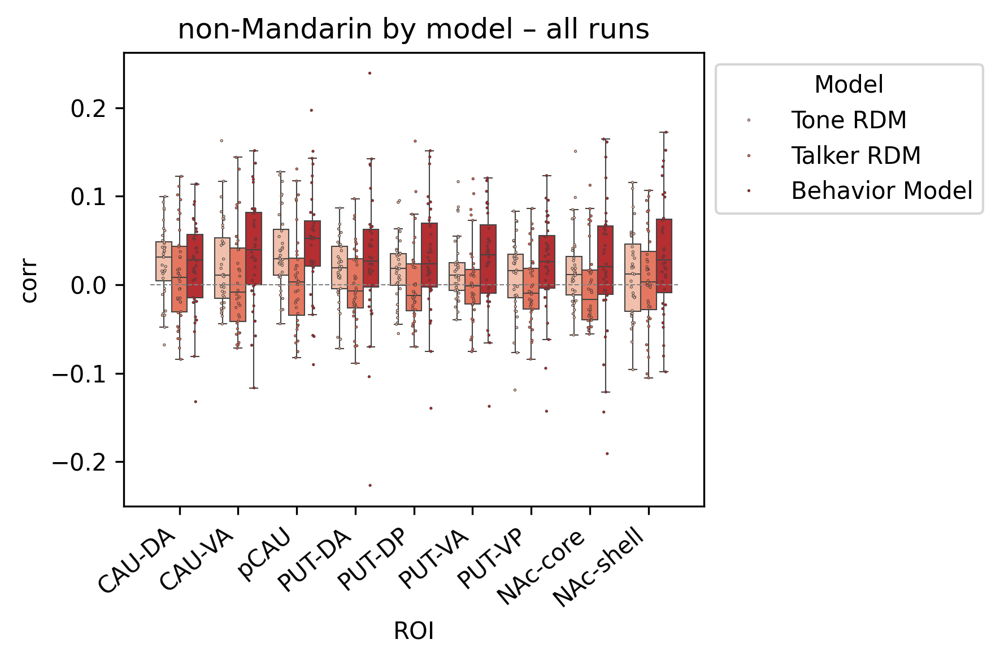

In [127]:
# combine hemispheres

fig, ax = plt.subplots(1,1, figsize=(6,4), dpi=300, sharey=True) # sharex=True, 
#ax = ax.flatten()

group_id = 'non-Mandarin'

#for mx, group_id in enumerate(np.unique(model_long_df.participant_group)):
group_df = laterality_df.where(laterality_df.participant_group==group_id).dropna()

sns.boxplot(data=group_df, 
            x='ROI', y='corr', hue='model', 
            palette='Reds', linewidth=0.5, 
            fliersize = 0,
            ax=ax, 
            #order=roi_list_ordered
           )
sns.stripplot(data=group_df, 
              x='ROI', y='corr', hue='model', 
              palette='Reds', dodge=True, 
              linewidth=0.25, 
              size=1,
              ax=ax, 
              #order=roi_list_ordered,
             )
handles, labels = ax.get_legend_handles_labels()  # Get legend handles and labels

xmin, xmax = ax.get_xlim()
ax.hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha='right');
ax.set_title(f'{group_id} by model – all runs');
ax.legend([],[], frameon=False)

# Add legend with only strip plot handles and labels 
# (since the two overlapping plots have redundant legends)
ax.legend(handles[3:], labels[3:], 
              title='Model',
              loc='upper left', bbox_to_anchor=(1, 1))

#sns.move_legend(ax[mx], "upper left", bbox_to_anchor=(1, 1))
#plt.setp(ax[mx].get_xticklabels(), visible=False)
fig.tight_layout()


#### 3D plots

In [177]:
masks_dir = os.path.join('/bgfs/bchandrasekaran/krs228/data/', 
                         'FLT/', 'data_bids', 'derivatives', 'nilearn', 'masks')

mask_path_list = []
for rx, region in enumerate(np.unique(rc_df.ROI)):
    print(region)
    
    #sub_id = subjects_label[fx]
    mask_fpath = sorted(glob(masks_dir + f'/*/space-MNI152NLin2009cAsym/masks-*/*{region}*.nii.gz'))[0]
    mask_path_list.append(mask_fpath)

CAU-DA
CAU-VA
NAc-core
NAc-shell
PUT-DA
PUT-DP
PUT-VA
PUT-VP
pCAU


In [178]:
[print(x) for x in mask_path_list]

/bgfs/bchandrasekaran/krs228/data/FLT/data_bids/derivatives/nilearn/masks/sub-FLT02/space-MNI152NLin2009cAsym/masks-tian-S3/sub-FLT02_space-MNI152NLin2009cAsym_mask-CAU-DA-lh.nii.gz
/bgfs/bchandrasekaran/krs228/data/FLT/data_bids/derivatives/nilearn/masks/sub-FLT02/space-MNI152NLin2009cAsym/masks-tian-S3/sub-FLT02_space-MNI152NLin2009cAsym_mask-CAU-VA-lh.nii.gz
/bgfs/bchandrasekaran/krs228/data/FLT/data_bids/derivatives/nilearn/masks/sub-FLT02/space-MNI152NLin2009cAsym/masks-tian-S3/sub-FLT02_space-MNI152NLin2009cAsym_mask-NAc-core-lh.nii.gz
/bgfs/bchandrasekaran/krs228/data/FLT/data_bids/derivatives/nilearn/masks/sub-FLT02/space-MNI152NLin2009cAsym/masks-tian-S3/sub-FLT02_space-MNI152NLin2009cAsym_mask-NAc-shell-lh.nii.gz
/bgfs/bchandrasekaran/krs228/data/FLT/data_bids/derivatives/nilearn/masks/sub-FLT02/space-MNI152NLin2009cAsym/masks-tian-S3/sub-FLT02_space-MNI152NLin2009cAsym_mask-PUT-DA-lh.nii.gz
/bgfs/bchandrasekaran/krs228/data/FLT/data_bids/derivatives/nilearn/masks/sub-FLT02/s

[None, None, None, None, None, None, None, None, None]

In [207]:
laterality_df

,index,ROI,stage,participant_group,model,corr,hemisphere
0,0,CAU-DA,early,Mandarin,Tone RDM,0.035841,lh
1,1,CAU-DA,early,Mandarin,Tone RDM,0.067888,rh
2,2,CAU-VA,early,Mandarin,Tone RDM,-0.052462,lh
3,3,CAU-VA,early,Mandarin,Tone RDM,-0.012262,rh
4,4,pCAU,early,Mandarin,Tone RDM,0.121956,lh
...,...,...,...,...,...,...,...
3235,157,PUT-VP,final,non-Mandarin,Behavior Model,-0.094297,rh
3236,158,NAc-core,final,non-Mandarin,Behavior Model,-0.190773,lh
3237,159,NAc-core,final,non-Mandarin,Behavior Model,-0.143751,rh
3238,160,NAc-shell,final,non-Mandarin,Behavior Model,-0.048034,lh


In [225]:
model_id = model_names[2]
print(model_id)
data_dict = {}
for roi in np.unique(laterality_df.ROI): # roi_list_ordered: # np.unique(group_rdms.rdm_descriptors['ROI']):
        #print(roi)
        groi_data = laterality_df.where(laterality_df.participant_group==group_id).where(laterality_df.model==model_id).where(laterality_df.ROI==roi).dropna()['corr'].to_numpy()
        mean_roi = groi_data.mean()
        data_dict[roi] = mean_roi

Behavior Model


In [226]:
data_dict

{'CAU-DA': 0.022001609301259693,
 'CAU-VA': 0.0383049109036637,
 'NAc-core': 0.021171674488596557,
 'NAc-shell': 0.03483869332050415,
 'PUT-DA': 0.029587784845269107,
 'PUT-DP': 0.03073183271897997,
 'PUT-VA': 0.028644086134024985,
 'PUT-VP': 0.023398308046764574,
 'pCAU': 0.04593455395567057}

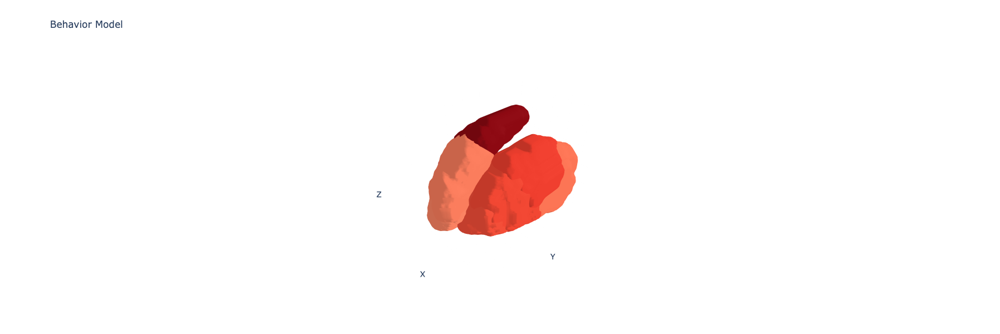

In [227]:

import numpy as np
import nibabel as nib
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from matplotlib import cm
from skimage import measure
from scipy.ndimage import gaussian_filter

# Load NIfTI files into a list
nifti_files = mask_path_list

# Define a colormap
colormap = cm.get_cmap('Reds')

# Define the list of values for color plotting
color_values = list(data_dict.values()) # t_stats  # Adjust these values as needed

# Create a list to hold the data for each segmentation
segmentations = []

# Loop through each NIfTI file and extract segmentation data
for nifti_file in nifti_files:
    nifti_data = nib.load(nifti_file)
    segmentation = nifti_data.get_fdata()
    segmentations.append(segmentation)

# Combine all segmentations into a single binary mask
combined_segmentation = np.any(segmentations, axis=0)

# Upsample the voxel data to a higher resolution grid
upsampled_segmentation = np.repeat(np.repeat(np.repeat(combined_segmentation, 2, axis=0), 2, axis=1), 2, axis=2)

# Smooth the upsampled voxel data with a Gaussian filter
smoothed_segmentation = gaussian_filter(upsampled_segmentation, sigma=1)

# Extract the surface mesh of the smoothed segmented region with adjusted level
vertices, faces, _, _ = measure.marching_cubes(smoothed_segmentation, level=smoothed_segmentation.mean())

# Translate vertices closer to the origin
center = vertices.mean(axis=0)
vertices -= center

# Create a subplot for the 3D plot with a larger size
fig = make_subplots(rows=1, cols=1, specs=[[{'type': 'mesh3d'}]], print_grid=False)

# Loop through each segmentation and add its surface plot to the subplot
for i, segmentation in enumerate(segmentations):
    # Upsample the voxel data to a higher resolution grid
    upsampled_segmentation = np.repeat(np.repeat(np.repeat(segmentation, 2, axis=0), 2, axis=1), 2, axis=2)
    
    # Smooth the upsampled voxel data with a Gaussian filter
    smoothed_segmentation = gaussian_filter(upsampled_segmentation, sigma=1)
    
    # Extract the surface mesh of the smoothed segmented region with adjusted level
    vertices, faces, _, _ = measure.marching_cubes(smoothed_segmentation, level=smoothed_segmentation.mean())
    
    vertices -= center
    
    # Map the color value to the colormap
    #colormap_value = (color_values[i] - min(color_values)) / (max(color_values) - min(color_values))
    colormap_value = (color_values[i] - 0) / (0.05 - 0)
    color = colormap(colormap_value)
    
    # Add the surface plot to the subplot
    fig.add_trace(go.Mesh3d(
        x=vertices[:, 0],
        y=vertices[:, 1],
        z=vertices[:, 2],
        i=faces[:, 0],
        j=faces[:, 1],
        k=faces[:, 2],
        color=f'rgb({int(color[0]*255)}, {int(color[1]*255)}, {int(color[2]*255)})',
        opacity=1,
        name= f'{np.unique(model_df.ROI)[i]} t = {color_values[i]}' # f'Segmentation {i+1}'
    ))

# Set starting camera angle
camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=-1.25, y=1.25, z=1.25)
)

# Update layout for the 3D plot to set a larger size and transparent background
fig.update_layout(
    scene=dict(
        xaxis=dict(title='X', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        yaxis=dict(title='Y', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        zaxis=dict(title='Z', showbackground=False, linecolor='rgba(0,0,0,0)', showticklabels=False),
        bgcolor='rgba(0,0,0,0)',  # Set background color to transparent
        camera=camera  # Set starting camera angle
    ),
    title=f'{model_id}',
    width=800,  # Set width of the plot
    height=600,  # Set height of the plot
)

# Show the interactive plot
fig.show()

# Save the interactive plot as an SVG file
#fig.write_image(f'out-figure_group-nman_contrast-{contrast_label}_surface.svg')


/scratch/slurm-3194925/ipykernel_28782/31679667.py:28: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha='right');


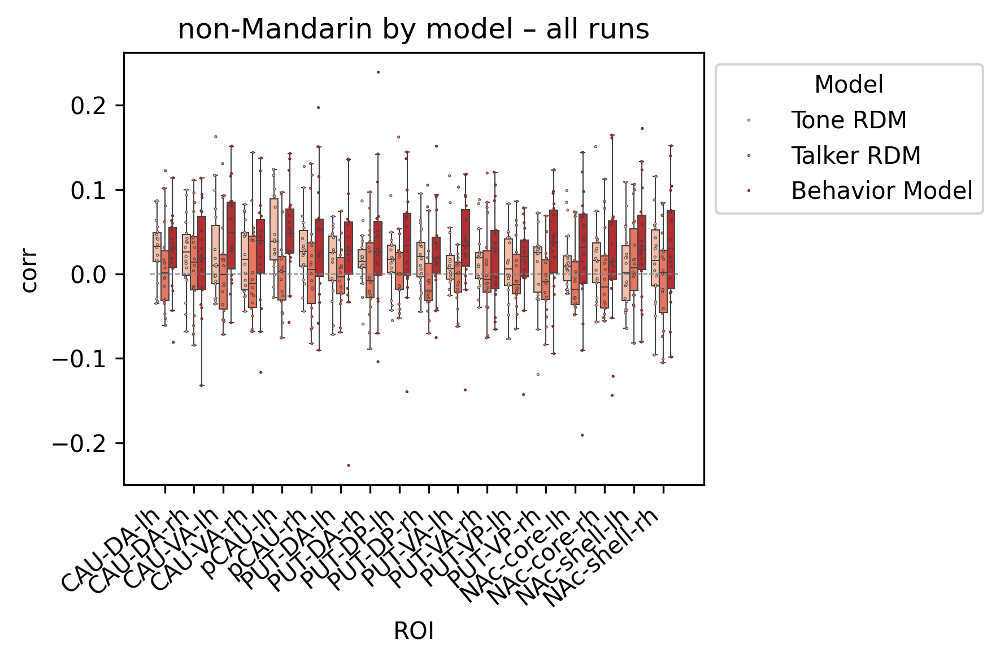

In [116]:
# separate Left and Right, non-Mandarin speakers only

fig, ax = plt.subplots(1,1, figsize=(6,4), dpi=300, sharey=True) # sharex=True, 
#ax = ax.flatten()

group_id = 'non-Mandarin'

#for mx, group_id in enumerate(np.unique(model_long_df.participant_group)):
group_df = model_long_df.where(model_long_df.participant_group==group_id)

sns.boxplot(data=group_df, 
            x='ROI', y='corr', hue='model', 
            palette='Reds', linewidth=0.5, 
            fliersize = 0,
            ax=ax, 
            order=roi_list_ordered)
sns.stripplot(data=group_df, 
              x='ROI', y='corr', hue='model', 
              palette='Reds', dodge=True, 
              linewidth=0.25, 
              size=1,
              ax=ax, 
              order=roi_list_ordered)
handles, labels = ax.get_legend_handles_labels()  # Get legend handles and labels

xmin, xmax = ax.get_xlim()
ax.hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha='right');
ax.set_title(f'{group_id} by model – all runs');
ax.legend([],[], frameon=False)

# Add legend with only strip plot handles and labels 
# (since the two overlapping plots have redundant legends)
ax.legend(handles[3:], labels[3:], 
              title='Model',
              loc='upper left', bbox_to_anchor=(1, 1))

#sns.move_legend(ax[mx], "upper left", bbox_to_anchor=(1, 1))
#plt.setp(ax[mx].get_xticklabels(), visible=False)
fig.tight_layout()


/scratch/slurm-3194925/ipykernel_28782/2530853534.py:24: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=40, ha='right');
/scratch/slurm-3194925/ipykernel_28782/2530853534.py:24: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=40, ha='right');


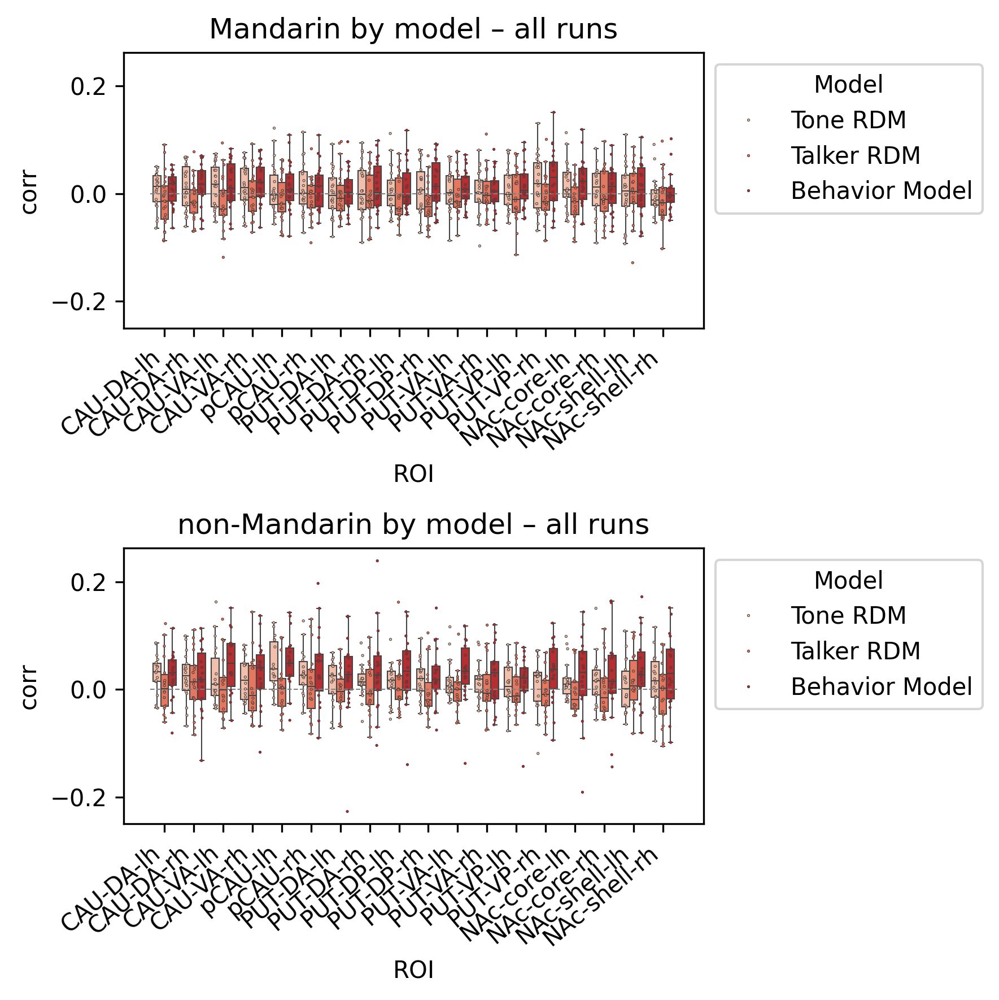

In [117]:
fig, ax = plt.subplots(2,1, figsize=(6,6), dpi=300, sharey=True) # sharex=True, 
#ax = ax.flatten()

for mx, group_id in enumerate(np.unique(model_long_df.participant_group)):
    group_df = model_long_df.where(model_long_df.participant_group==group_id)

    sns.boxplot(data=group_df, 
                x='ROI', y='corr', hue='model', 
                palette='Reds', linewidth=0.5, 
                fliersize = 0,
                ax=ax[mx], 
                order=roi_list_ordered)
    sns.stripplot(data=group_df, 
                  x='ROI', y='corr', hue='model', 
                  palette='Reds', dodge=True, 
                  linewidth=0.25, 
                  size=1,
                  ax=ax[mx], 
                  order=roi_list_ordered)
    handles, labels = ax[mx].get_legend_handles_labels()  # Get legend handles and labels
    
    xmin, xmax = ax[mx].get_xlim()
    ax[mx].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
    ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=40, ha='right');
    ax[mx].set_title(f'{group_id} by model – all runs');
    ax[mx].legend([],[], frameon=False)
    
    # Add legend with only strip plot handles and labels 
    # (since the two overlapping plots have redundant legends)
    ax[mx].legend(handles[3:], labels[3:], 
                  title='Model',
                  loc='upper left', bbox_to_anchor=(1, 1))
    
    #sns.move_legend(ax[mx], "upper left", bbox_to_anchor=(1, 1))
    #plt.setp(ax[mx].get_xticklabels(), visible=False)
fig.tight_layout()


#### by group, by run, by model, by laterality

/scratch/slurm-3194925/ipykernel_28782/120471673.py:27: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=45, ha='right');
/scratch/slurm-3194925/ipykernel_28782/120471673.py:27: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=45, ha='right');
/scratch/slurm-3194925/ipykernel_28782/120471673.py:27: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=45, ha='right');


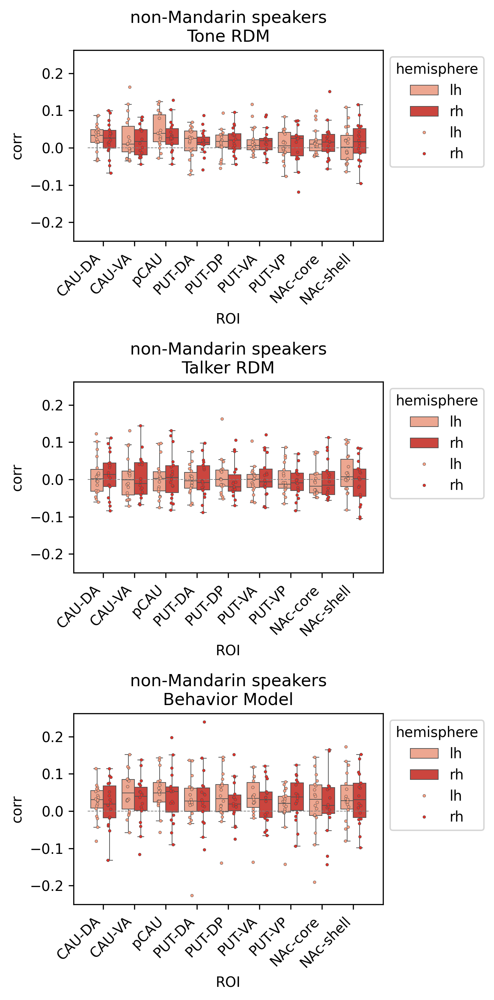

In [118]:
fig, ax = plt.subplots(3,1, figsize=(5,10), dpi=300, sharex=False, sharey=True)
#ax = ax.flatten()


for mx, model_id in enumerate(model_names):
    group_df = laterality_df.where(laterality_df.participant_group==group_id).where(laterality_df.model==model_id)

    sns.boxplot(data=group_df, 
                x='ROI', y='corr', hue='hemisphere', 
                palette='Reds', linewidth=0.5, 
                ax=ax[mx], 
                fliersize = 0,
                #boxprops=dict(alpha=.3),
                #order=roi_list_ordered
                )
    sns.stripplot(data=group_df, 
                  x='ROI', y='corr', hue='hemisphere', 
                  palette='Reds', dodge=True, 
                  linewidth=0.25, 
                  size=2,
                  ax=ax[mx], 
                  #order=roi_list_ordered,
                 )
    xmin, xmax = ax[mx].get_xlim()
    ax[mx].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
    sns.move_legend(ax[mx], "upper left", bbox_to_anchor=(1, 1))
    ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=45, ha='right');
    ax[mx].set_title(f'{group_id} speakers\n{model_id}');
    #ax[mx].legend([],[], frameon=False)
    #plt.setp(ax[mx].get_xticklabels(), visible=False)
fig.tight_layout()


#### By group, by subdivision

/scratch/slurm-3194925/ipykernel_28782/2269430691.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=group_df,
/scratch/slurm-3194925/ipykernel_28782/2269430691.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.stripplot(data=group_df,
/scratch/slurm-3194925/ipykernel_28782/2269430691.py:27: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=45, ha='right');
/scratch/slurm-3194925/ipykernel_28782/2269430691.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot

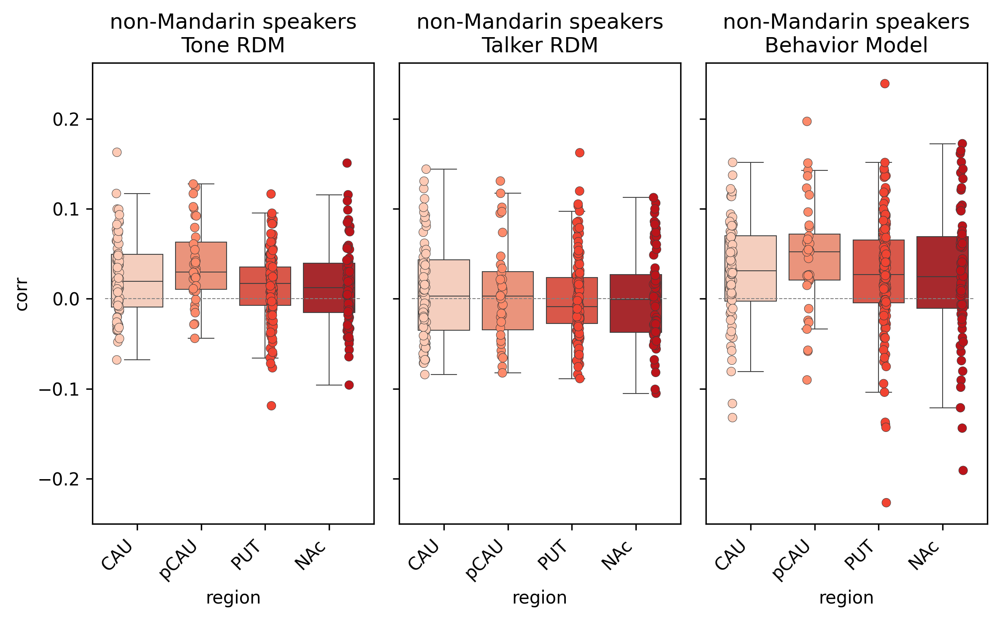

In [119]:
fig, ax = plt.subplots(1,3, figsize=(8,5), dpi=300, sharex=False, sharey=True)
#ax = ax.flatten()


for mx, model_id in enumerate(model_names):
    group_df = striatal_df.where(laterality_df.participant_group==group_id).where(laterality_df.model==model_id)

    sns.boxplot(data=group_df, 
                x='region', y='corr', # hue='subdivision', 
                palette='Reds', linewidth=0.5, 
                ax=ax[mx], 
                fliersize = 0,
                #boxprops=dict(alpha=.3),
                #order=roi_list_ordered
                )
    sns.stripplot(data=group_df, 
                  x='region', y='corr', # hue='subdivision', 
                  palette='Reds', dodge=True, 
                  linewidth=0.25, 
                  size=5,
                  ax=ax[mx], 
                  #order=roi_list_ordered,
                 )
    xmin, xmax = ax[mx].get_xlim()
    ax[mx].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
    #sns.move_legend(ax[mx], "upper left", bbox_to_anchor=(1, 1))
    ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=45, ha='right');
    ax[mx].set_title(f'{group_id} speakers\n{model_id}');
    #ax[mx].legend([],[], frameon=False)
    #plt.setp(ax[mx].get_xticklabels(), visible=False)
fig.tight_layout()


/scratch/slurm-3214511/ipykernel_31200/1243284915.py:25: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right');


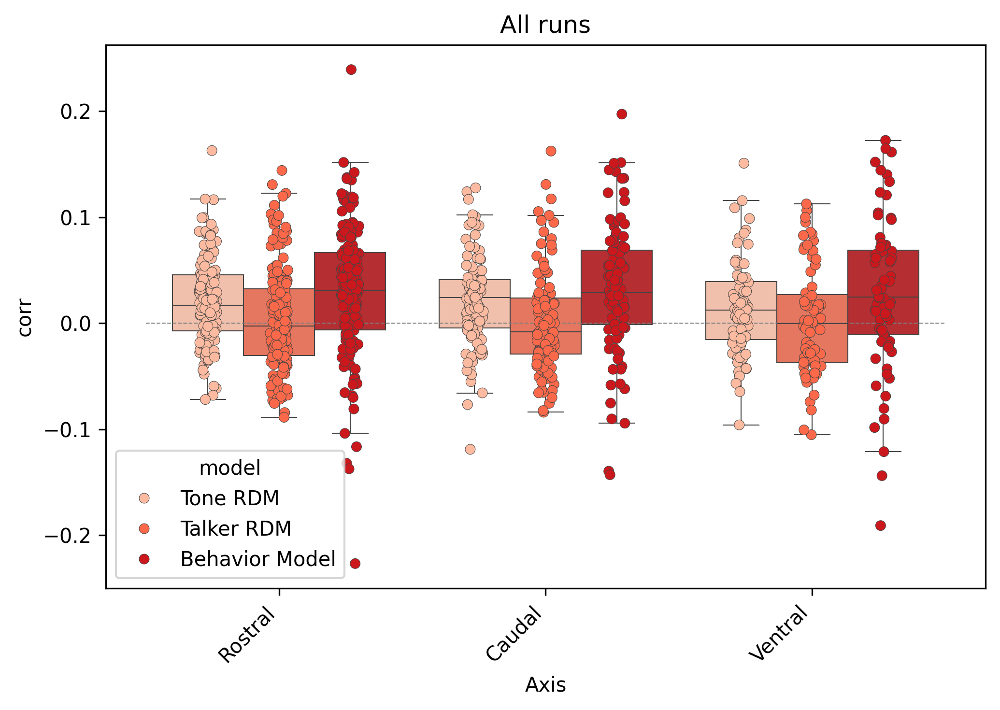

In [140]:
fig, ax = plt.subplots(1,1, figsize=(7,5), dpi=300, sharex=False, sharey=True)

group_df = rostcaud_df.where(rostcaud_df.participant_group==group_id)

sns.boxplot(data=group_df, 
            x='Axis', y='corr', hue='model', 
            palette='Reds', linewidth=0.5, 
            ax=ax, 
            fliersize = 0,
            legend=None,
            #boxprops=dict(alpha=.3),
            #order=roi_list_ordered
            )
sns.stripplot(data=group_df, 
              x='Axis', y='corr', hue='model', 
              palette='Reds', dodge=True, 
              linewidth=0.25, 
              size=5,
              ax=ax, 
              #order=roi_list_ordered,
             )
xmin, xmax = ax.get_xlim()
ax.hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
#sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right');
ax.set_title(f'All runs');
#ax[mx].legend([],[], frameon=False)
#plt.setp(ax[mx].get_xticklabels(), visible=False)
fig.tight_layout()


/scratch/slurm-3194925/ipykernel_28782/3423613417.py:25: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right');


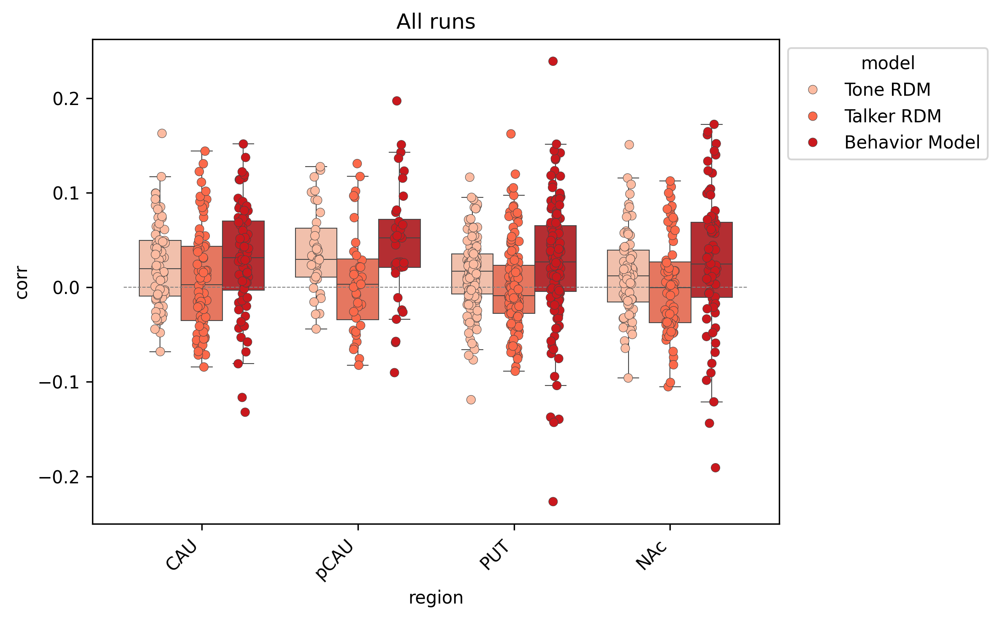

In [163]:
fig, ax = plt.subplots(1,1, figsize=(8,5), dpi=300, sharex=False, sharey=True)

group_df = striatal_df.where(laterality_df.participant_group==group_id)

sns.boxplot(data=group_df, 
            x='region', y='corr', hue='model', 
            palette='Reds', linewidth=0.5, 
            ax=ax, 
            fliersize = 0,
            legend=None,
            #boxprops=dict(alpha=.3),
            #order=roi_list_ordered
            )
sns.stripplot(data=group_df, 
              x='region', y='corr', hue='model', 
              palette='Reds', dodge=True, 
              linewidth=0.25, 
              size=5,
              ax=ax, 
              #order=roi_list_ordered,
             )
xmin, xmax = ax.get_xlim()
ax.hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right');
ax.set_title(f'All runs');
#ax[mx].legend([],[], frameon=False)
#plt.setp(ax[mx].get_xticklabels(), visible=False)
fig.tight_layout()


/scratch/slurm-3194925/ipykernel_28782/49718973.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=group_df,
/scratch/slurm-3194925/ipykernel_28782/49718973.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.stripplot(data=group_df,
/scratch/slurm-3194925/ipykernel_28782/49718973.py:24: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right');


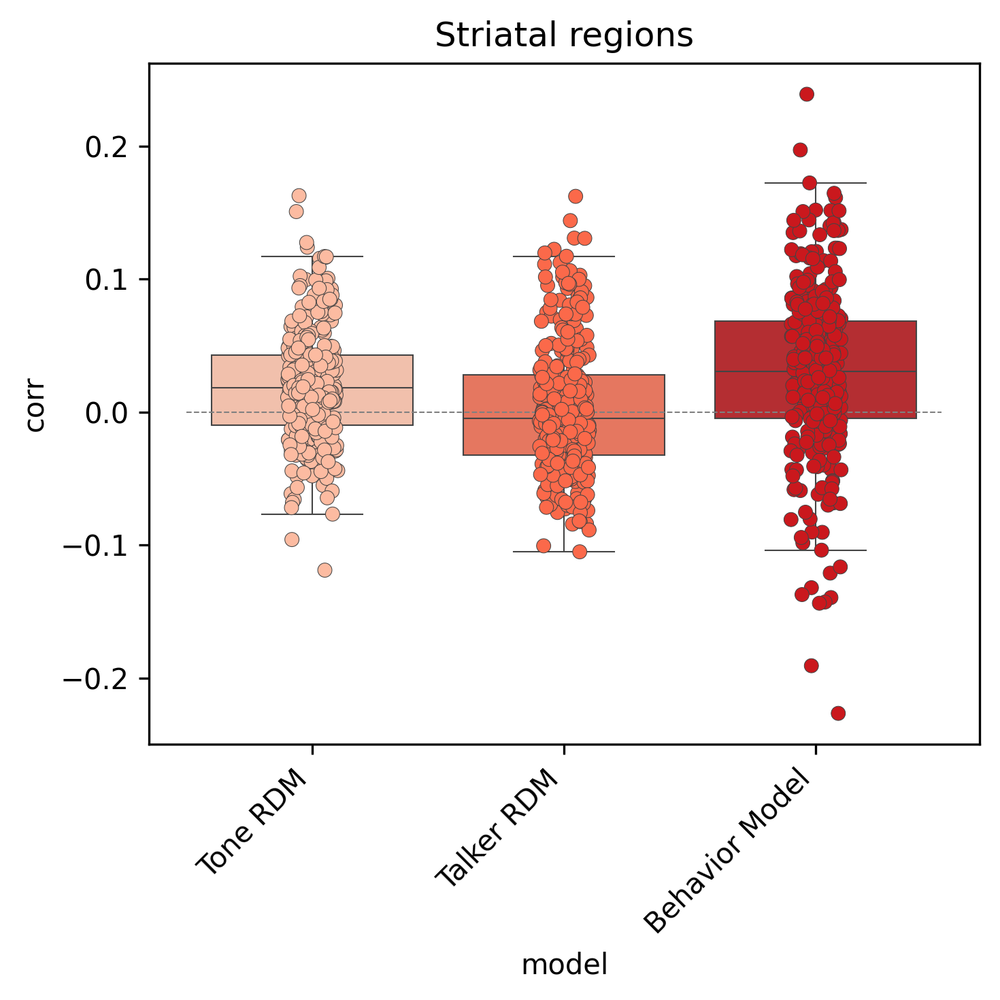

In [130]:
fig, ax = plt.subplots(1,1, figsize=(5,5), dpi=300, sharex=False, sharey=True)

group_df = striatal_df.where(laterality_df.participant_group==group_id)

sns.boxplot(data=group_df, 
            x='model', y='corr', #hue='model', 
            palette='Reds', linewidth=0.5, 
            ax=ax, 
            fliersize = 0,
            #boxprops=dict(alpha=.3),
            #order=roi_list_ordered
            )
sns.stripplot(data=group_df, 
              x='model', y='corr', #hue='model', 
              palette='Reds', #dodge=True, 
              linewidth=0.25, 
              size=5,
              ax=ax, 
              #order=roi_list_ordered,
             )
xmin, xmax = ax.get_xlim()
ax.hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
#sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right');
ax.set_title(f'Striatal regions');
#ax[mx].legend([],[], frameon=False)
#plt.setp(ax[mx].get_xticklabels(), visible=False)
fig.tight_layout()


In [ ]:
'''
fig, ax = plt.subplots(3,1, figsize=(5,10), dpi=300, sharex=False, sharey=True)
#ax = ax.flatten()


for mx, model_id in enumerate(model_names):
    group_df = laterality_df.where(laterality_df.participant_group==group_id).where(laterality_df.model==model_id)

    sns.boxplot(data=group_df, 
                x='ROI', y='corr', hue='hemisphere', 
                palette='Reds', linewidth=0.5, 
                ax=ax[mx], 
                fliersize = 0,
                #boxprops=dict(alpha=.3),
                #order=roi_list_ordered
                )
    sns.stripplot(data=group_df, 
                  x='ROI', y='corr', hue='hemisphere', 
                  palette='Reds', dodge=True, 
                  linewidth=0.25, 
                  size=2,
                  ax=ax[mx], 
                  #order=roi_list_ordered,
                 )
    xmin, xmax = ax[mx].get_xlim()
    ax[mx].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
    sns.move_legend(ax[mx], "upper left", bbox_to_anchor=(1, 1))
    ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=45, ha='right');
    ax[mx].set_title(f'{group_id} speakers\n{model_id}');
    #ax[mx].legend([],[], frameon=False)
    #plt.setp(ax[mx].get_xticklabels(), visible=False)
fig.tight_layout()
'''

#### by group, by run

/scratch/slurm-3194925/ipykernel_28782/4112323462.py:25: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right');


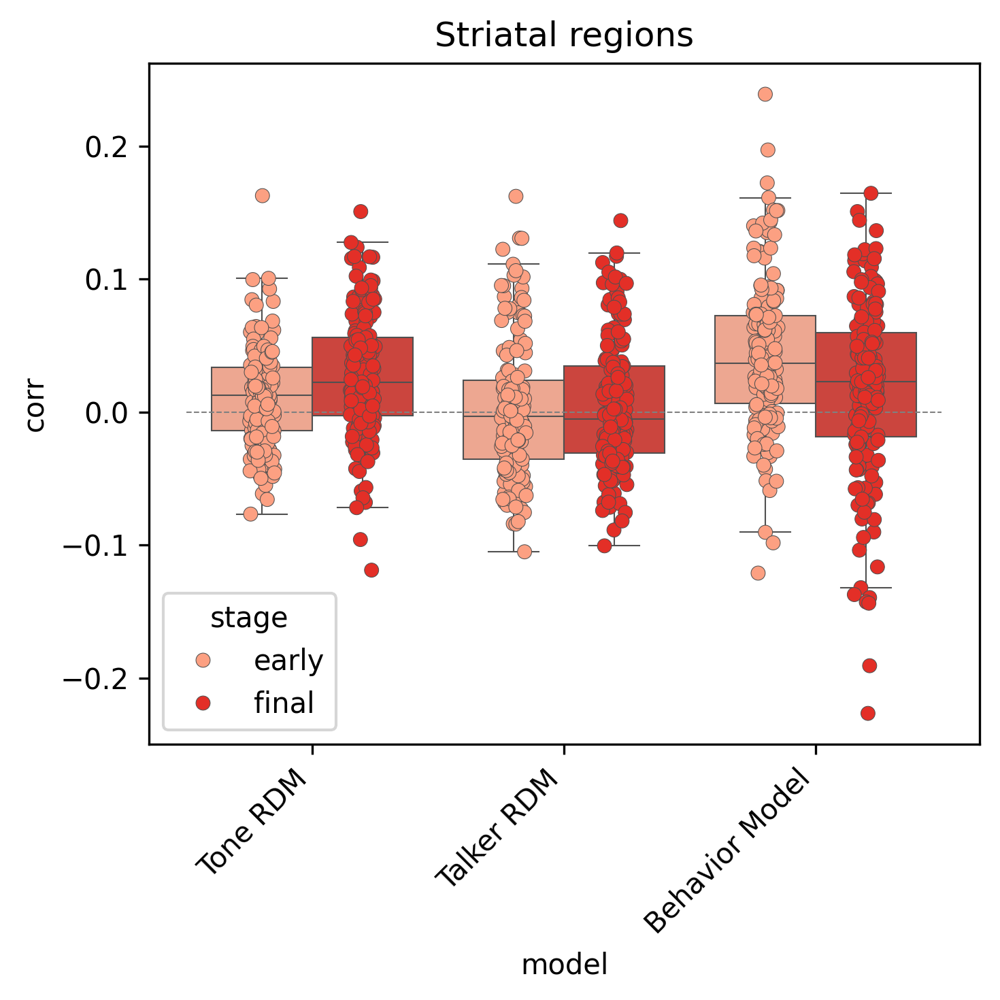

In [128]:
fig, ax = plt.subplots(1,1, figsize=(5,5), dpi=300, sharex=False, sharey=True)

group_df = striatal_df.where(laterality_df.participant_group==group_id)

sns.boxplot(data=group_df, 
            x='model', y='corr', hue='stage', 
            palette='Reds', linewidth=0.5, 
            ax=ax, 
            fliersize = 0,
            legend=None, 
            #boxprops=dict(alpha=.3),
            #order=roi_list_ordered
            )
sns.stripplot(data=group_df, 
              x='model', y='corr', hue='stage', 
              palette='Reds', dodge=True, 
              linewidth=0.25, 
              size=5,
              ax=ax, 
              #order=roi_list_ordered,
             )
xmin, xmax = ax.get_xlim()
ax.hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
#sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right');
ax.set_title(f'Striatal regions');
#ax[mx].legend([],[], frameon=False)
#plt.setp(ax[mx].get_xticklabels(), visible=False)
fig.tight_layout()


/scratch/slurm-3214511/ipykernel_31200/927640096.py:29: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=45, ha='right');
/scratch/slurm-3214511/ipykernel_31200/927640096.py:29: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=45, ha='right');
/scratch/slurm-3214511/ipykernel_31200/927640096.py:29: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=45, ha='right');


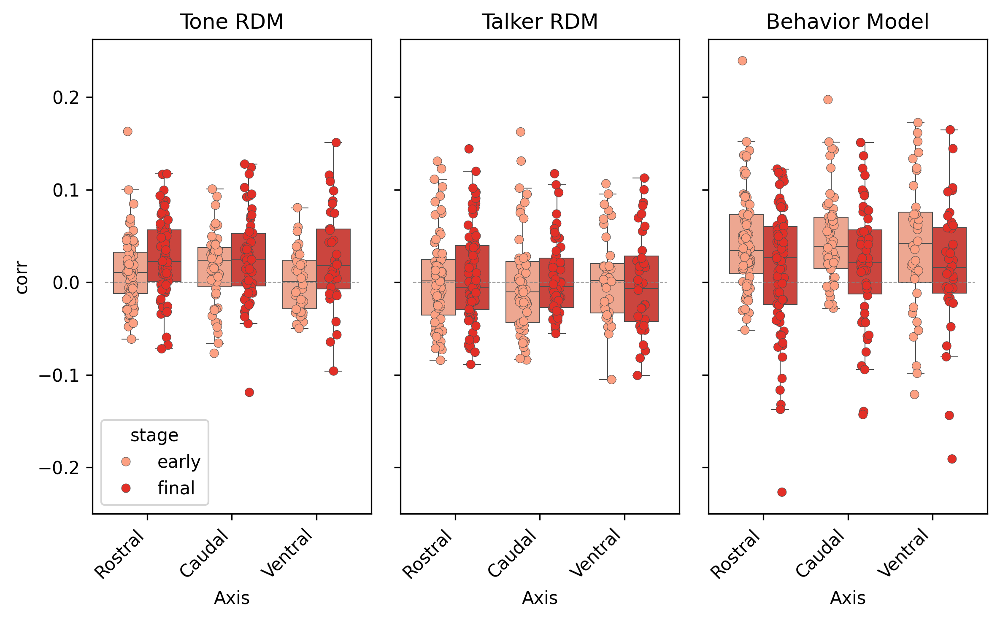

In [145]:
fig, ax = plt.subplots(1,3, figsize=(8,5), dpi=300, sharex=False, sharey=True)
#ax = ax.flatten()


for mx, model_id in enumerate(model_names):
    group_df = rostcaud_df.where(rostcaud_df.participant_group==group_id).where(rostcaud_df.model==model_id)

    sns.boxplot(data=group_df, 
                x='Axis', y='corr', hue='stage', 
                palette='Reds', linewidth=0.5, 
                ax=ax[mx], 
                fliersize = 0,
                legend=None, 
                #boxprops=dict(alpha=.8),
                #order=roi_list_ordered
                )
    sns.stripplot(data=group_df, 
                  x='Axis', y='corr', hue='stage', 
                  palette='Reds', dodge=True, 
                  linewidth=0.25, 
                  size=5,
                  ax=ax[mx], 
                  
                  #order=roi_list_ordered,
                 )
    xmin, xmax = ax[mx].get_xlim()
    ax[mx].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
    #sns.move_legend(ax[mx], "upper left", bbox_to_anchor=(1, 1))
    ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=45, ha='right');
    ax[mx].set_title(f'{model_id}');
    if mx == 0:
        sns.move_legend(ax[mx], "lower left")
        #handles, labels = ax[mx].get_legend_handles_labels()
        #l = plt.legend(handles[0:2], labels[0:2], bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    if mx > 0:
        ax[mx].legend([],[], frameon=False)
    #plt.setp(ax[mx].get_xticklabels(), visible=False)
fig.tight_layout()


In [ ]:
'''
fig, ax = plt.subplots(3,1, figsize=(4,10), dpi=300, sharex=False, sharey=True)
#ax = ax.flatten()


for mx, model_id in enumerate(model_names):
    group_df = model_long_df.where(model_long_df.participant_group==group_id).where(model_long_df.model==model_id)

    sns.boxplot(data=group_df, 
                x='ROI', y='corr', hue='stage', 
                palette='Reds', linewidth=0.5, 
                ax=ax[mx], 
                fliersize = 0,
                order=roi_list_ordered)
    sns.stripplot(data=group_df, 
                  x='ROI', y='corr', hue='stage', 
                  palette='Reds', dodge=True, 
                  linewidth=0.25, 
                  size=1,
                  ax=ax[mx], 
                  order=roi_list_ordered)
    xmin, xmax = ax[mx].get_xlim()
    ax[mx].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
    sns.move_legend(ax[mx], "upper left", bbox_to_anchor=(1, 1))
    ax[mx].set_xticklabels(ax[mx].get_xticklabels(), rotation=45, ha='right');
    ax[mx].set_title(f'{group_id} speakers\n{model_id}');
    ax[mx].legend([],[], frameon=False)
    #plt.setp(ax[mx].get_xticklabels(), visible=False)
fig.tight_layout()
'''

In [ ]:
'''
fig, ax = plt.subplots(3,2, figsize=(8,10), dpi=300, sharex=True, sharey=True)
#ax = ax.flatten()

#for model_id in model_names:
for gx, group_id in enumerate(np.unique(group_rdms.rdm_descriptors['group'])):
    for mx, model_id in enumerate(model_names):
        group_df = model_long_df.where(model_long_df.participant_group==group_id).where(model_long_df.model==model_id)

        sns.boxplot(data=group_df, 
                    x='ROI', y='corr', hue='stage', 
                    palette='Reds', linewidth=0.5, 
                    ax=ax[mx,gx], 
                    order=roi_list_ordered)
        sns.stripplot(data=group_df, 
                      x='ROI', y='corr', hue='stage', 
                      palette='Reds', dodge=True, 
                      linewidth=0.25, 
                      size=1,
                      ax=ax[mx,gx], 
                      order=roi_list_ordered)
        xmin, xmax = ax[mx,gx].get_xlim()
        ax[mx,gx].hlines(y=0, xmin=xmin, xmax=xmax, color='0.5', linestyle='--', linewidth=0.5)
        sns.move_legend(ax[mx,gx], "upper left", bbox_to_anchor=(1, 1))
        ax[mx,gx].set_xticklabels(ax[mx,gx].get_xticklabels(), rotation=45, ha='right');
        ax[mx,gx].set_title(f'{group_id} speakers\n{model_id}');
        ax[mx,gx].legend([],[], frameon=False)
        #plt.setp(ax[mx].get_xticklabels(), visible=False)
    fig.tight_layout()

'''

### ANOVA statistics

In [64]:
from scipy.stats import f_oneway
import statsmodels.api as sm
from statsmodels.formula.api import ols

In [65]:
model_long_df

,index,ROI,stage,participant_group,model,corr
0,0,CAU-DA-lh,early,Mandarin,Tone RDM,0.035841
1,1,CAU-DA-rh,early,Mandarin,Tone RDM,0.067888
2,2,CAU-VA-lh,early,Mandarin,Tone RDM,-0.052462
3,3,CAU-VA-rh,early,Mandarin,Tone RDM,-0.012262
4,4,pCAU-lh,early,Mandarin,Tone RDM,0.121956
...,...,...,...,...,...,...
3235,157,PUT-VP-rh,final,non-Mandarin,Behavior Model,-0.094297
3236,158,NAc-core-lh,final,non-Mandarin,Behavior Model,-0.190773
3237,159,NAc-core-rh,final,non-Mandarin,Behavior Model,-0.143751
3238,160,NAc-shell-lh,final,non-Mandarin,Behavior Model,-0.048034


In [66]:
formula = 'corr ~ model'
model = ols(formula, data=model_long_df).fit()
aov_table = sm.stats.anova_lm(model, typ=2)
aov_table

,sum_sq,df,F,PR(>F)
model,0.207967,2.0,45.793622,3.332147e-20
Residual,4.897898,2157.0,NaN,NaN


In [67]:
striatal_df

,index,ROI,stage,participant_group,model,corr,hemisphere,region,subdivision
0,0,CAU-DA,early,Mandarin,Tone RDM,0.035841,lh,CAU,DA
1,1,CAU-DA,early,Mandarin,Tone RDM,0.067888,rh,CAU,DA
2,2,CAU-VA,early,Mandarin,Tone RDM,-0.052462,lh,CAU,VA
3,3,CAU-VA,early,Mandarin,Tone RDM,-0.012262,rh,CAU,VA
4,4,pCAU,early,Mandarin,Tone RDM,0.121956,lh,pCAU,post
...,...,...,...,...,...,...,...,...,...
3235,157,PUT-VP,final,non-Mandarin,Behavior Model,-0.094297,rh,PUT,VP
3236,158,NAc-core,final,non-Mandarin,Behavior Model,-0.190773,lh,NAc,core
3237,159,NAc-core,final,non-Mandarin,Behavior Model,-0.143751,rh,NAc,core
3238,160,NAc-shell,final,non-Mandarin,Behavior Model,-0.048034,lh,NAc,shell


In [68]:
formula = 'corr ~ model'
model = ols(formula, data=striatal_df).fit()
aov_table = sm.stats.anova_lm(model, typ=2)
aov_table

,sum_sq,df,F,PR(>F)
model,0.207967,2.0,45.793622,3.332147e-20
Residual,4.897898,2157.0,NaN,NaN


In [96]:
formula = 'corr ~ stage'
group_id = 'non-Mandarin'
    
print(f'{group_id}-speaking participants')
for model_id in model_names:
    print(f'\n{model_id}')
    
    nman_df = model_long_df.where(model_long_df.participant_group==group_id).where(model_long_df.model==model_id) # .where(model_long_df.ROI.isin(roi_list_ordered))
    
    model = ols(formula, data=nman_df).fit()
    aov_table = sm.stats.anova_lm(model, typ=2)
    print(aov_table)


non-Mandarin-speaking participants

Tone RDM
            sum_sq     df         F    PR(>F)
stage     0.011285    1.0  6.718671  0.010102
Residual  0.419930  250.0       NaN       NaN

Talker RDM
            sum_sq     df         F    PR(>F)
stage     0.002090    1.0  0.861268  0.354279
Residual  0.606736  250.0       NaN       NaN

Behavior Model
            sum_sq     df          F    PR(>F)
stage     0.048517    1.0  13.761249  0.000256
Residual  0.881413  250.0        NaN       NaN


In [90]:
model = ols(formula, data=nman_df).fit()
aov_table = sm.stats.anova_lm(model, typ=2)
aov_table

,sum_sq,df,F,PR(>F)
stage,0.048517,1.0,13.761249,0.000256
Residual,0.881413,250.0,NaN,NaN


# ARCHIVE

### [DO NOT RUN - FILES CURRENTLY MISSING/REANALYZED] Stimulus RDMs

In [8]:
stim_rdm_dir = os.path.abspath('/bgfs/bchandrasekaran/ngg12/16tone/analysis_scripts/RDMs_kevin')

In [ ]:
glob(stim_rdm_dir+'/STIM*')

In [ ]:
stim_rdm_files = sorted(glob(stim_rdm_dir+'/STIM*PCA*'))
n_rdms = len(stim_rdm_files)
stim_rdms_name_list = []
stim_rdms_array = np.zeros((n_rdms, 16, 16))
for i, fpath in enumerate(stim_rdm_files):
    rdm_name = os.path.basename(fpath)[5:-4]
    print(rdm_name)
    stim_rdm_data = np.genfromtxt(fpath, delimiter=',', skip_header=1)
    try:
        stim_rdms_array[i] = stim_rdm_data
        stim_rdms_name_list.append(rdm_name)
    except ValueError:
        # some of the DSMs are 4x4 instead of 16x16
        # so skip them
        continue

In [11]:
stim_rdms_array.shape

(6, 16, 16)

In [12]:
stim_rdms = RDMs(stim_rdms_array,
                  rdm_descriptors={'stimulus_model':stim_rdms_name_list,},
                  pattern_descriptors=pattern_descriptors,
                  dissimilarity_measure='Euclidean'
                  )

In [ ]:
fig, axs = plt.subplots(2, 3, figsize=(8,5), dpi=200)
for dx, descrip in enumerate(stim_rdms.rdm_descriptors['stimulus_model']):
    spec_rdms = stim_rdms.subset('stimulus_model', descrip)
    show_rdm_panel(spec_rdms, ax=axs.flat[dx], rdm_descriptor='stimulus_model', cmap='inferno',)


#### Convert to models

In [14]:
stim_models = []
for dx, descrip in enumerate(stim_rdms.rdm_descriptors['stimulus_model']):
    spec_model = ModelFixed( '{} RDM'.format(descrip), stim_rdms.subset('stimulus_model', descrip))
    stim_models.append(spec_model)

### [DO NOT RUN - FILES CURRENTLY MISSING/REANALYZED] FFR RDMs

In [15]:
# start with grand average FFR
print('loading FFR dissimilarity matrix')
ffr_rdm_fpath = os.path.join(stim_rdm_dir, 'FFRdistancesgrandavg.csv')
rdm_name = 'FFR_grandavg'
ffr_rdm_data = np.genfromtxt(fpath, delimiter=',', skip_header=1)
print(len(ffr_rdm_data))

# input array needs to be 3-dimensional, despite docs saying 2-D is ok
# (thus the newaxis)
ffr_rdm = RDMs(ffr_rdm_data[np.newaxis,:,:],
               rdm_descriptors={'FFR model': rdm_name},
               pattern_descriptors=pattern_descriptors,
               dissimilarity_measure='Euclidean')
ffr_model = ModelFixed('FFR model', ffr_rdm)

ffr_models = [ffr_model]
    

loading FFR dissimilarity matrix
16


In [ ]:
show_rdm(ffr_rdm, cmap='inferno',)

## [DO NOT RUN – ARCHIVE] Generate run-specific RDMs (NOW RUN WITH RSA_ROI.PY)

#### Generate group RDMs

In [ ]:
group_rdm_list = []
for sx, sub_id in enumerate(participant_list):
    print(sub_id)
    group_id = group_assignment[sx]

    # set this path to wherever you saved the folder containing the img-files
    model_folder = os.path.join(model_dir, 'masked_statmaps',
                               'sub-{}'.format(sub_id),
                               'statmaps_masked',
                               'stimulus_per_run_LSS')
    for runx, data_folder in enumerate(sorted(glob('{}/run*'.format(model_folder)))):
        #print(data_folder)
        
        #mask_list = np.unique([os.path.basename(x).split('_')[2] for x in all_im_paths])

        all_mask_data = []
        for mx, mask_descrip in enumerate(roi_list):

            #print(mask_descrip)
            image_paths = sorted(glob('{}/mask-{}/*_cond-*_map-{}.csv'.format(data_folder, mask_descrip, statmap)))

            try:
                n_vox = np.genfromtxt(image_paths[0]).shape[0]
            except IndexError:
                n_vox = 1

            data = np.zeros((len(image_paths), n_vox))
            for x, im in enumerate(image_paths):
                data[x] = np.genfromtxt(im)
            all_mask_data.append(data)

            roi_rdms = []
        for rx, mask_data in enumerate(all_mask_data):
            dataset = rsatoolbox.data.Dataset(mask_data, 
                                              descriptors={'participant': sub_id, 
                                                           'run': os.path.basename(data_folder),
                                                           'ROI': roi_list[rx], 
                                                           'group': group_id
                                                          },)
            test_rdm = rsatoolbox.rdm.calc_rdm(dataset)
            roi_rdms.append(test_rdm)
            group_rdm_list.append(test_rdm)

        concat_rdms = rsatoolbox.rdm.rdms.concat(roi_rdms)
group_rdms = rsatoolbox.rdm.rdms.concat(group_rdm_list)

In [ ]:
group_rdm_list

In [ ]:
test_rdm

In [35]:
group_rdms.pattern_descriptors = pattern_descriptors

In [56]:
group_rdms.save('group_run_LSS_rdms.hdf5', file_type='hdf5', overwrite=True)

#### Load pre-saved run-specific RDMs

In [35]:
group_rdms = rsatoolbox.rdm.rdms.load_rdm('group_run_LSS_rdms.hdf5')

## [ARCHIVE] Run-specific RSA

### Create group-mean RDMs

In [25]:
mean_rdms_mand_list = []
mean_rdms_nman_list = []
for runx, run in enumerate(np.unique(group_rdms.rdm_descriptors['run'])):
    for rx, roi in enumerate(roi_list):
        # Mandarin-speaking
        dissim_mand = group_rdms.subset('group', value='Mandarin').subset('run', value=run).subset('ROI', value=roi).dissimilarities

        roi_mand = RDMs(dissim_mand.mean(axis=0),
                        rdm_descriptors={'run': run, 'ROI': roi_list[rx], 'group': 'Mandarin'},
                        pattern_descriptors=pattern_descriptors)
        mean_rdms_mand_list.append(roi_mand)

        # non-Mandarin-speaking
        dissim_nman = group_rdms.subset('group', value='non-Mandarin').subset('run', value=run).subset('ROI', value=roi).dissimilarities
        roi_nman = RDMs(dissim_nman.mean(axis=0),
                        rdm_descriptors={'run': run, 'ROI': roi_list[rx], 'group': 'non-Mandarin'},
                        pattern_descriptors=pattern_descriptors)
        mean_rdms_nman_list.append(roi_nman)

mean_rdms_mand = rsatoolbox.rdm.rdms.concat(mean_rdms_mand_list)
mean_rdms_nman = rsatoolbox.rdm.rdms.concat(mean_rdms_nman_list)



In [26]:
mean_rdms_mand

rsatoolbox.rdm.RDMs(
dissimilarity_measure = 
None
dissimilarities = 
[[1.79559562 1.85987127 1.44008664 ... 2.03217626 2.13648545 1.78558371]
 [2.13960337 1.93413196 1.65211813 ... 2.53605299 2.26584816 2.36121041]
 [2.25672361 2.08204578 1.87461425 ... 2.10008194 2.11558743 2.12260766]
 ...
 [2.32496597 2.24698125 2.33635625 ... 1.973868   2.3184011  2.05239057]
 [2.47460807 2.41258482 2.45276991 ... 2.16965667 2.36265713 2.07016866]
 [2.48002883 2.33859697 2.49014896 ... 2.07384879 2.37162237 1.98952845]]
descriptors = 
{}
rdm_descriptors = 
{'run': ['run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02',

#### plot data RDMs

In [ ]:
n_mand = len(sub_group_dict['Mandarin'])

fig = plt.figure(constrained_layout=True, figsize=(20,10), dpi=300)
fig.suptitle('Mandarin (n = {}) mean RDMs by run and ROI'.format(n_mand))

subfigs = fig.subfigures(nrows=6, ncols=1)


for sf, run in enumerate(np.unique(group_rdms.rdm_descriptors['run'])):
    subfigs[sf].suptitle(run)

    axs = subfigs[sf].subplots(nrows=1, ncols=len(roi_list))
    for rx, roi in enumerate(roi_list):
        rsatoolbox.vis.show_rdm_panel(mean_rdms_mand.subset('run', value=run).subset('ROI', value=roi), 
                                      rdm_descriptor='ROI', 
                                      cmap='inferno', 
                                      ax=axs[rx])

In [ ]:
n_nman = len(sub_group_dict['non-Mandarin'])

fig = plt.figure(constrained_layout=True, figsize=(20,10), dpi=300)
fig.suptitle('Non-Mandarin (n = {}) mean RDMs by run and ROI'.format(n_nman))

subfigs = fig.subfigures(nrows=6, ncols=1)

for sf, run in enumerate(np.unique(group_rdms.rdm_descriptors['run'])):
    subfigs[sf].suptitle(run)

    axs = subfigs[sf].subplots(nrows=1, ncols=len(roi_list))
    for rx, roi in enumerate(roi_list):
        rsatoolbox.vis.show_rdm_panel(mean_rdms_nman.subset('run', value=run).subset('ROI', value=roi), 
                                      rdm_descriptor='ROI', 
                                      cmap='inferno', 
                                      ax=axs[rx])

In [ ]:
for sf, run in enumerate(np.unique(group_rdms.rdm_descriptors['run'])):
    rsatoolbox.vis.scatter_plot.show_MDS(mean_rdms_nman.subset('run', run), 
                                         rdm_descriptor='ROI',
                                         pattern_descriptor='tone');

### Each run independently

In [27]:
len(group_rdms.get_matrices()[0])

16

In [28]:
len(group_rdms.subset('group', value='Mandarin').subset('run', value='run05'))

234

In [29]:
len(all_models)

2

group-non-Mandarin run-run00 ROI-L-HG
group-non-Mandarin run-run05 ROI-L-HG
group-non-Mandarin run-run00 ROI-L-IC
group-non-Mandarin run-run05 ROI-L-IC
group-non-Mandarin run-run00 ROI-L-MGN
group-non-Mandarin run-run05 ROI-L-MGN
group-non-Mandarin run-run00 ROI-L-PP
group-non-Mandarin run-run05 ROI-L-PP
group-non-Mandarin run-run00 ROI-L-PT
group-non-Mandarin run-run05 ROI-L-PT
group-non-Mandarin run-run00 ROI-L-ParsOp
group-non-Mandarin run-run05 ROI-L-ParsOp
group-non-Mandarin run-run00 ROI-L-ParsTri
group-non-Mandarin run-run05 ROI-L-ParsTri
group-non-Mandarin run-run00 ROI-L-STGa
group-non-Mandarin run-run05 ROI-L-STGa
group-non-Mandarin run-run00 ROI-L-STGp
group-non-Mandarin run-run05 ROI-L-STGp
group-non-Mandarin run-run00 ROI-R-HG
group-non-Mandarin run-run05 ROI-R-HG
group-non-Mandarin run-run00 ROI-R-IC


/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/rsatoolbox/vis/model_plot.py:282: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(12.5, 10))


group-non-Mandarin run-run05 ROI-R-IC
group-non-Mandarin run-run00 ROI-R-MGN
group-non-Mandarin run-run05 ROI-R-MGN
group-non-Mandarin run-run00 ROI-R-PP
group-non-Mandarin run-run05 ROI-R-PP
group-non-Mandarin run-run00 ROI-R-PT
group-non-Mandarin run-run05 ROI-R-PT
group-non-Mandarin run-run00 ROI-R-ParsOp
group-non-Mandarin run-run05 ROI-R-ParsOp
group-non-Mandarin run-run00 ROI-R-ParsTri
group-non-Mandarin run-run05 ROI-R-ParsTri
group-non-Mandarin run-run00 ROI-R-STGa
group-non-Mandarin run-run05 ROI-R-STGa
group-non-Mandarin run-run00 ROI-R-STGp
group-non-Mandarin run-run05 ROI-R-STGp


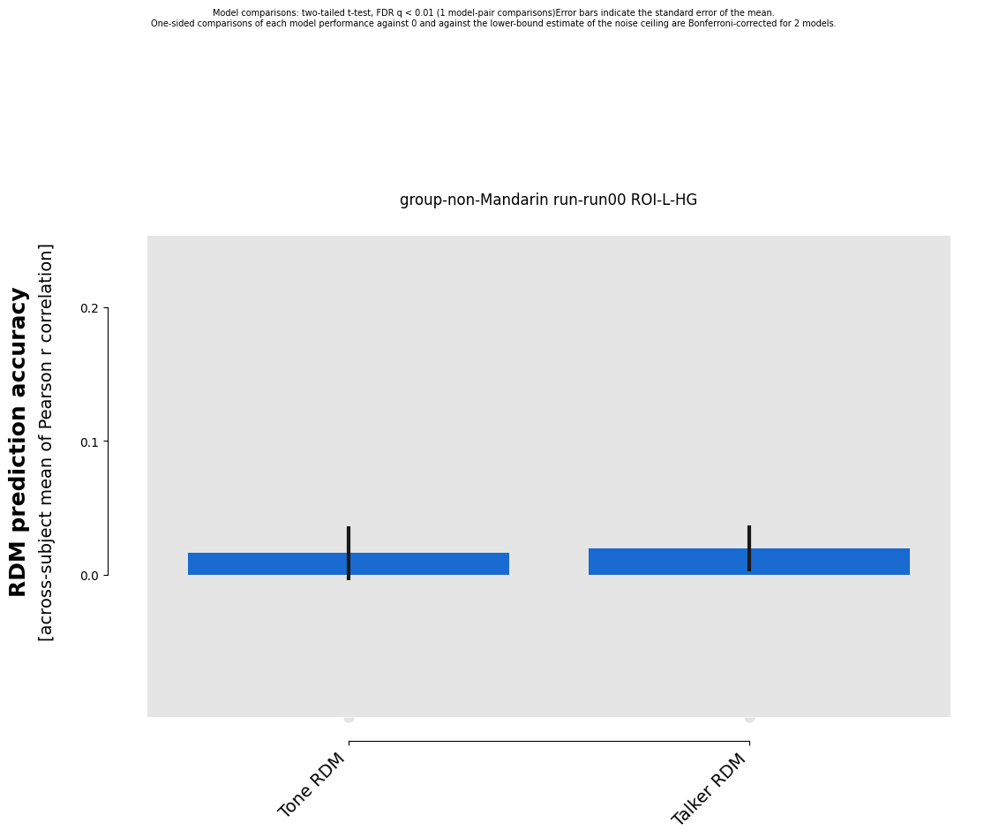

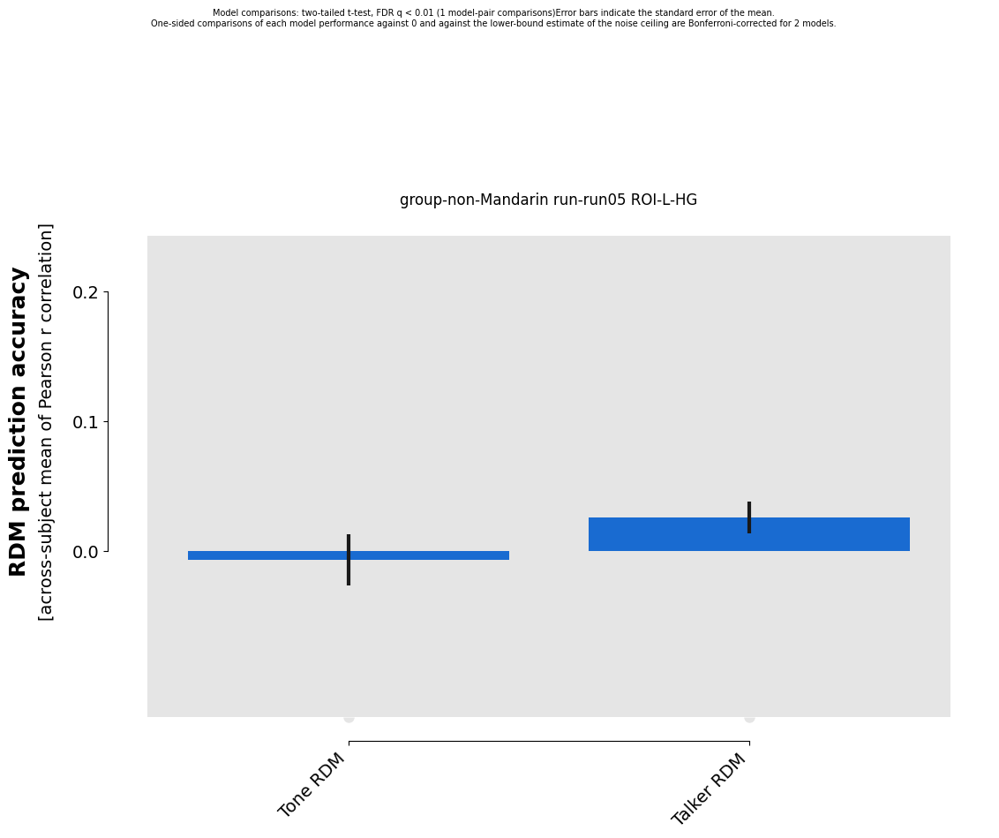

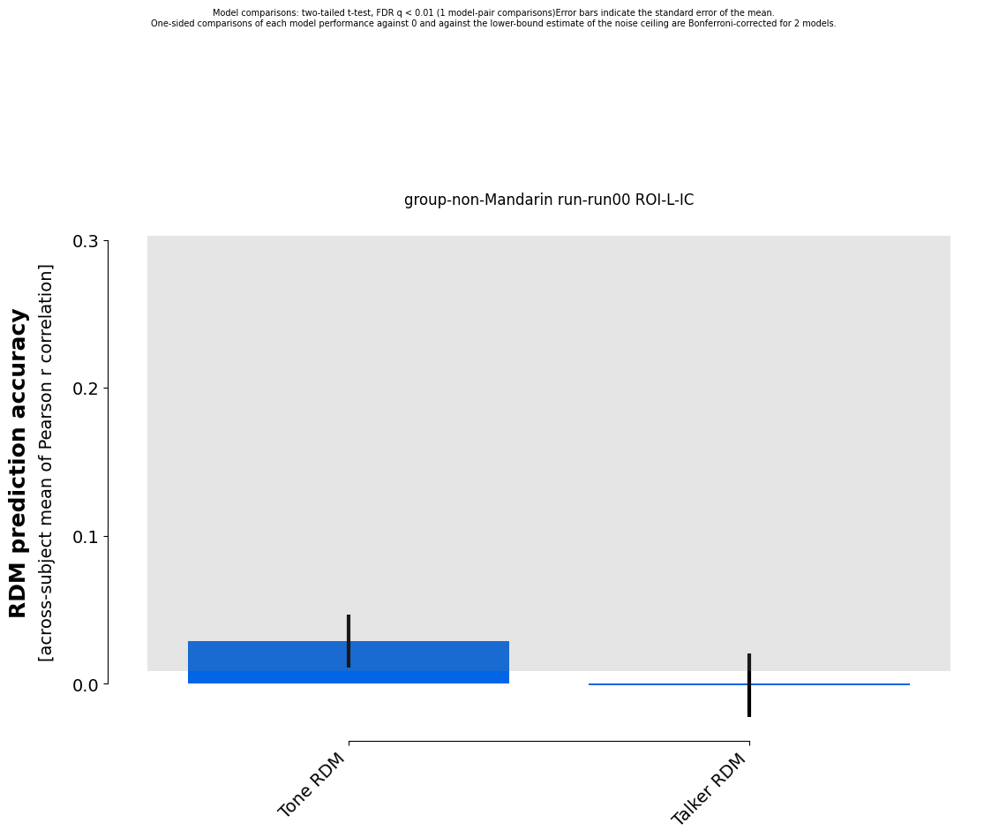

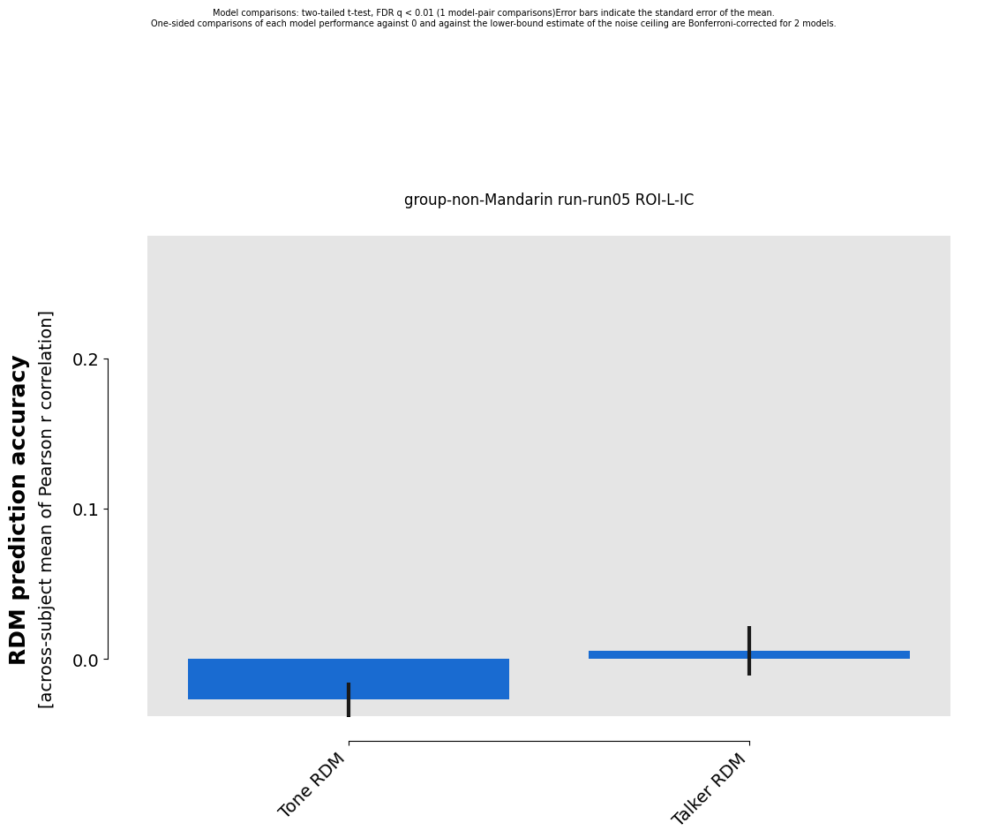

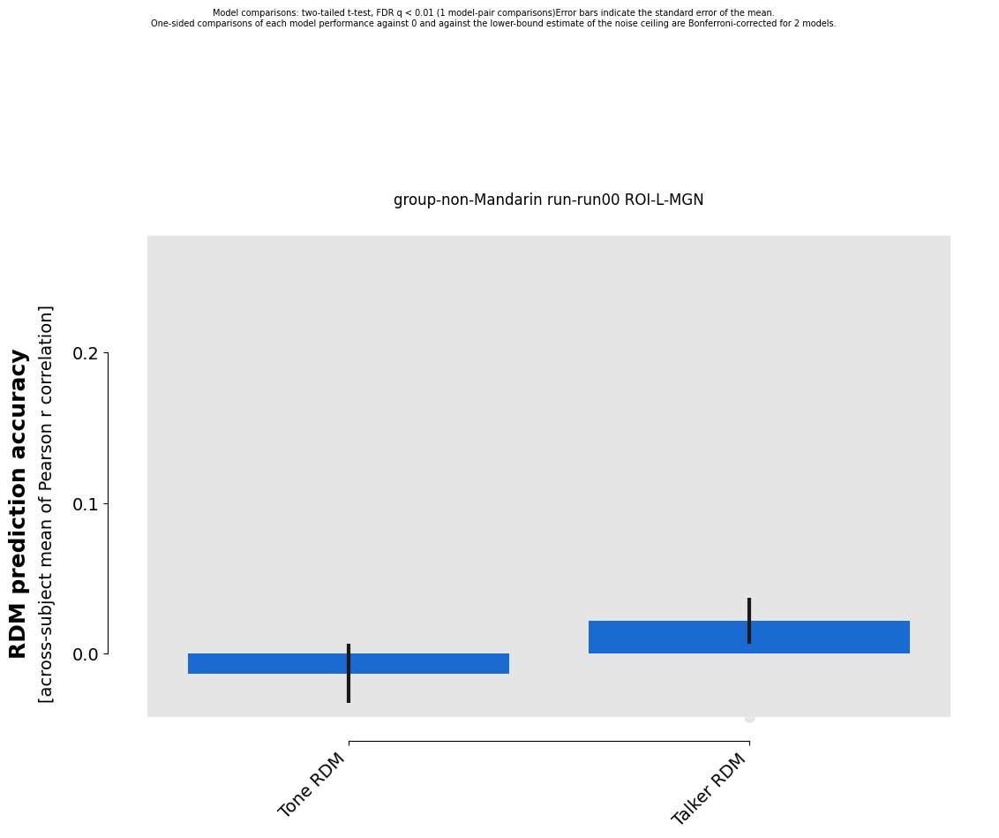

...

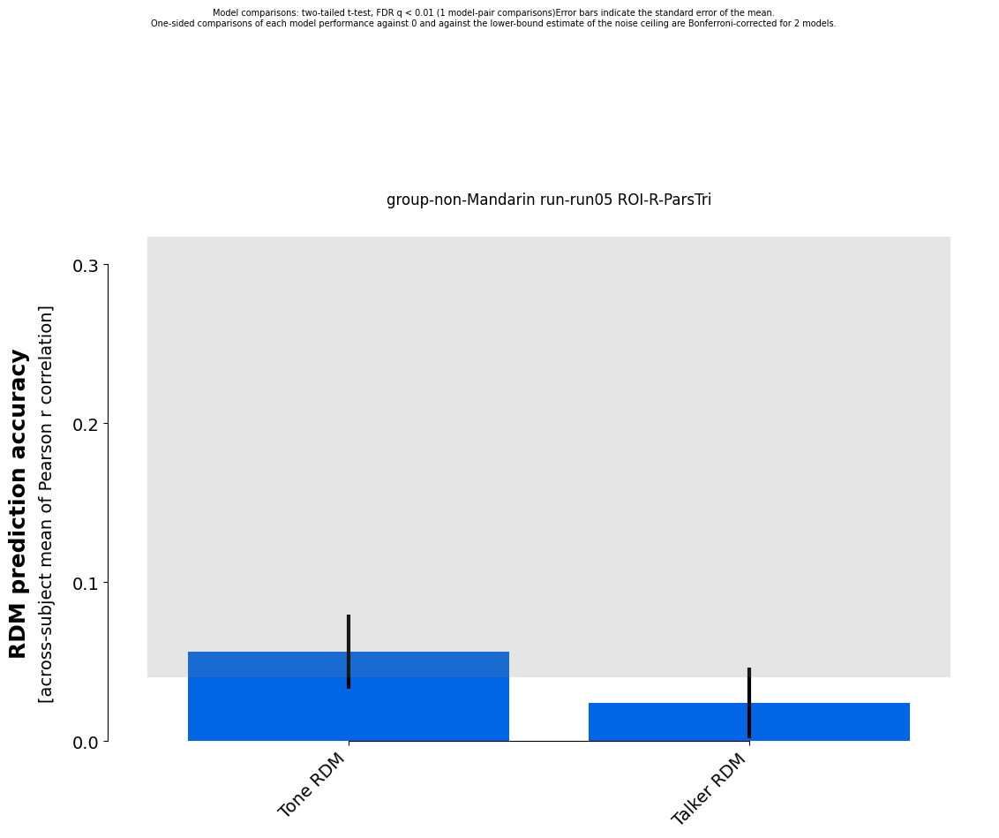

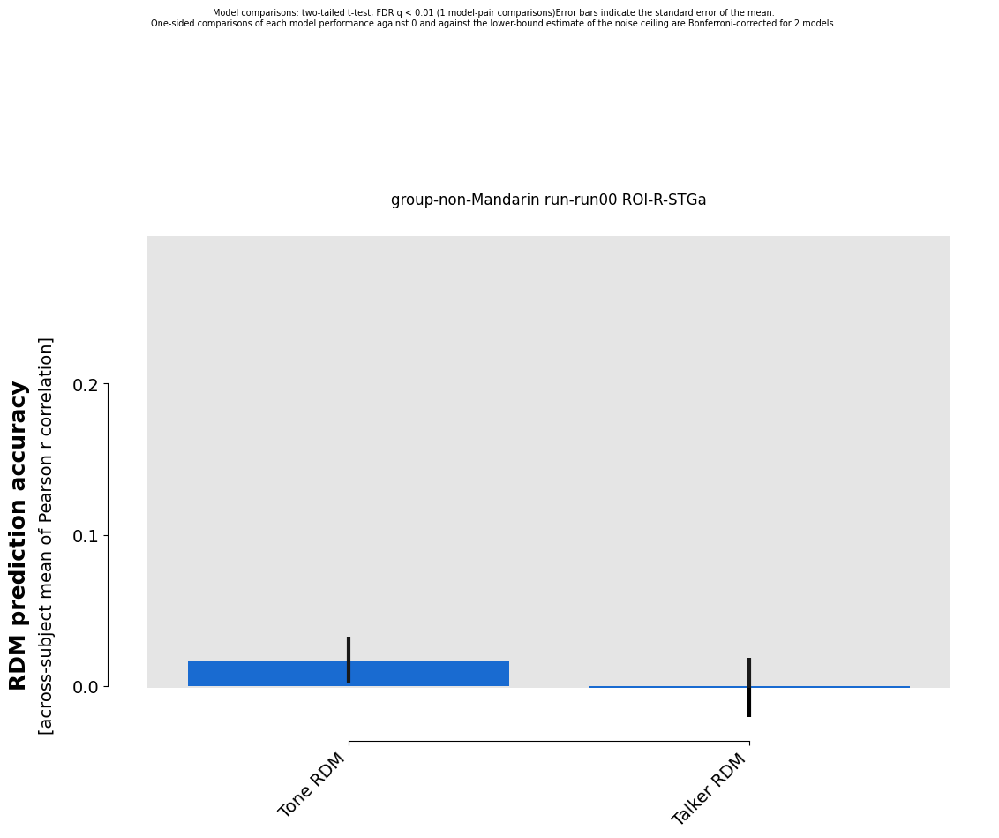

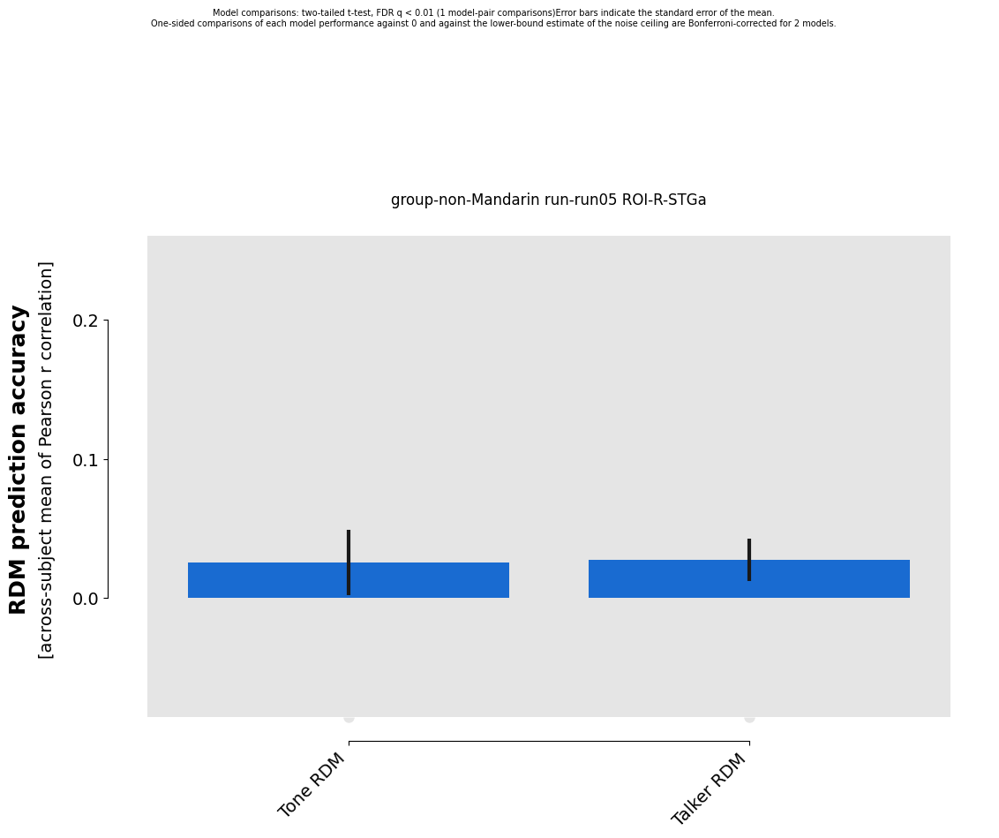

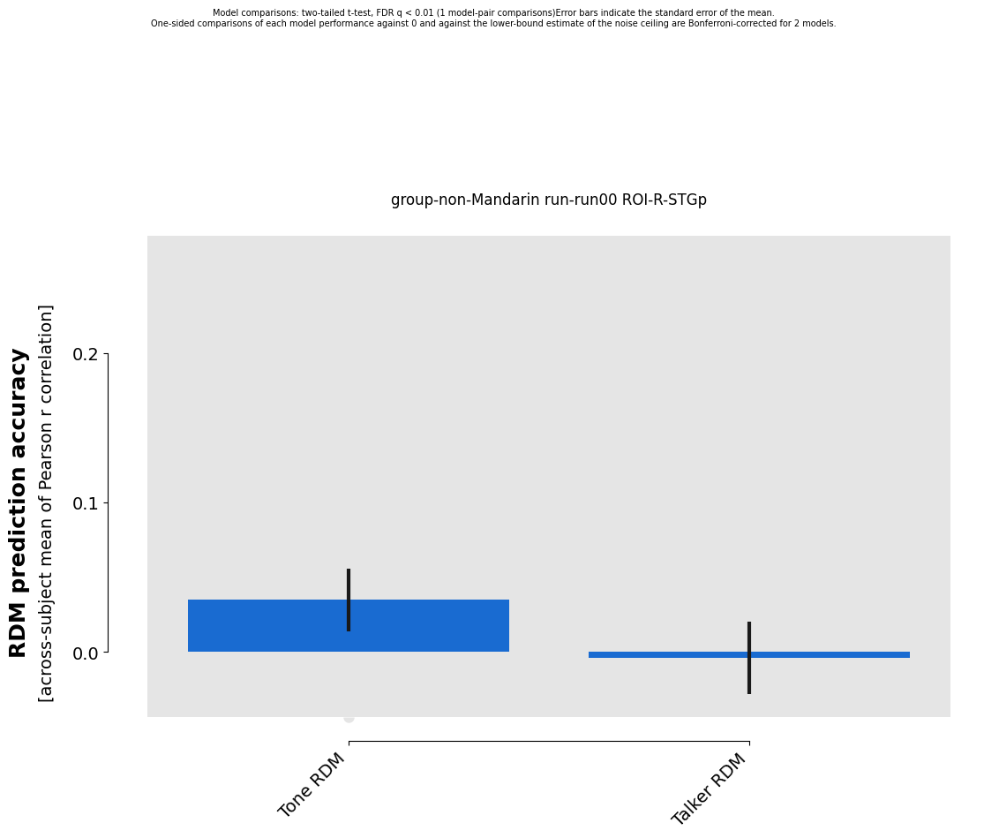

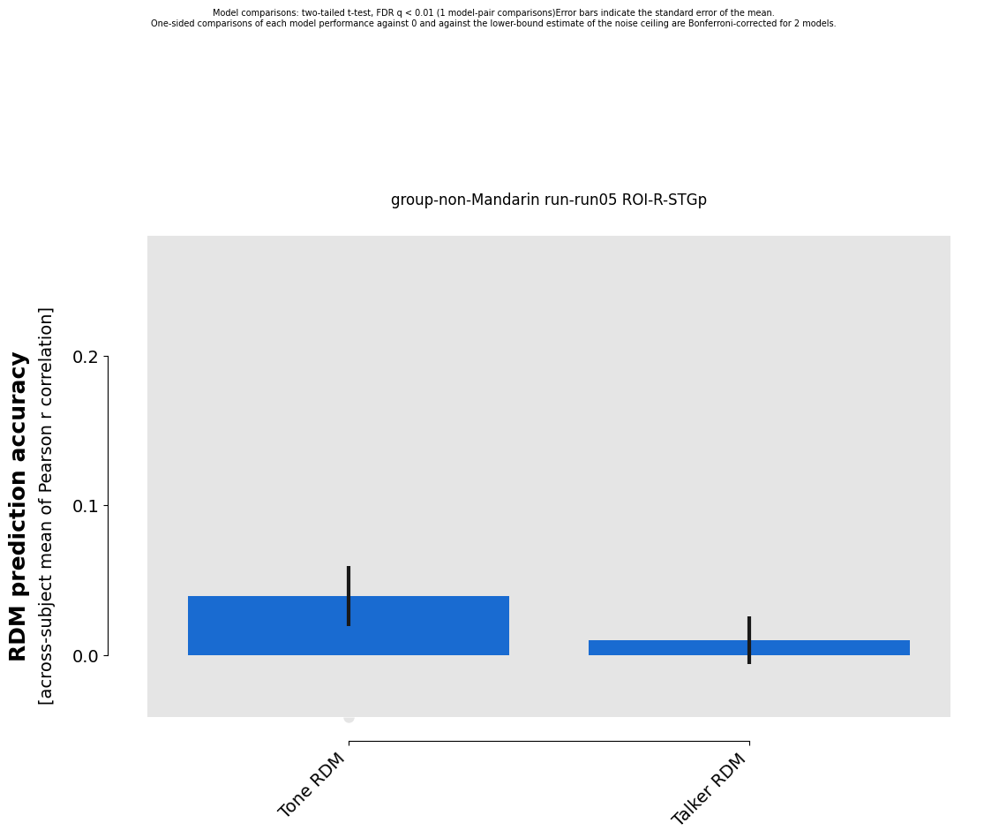

In [30]:
'''
group = 'Mandarin'
run = 'run00'
ROI = 'mask-R-ParsTri'
'''
for group in ['non-Mandarin']:#np.unique(group_rdms.rdm_descriptors['group']):
    #for run in np.unique(group_rdms.rdm_descriptors['run']):
    for ROI in np.unique(group_rdms.rdm_descriptors['ROI']):
        for run in ['run00', 'run05']:
            print(f'group-{group} run-{run} ROI-{ROI}')
            results_grr = rsatoolbox.inference.eval_fixed(all_models, 
                                                          group_rdms.subset('group', value=group).subset('run',value=run).subset('ROI',value=ROI),  
                                                          method='corr',)
            fig, ax1, ax2 = rsatoolbox.vis.plot_model_comparison(results_grr);
            ax1.set_title(f'group-{group} run-{run} ROI-{ROI}');
            ax1.axes.set_xticklabels(ax1.xaxis.get_majorticklabels(), ha="right")

            #results_grr.save(f'results-eval/results-eval_group-{group}_run-{run}_ROI-{ROI}.hdf5',overwrite=True)

In [31]:
print(results_grr)

Results for running fixed evaluation for corr on 2 models:

Model      |   Eval ± SEM   | p (against 0) | p (against NC) |
--------------------------------------------------------------
Tone RDM   |  0.039 ± 0.020 |        0.040  |         0.003  |
Talker RDM |  0.010 ± 0.016 |        0.276  |         0.009  |

p-values are based on uncorrected t-tests


### Run separate RSA for each subject and run

In [ ]:
for sub_id in ['FLT03']: #beh_mat_dict:
    print(sub_id)
    
    for run_id in beh_mat_dict[sub_id]:
        print(run_id)
        
        beh_mat = beh_mat_dict[sub_id][run_id]
        beh_dis_mat = beh_mat * -1 +1
        
        beh_rdm = RDMs(beh_dis_mat,)
        beh_model = ModelFixed('Behavior Model', rdm=beh_rdm)
        
        print(f'sub-{sub_id} {run_id}')
        results_beh = rsatoolbox.inference.eval_fixed(beh_model, 
                                                      group_rdms.subset('run',value=run_id).subset('participant', value=sub_id),  
                                                      method='corr',)
        fig, ax1, ax2 = rsatoolbox.vis.plot_model_comparison(results_grr);
        ax1.set_title(f'group-{group} ROI-{ROI} sub-{sub_id}');
        ax1.axes.set_xticklabels(ax1.xaxis.get_majorticklabels(), ha="right")

### Combine runs 1–2, 3–4, and 5–6

In [27]:
runcombo_dict = {'early': ['run00', 'run01'], 'middle': ['run02', 'run03'], 'final': ['run04','run05']}

In [28]:
runcombo_dict

{'early': ['run00', 'run01'],
 'middle': ['run02', 'run03'],
 'final': ['run04', 'run05']}

In [29]:
for x in runcombo_dict:
    print(runcombo_dict[x])

['run00', 'run01']
['run02', 'run03']
['run04', 'run05']


In [35]:
'''
group = 'Mandarin'
run = 'run00'
ROI = 'mask-R-ParsTri'
'''
for group in ['non-Mandarin']:#np.unique(group_rdms.rdm_descriptors['group']):
    runcombo_res_dict = {}
    for runcombo in runcombo_dict:
        # initialize results list
        runcombo_roi_res_dict = {}
        
        for ROI in np.unique(group_rdms.rdm_descriptors['ROI']):
            if 'GP' not in ROI:
                print(f'group-{group} runcombo-{runcombo} ROI-{ROI}')
                runs = runcombo_dict[runcombo]
                results_grr = rsatoolbox.inference.eval_fixed(all_models, 
                                                              group_rdms.subset('group', value=group).subset('run',value=runs).subset('ROI',value=ROI),  
                                                              method='corr',)
                print(results_grr.test_pairwise())
                runcombo_roi_res_dict[ROI] = results_grr
                
                #fig, ax1, ax2 = rsatoolbox.vis.plot_model_comparison(results_grr);
                #ax1.set_title(f'group-{group} runcombo-{runcombo} ROI-{ROI}');
                #ax1.axes.set_xticklabels(ax1.xaxis.get_majorticklabels(), ha="right")

                #results_grr.save(f'results-eval/results-eval_group-{group}_run-{run}_ROI-{ROI}.hdf5',overwrite=True)
        runcombo_res_dict[runcombo] = runcombo_roi_res_dict

group-non-Mandarin runcombo-early ROI-L-HG
[[1.         0.47819621]
 [0.47819621 1.        ]]
group-non-Mandarin runcombo-early ROI-L-IC
[[1.         0.24061192]
 [0.24061192 1.        ]]
group-non-Mandarin runcombo-early ROI-L-MGN
[[1.         0.68491909]
 [0.68491909 1.        ]]
group-non-Mandarin runcombo-early ROI-L-PP
[[1.        0.1456813]
 [0.1456813 1.       ]]
group-non-Mandarin runcombo-early ROI-L-PT
[[1.         0.33096821]
 [0.33096821 1.        ]]
group-non-Mandarin runcombo-early ROI-L-ParsOp
[[1.         0.52531362]
 [0.52531362 1.        ]]
group-non-Mandarin runcombo-early ROI-L-ParsTri
[[1.         0.19624258]
 [0.19624258 1.        ]]
group-non-Mandarin runcombo-early ROI-L-STGa
[[1.         0.13444548]
 [0.13444548 1.        ]]
group-non-Mandarin runcombo-early ROI-L-STGp
[[1.         0.11994314]
 [0.11994314 1.        ]]
group-non-Mandarin runcombo-early ROI-R-HG
[[1.         0.54283431]
 [0.54283431 1.        ]]
group-non-Mandarin runcombo-early ROI-R-IC
[[1.   

In [37]:
# get the model-vs-model pairwise t-test results
runcombo_res_dict['early']['R-HG'].test_pairwise()[0][1]

0.5428343134009257

In [39]:
#get the mean evaluations
runcombo_res_dict['early']['R-HG'].get_means()

array([0.01402361, 0.00204882])

In [40]:
# as a check, compute the mean evaluations (comes to the same as above)
#'CAU-DA-lh'
np.mean(runcombo_res_dict['early']['R-HG'].evaluations[0,1])

0.0020488234351700857

In [41]:
# see all the values in the evaluations (equal to number of subjects x number of runs in this model)
runcombo_res_dict['early']['R-HG'].evaluations[0][1]

array([-0.01000728,  0.0460764 , -0.03478492,  0.05396415,  0.10243966,
        0.10804536,  0.015302  ,  0.02484771, -0.04130915, -0.09082552,
        0.0247724 , -0.06577297,  0.00174687, -0.01291057,  0.01797668,
       -0.02528725,  0.01809979, -0.01157045,  0.00394744, -0.04126436,
       -0.05539608,  0.01698419])

In [42]:
print(runcombo_res_dict['early']['R-HG'])#['CAU-DA-lh'])

Results for running fixed evaluation for corr on 2 models:

Model      |   Eval ± SEM   | p (against 0) | p (against NC) |
--------------------------------------------------------------
Tone RDM   |  0.014 ± 0.013 |        0.139  |       < 0.001  |
Talker RDM |  0.002 ± 0.010 |        0.424  |       < 0.001  |

p-values are based on uncorrected t-tests


In [63]:
for group in ['non-Mandarin']:
    runcombo_eval_tone_dict = {}
    runcombo_eval_talker_dict = {}
    for runcombo in runcombo_dict:
        runcombo_roi_mean_tone_dict = {}
        runcombo_roi_mean_talker_dict = {}
        for ROI in np.unique(group_rdms.rdm_descriptors['ROI']):
            if 'GP' not in ROI:
            
                print(f'group-{group} runcombo-{runcombo} ROI-{ROI}')
                runs = runcombo_dict[runcombo]
                results_grr = rsatoolbox.inference.eval_fixed(all_models, 
                                                              group_rdms.subset('group', value=group).subset('run',value=runs).subset('ROI',value=ROI),  
                                                              method='corr',)
                runcombo_roi_mean_tone_dict[ROI] = results_grr.get_means()[0]
                runcombo_roi_mean_talker_dict[ROI] = results_grr.get_means()[1]
                #print(results_grr)
                print(f'pairwise t-test: {results_grr.test_pairwise()[0][1]:.04f}')
                print(f'tone t-test ind: {results_grr.test_zero()[0]:.04f}')
                print('\n')
        runcombo_eval_tone_dict[runcombo] = runcombo_roi_mean_tone_dict
        runcombo_eval_talker_dict[runcombo] = runcombo_roi_mean_talker_dict

group-non-Mandarin runcombo-early ROI-L-HG
pairwise t-test: 0.4782
tone t-test ind: 0.1042


group-non-Mandarin runcombo-early ROI-L-IC
pairwise t-test: 0.2406
tone t-test ind: 0.0693


group-non-Mandarin runcombo-early ROI-L-MGN
pairwise t-test: 0.6849
tone t-test ind: 0.5728


group-non-Mandarin runcombo-early ROI-L-PP
pairwise t-test: 0.1457
tone t-test ind: 0.0190


group-non-Mandarin runcombo-early ROI-L-PT
pairwise t-test: 0.3310
tone t-test ind: 0.0180


group-non-Mandarin runcombo-early ROI-L-ParsOp
pairwise t-test: 0.5253
tone t-test ind: 0.0359


group-non-Mandarin runcombo-early ROI-L-ParsTri
pairwise t-test: 0.1962
tone t-test ind: 0.0181


group-non-Mandarin runcombo-early ROI-L-STGa
pairwise t-test: 0.1344
tone t-test ind: 0.0135


group-non-Mandarin runcombo-early ROI-L-STGp
pairwise t-test: 0.1199
tone t-test ind: 0.0035


group-non-Mandarin runcombo-early ROI-R-HG
pairwise t-test: 0.5428
tone t-test ind: 0.1388


group-non-Mandarin runcombo-early ROI-R-IC
pairwise t-te

In [44]:
results_grr.test_zero()

array([0.00062801, 0.54096775])

In [46]:
tone_df = pd.DataFrame.from_dict(runcombo_eval_tone_dict, orient='columns').melt(value_name='mean_eval', var_name='stage', ignore_index=False).reset_index()
tone_df.rename(columns={'index':'ROI'}, inplace=True)
tone_df['model'] = 'tone'

talker_df = pd.DataFrame.from_dict(runcombo_eval_talker_dict, orient='columns').melt(value_name='mean_eval', var_name='stage', ignore_index=False).reset_index()
talker_df.rename(columns={'index':'ROI'}, inplace=True)
talker_df['model'] = 'talker'

model_df = pd.concat([tone_df, talker_df])

In [47]:
model_df

,ROI,stage,mean_eval,model
0,L-HG,early,0.017920,tone
1,L-IC,early,0.020273,tone
2,L-MGN,early,-0.002137,tone
3,L-PP,early,0.029609,tone
4,L-PT,early,0.030334,tone
...,...,...,...,...
49,R-PT,final,0.011740,talker
50,R-ParsOp,final,-0.001535,talker
51,R-ParsTri,final,0.001608,talker
52,R-STGa,final,0.003219,talker


In [48]:
model_df.dtypes

ROI           object
stage         object
mean_eval    float64
model         object
dtype: object

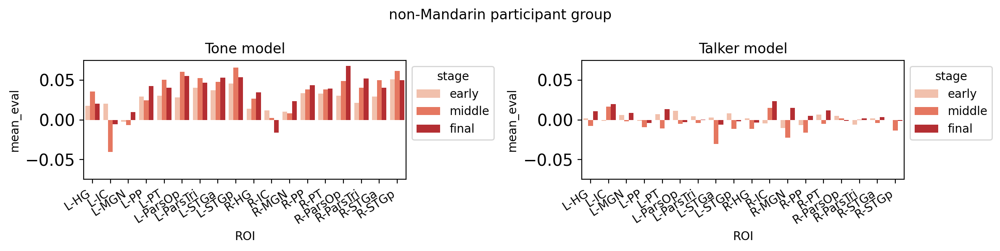

In [60]:
fig, ax = plt.subplots(1,2, figsize=(12,3), dpi=200)
fig.suptitle(f'{group} participant group')
sns.barplot(data=model_df[model_df['model']=='tone'], x='ROI', y='mean_eval', hue='stage', 
            ax=ax[0], palette='Reds',)
sns.barplot(data=model_df[model_df['model']=='talker'], x='ROI', y='mean_eval', hue='stage', 
            ax=ax[1], palette='Reds',)
ax[0].set_title('Tone model')
ax[1].set_title('Talker model')

#ax[0].set_ylim([-.025, .05])
ax[0].set_ylim([-.075, .075])
ax[1].set_ylim([-.075, .075])
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=33, ha='right')
ax[1].set_xticklabels(ax[0].get_xticklabels(), rotation=33, ha='right')
sns.move_legend(ax[0], "upper left", bbox_to_anchor=(1, 1))
sns.move_legend(ax[1], "upper left", bbox_to_anchor=(1, 1))
fig.tight_layout()

#sns.displot(data=model_df, x='ROI', y='mean_eval', hue='stage', col='model')

In [ ]:
# print(results_grr)

In [55]:
for group in ['non-Mandarin']:
    for runcombo in runcombo_dict:
        #for ROI in np.unique(group_rdms.rdm_descriptors['ROI']):
        #    if 'GP' not in ROI:

        print(f'group-{group} runcombo-{runcombo}')
        runs = runcombo_dict[runcombo]
        results_grr = rsatoolbox.inference.eval_fixed(all_models, 
                                                      group_rdms.subset('group', value=group).subset('run',value=runs),#.subset('ROI',value=ROI),  
                                                      method='corr',)
        #print(results_grr)
        print(f'pairwise t-test: {results_grr.test_pairwise()[0][1]:.04f}')
        print('\n')

group-non-Mandarin runcombo-early
pairwise t-test: 0.0000


group-non-Mandarin runcombo-middle
pairwise t-test: 0.0000


group-non-Mandarin runcombo-final
pairwise t-test: 0.0000




### [ARCHIVE] Combine runs 1–3, 4–6

In [44]:
runcombo_dict = {'firsthalf': ['run00', 'run01', 'run02'], 'secondhalf': ['run03', 'run04','run05']}

In [45]:
runcombo_dict

{'firsthalf': ['run00', 'run01', 'run02'],
 'secondhalf': ['run03', 'run04', 'run05']}

In [46]:
for x in runcombo_dict:
    print(runcombo_dict[x])

['run00', 'run01', 'run02']
['run03', 'run04', 'run05']


group-Mandarin runs-firsthalf CAU-DA-lh
group-Mandarin runs-secondhalf CAU-DA-lh
group-Mandarin runs-firsthalf CAU-DA-rh
group-Mandarin runs-secondhalf CAU-DA-rh
group-Mandarin runs-firsthalf CAU-VA-lh
group-Mandarin runs-secondhalf CAU-VA-lh
group-Mandarin runs-firsthalf CAU-VA-rh
group-Mandarin runs-secondhalf CAU-VA-rh
group-Mandarin runs-firsthalf NAc-core-lh
group-Mandarin runs-secondhalf NAc-core-lh
group-Mandarin runs-firsthalf NAc-core-rh
group-Mandarin runs-secondhalf NAc-core-rh
group-Mandarin runs-firsthalf NAc-shell-lh
group-Mandarin runs-secondhalf NAc-shell-lh
group-Mandarin runs-firsthalf NAc-shell-rh
group-Mandarin runs-secondhalf NAc-shell-rh
group-Mandarin runs-firsthalf PUT-DA-lh
group-Mandarin runs-secondhalf PUT-DA-lh
group-Mandarin runs-firsthalf PUT-DA-rh
group-Mandarin runs-secondhalf PUT-DA-rh
group-Mandarin runs-firsthalf PUT-DP-lh
group-Mandarin runs-secondhalf PUT-DP-lh
group-Mandarin runs-firsthalf PUT-DP-rh
group-Mandarin runs-secondhalf PUT-DP-rh
group-Ma

ValueError: rdm1 and rdm2 have different nan positions

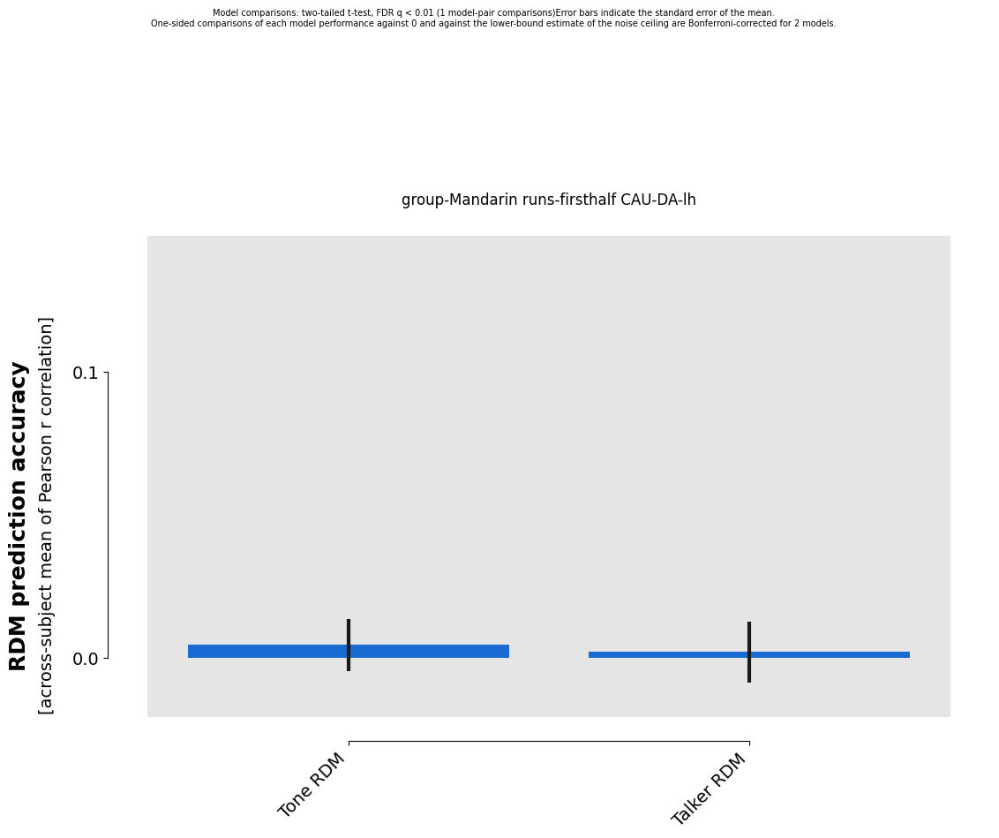

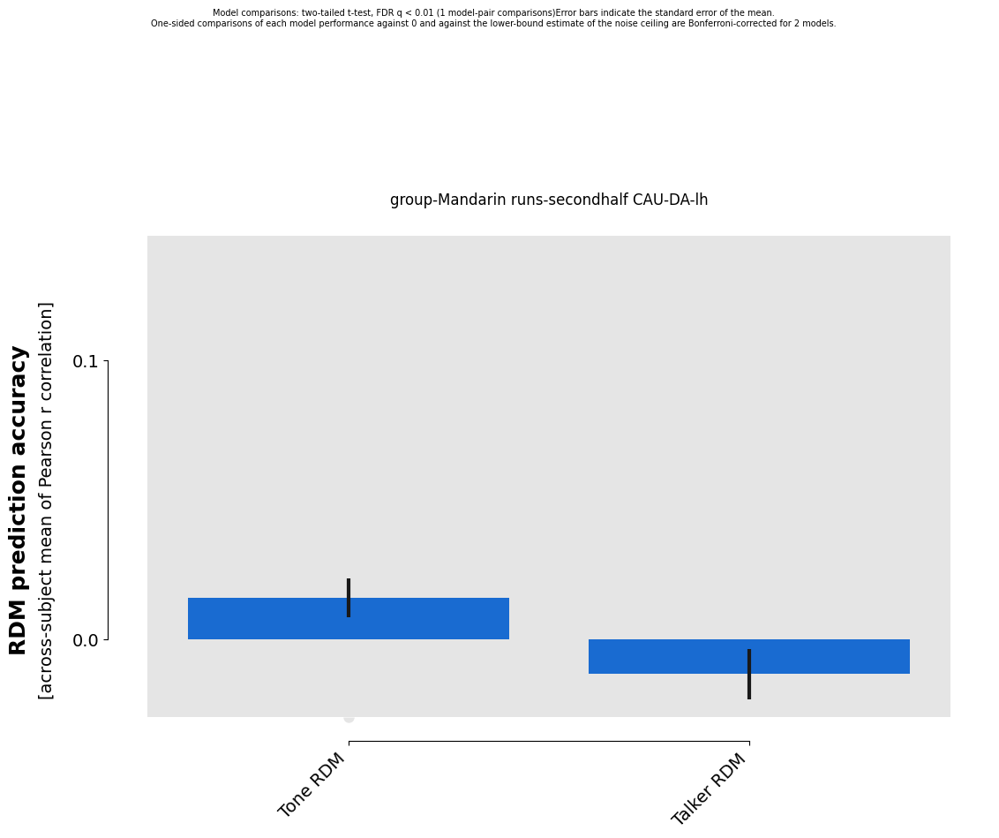

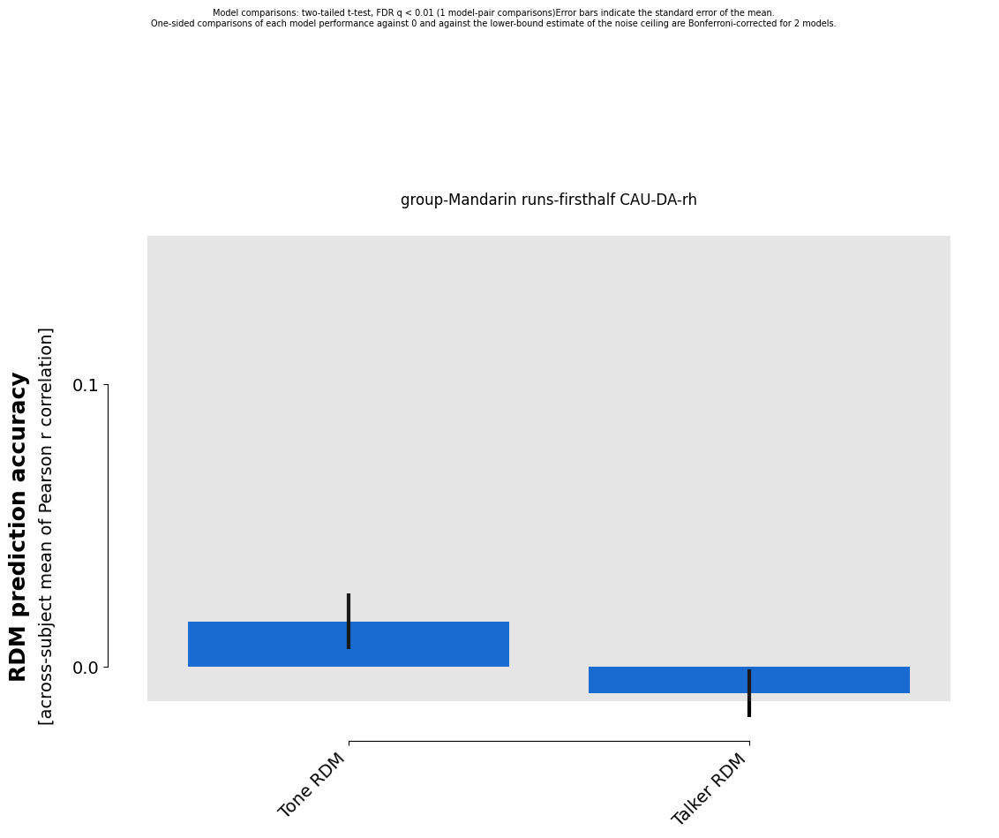

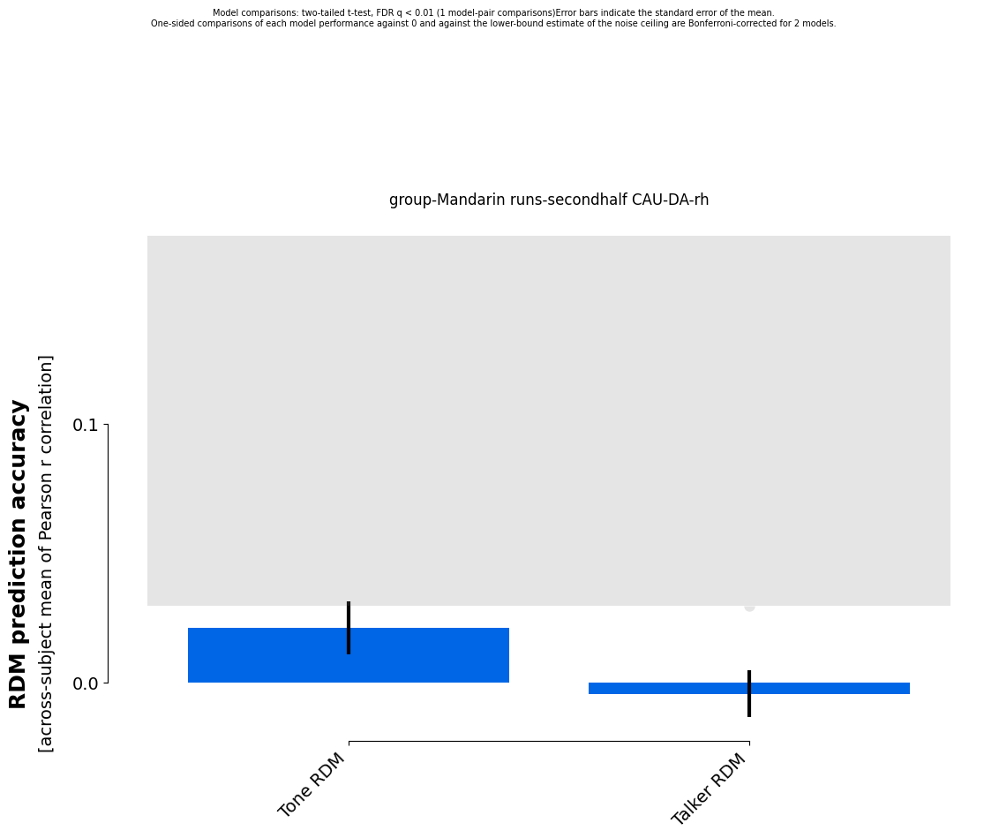

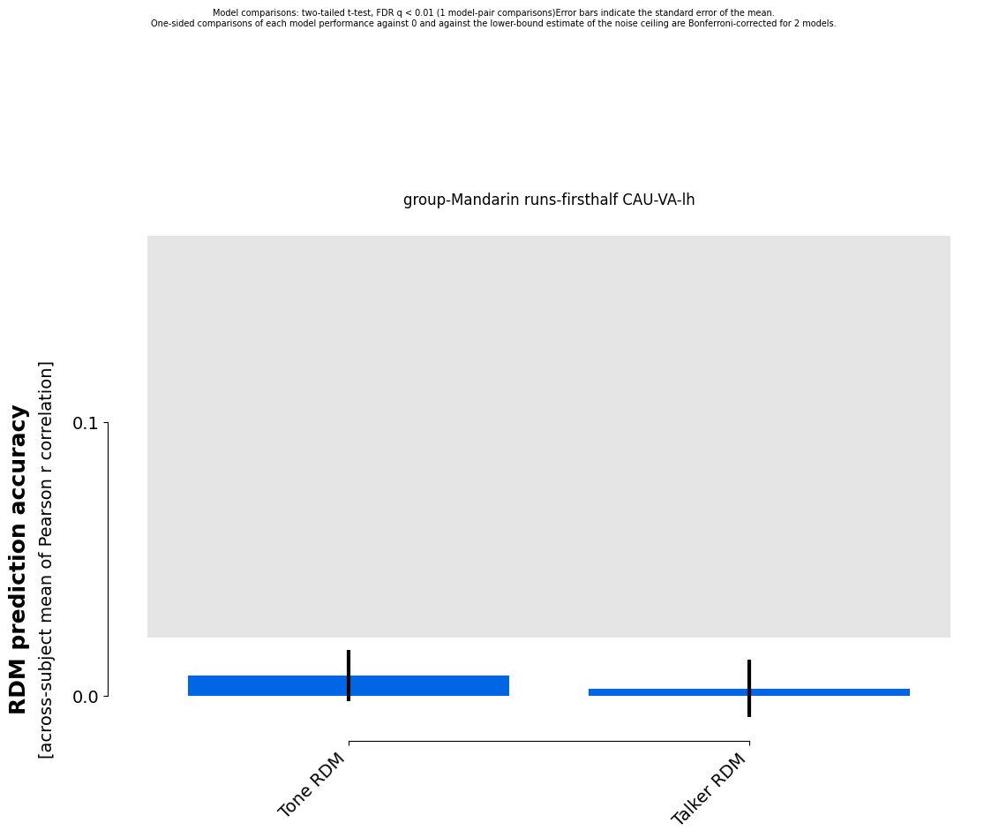

...

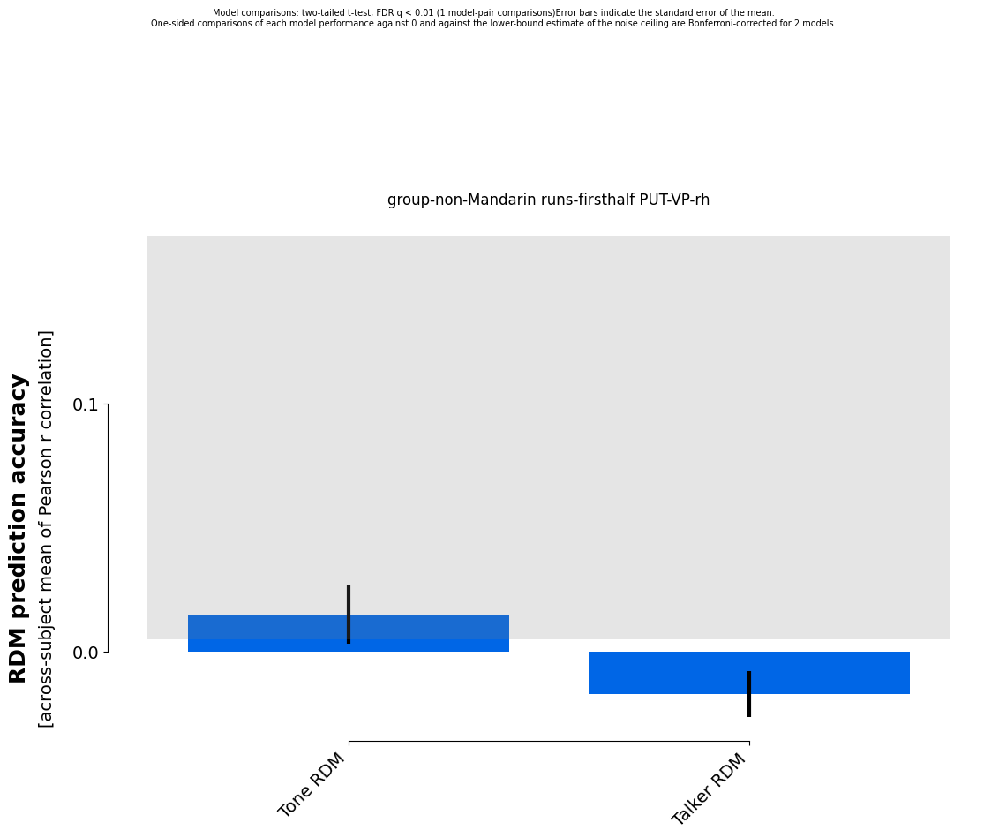

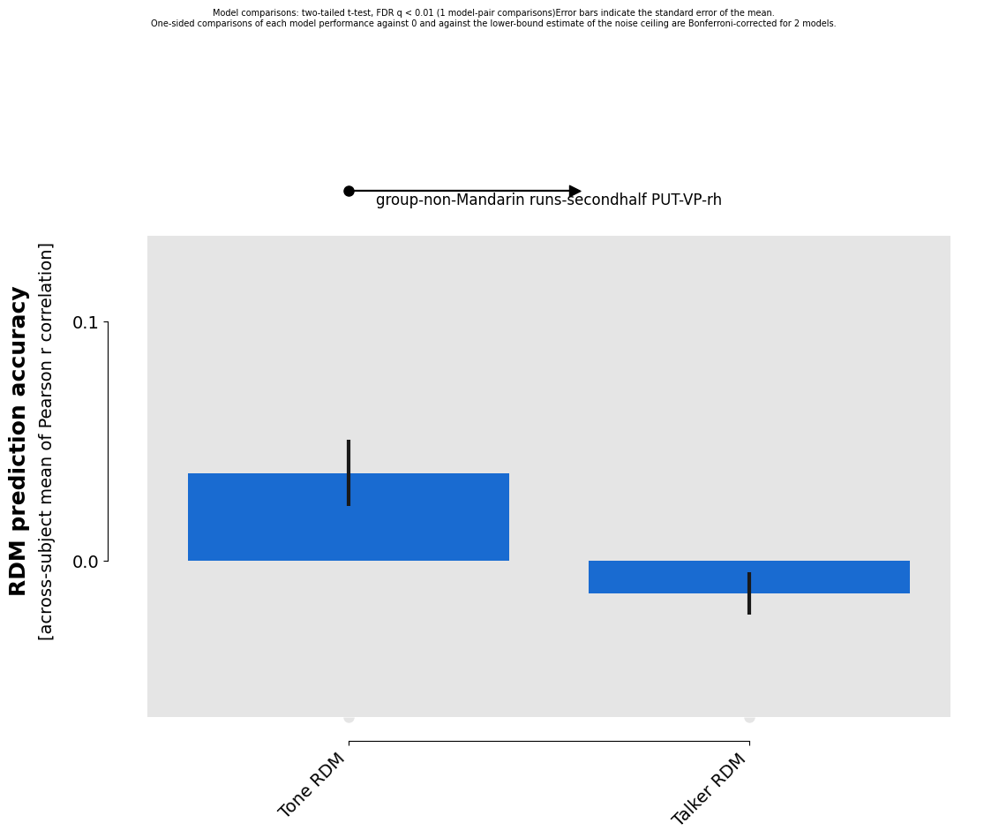

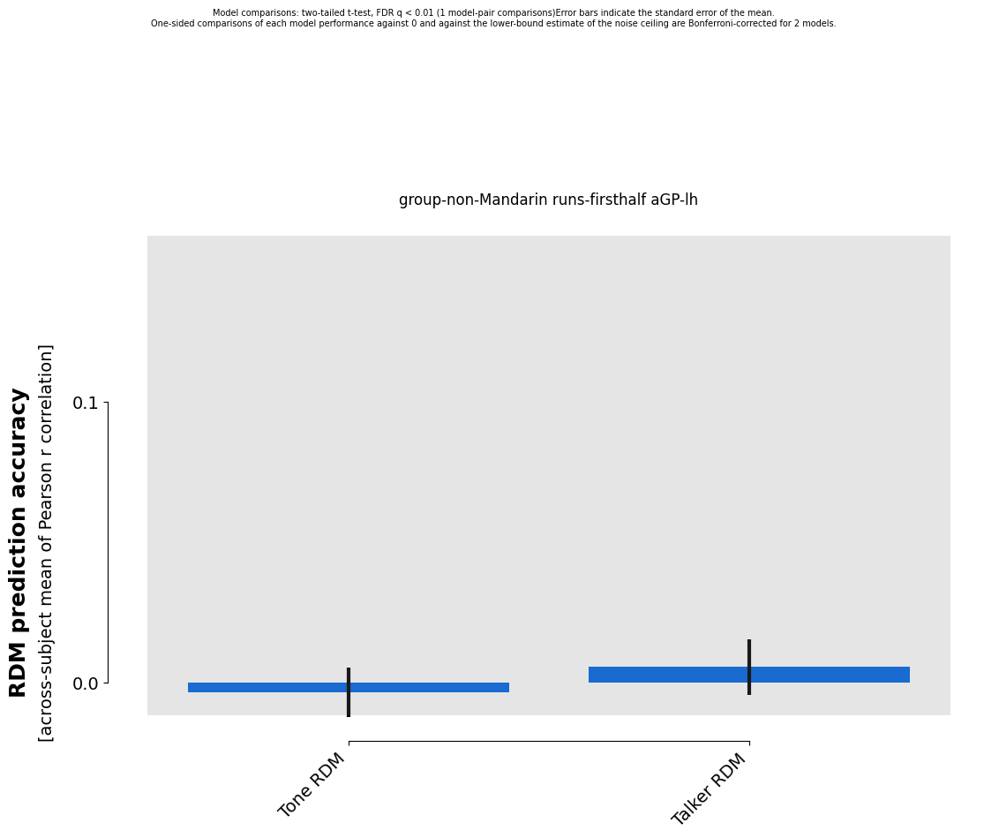

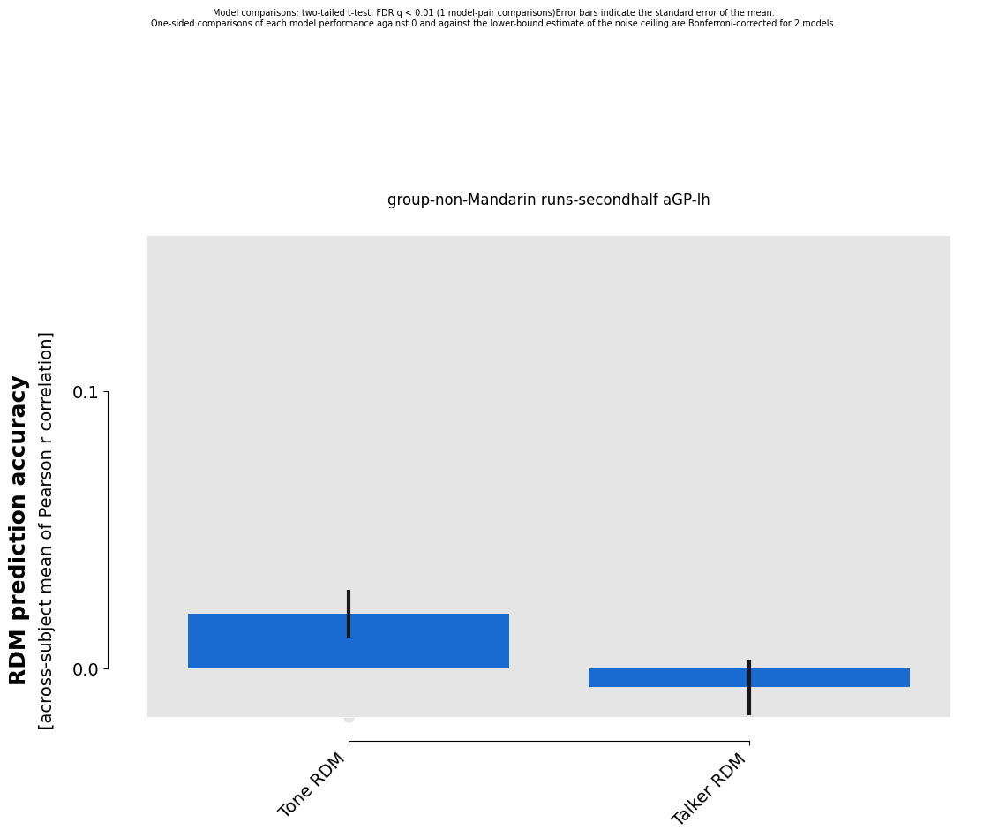

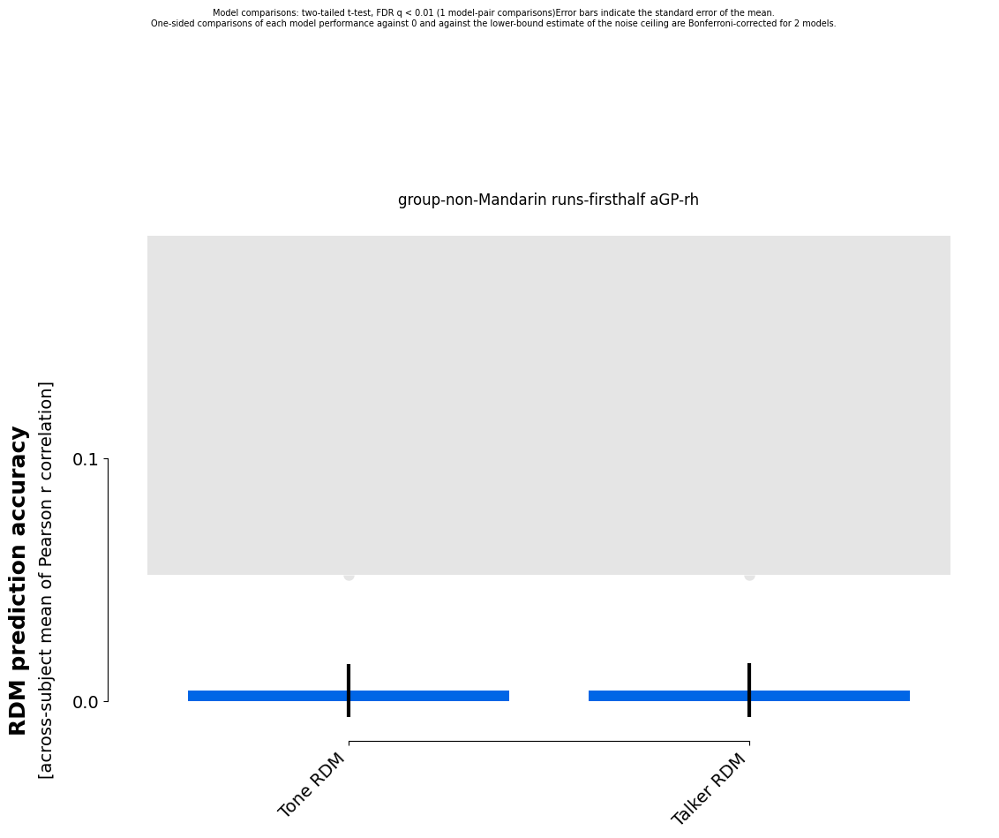

In [47]:
'''
group = 'Mandarin'
run = 'run00'
ROI = 'mask-R-ParsTri'
'''
for group in np.unique(group_rdms.rdm_descriptors['group']): #['non-Mandarin']:#
    #for run in np.unique(group_rdms.rdm_descriptors['run']):
    for ROI in np.unique(group_rdms.rdm_descriptors['ROI']):
        if 'MGN' in ROI:
            continue
        for runcombo in runcombo_dict:
            print(f'group-{group} runs-{runcombo} {ROI}')
            runs = runcombo_dict[runcombo]
            results_grr = rsatoolbox.inference.eval_fixed(
                                                          cat_models, #all_models, 
                                                          group_rdms.subset('group', value=group).subset('run',value=runs).subset('ROI',value=ROI),  
                                                          method='corr',)
            fig, ax1, ax2 = rsatoolbox.vis.plot_model_comparison(results_grr);
            ax1.set_title(f'group-{group} runs-{runcombo} {ROI}');
            ax1.axes.set_xticklabels(ax1.xaxis.get_majorticklabels(), ha="right")

            #results_grr.save(f'results-eval/results-eval_group-{group}_run-{run}_ROI-{ROI}.hdf5',overwrite=True)

In [48]:
print(results_grr)

Results for running fixed evaluation for corr on 2 models:

Model      |   Eval ± SEM   | p (against 0) | p (against NC) |
--------------------------------------------------------------
Tone RDM   |  0.004 ± 0.011 |        0.352  |       < 0.001  |
Talker RDM |  0.004 ± 0.011 |        0.349  |       < 0.001  |

p-values are based on uncorrected t-tests


### WIP: Hierarchical tests, split runs

In [39]:
mean_rdms_mand

rsatoolbox.rdm.RDMs(
dissimilarity_measure = 
None
dissimilarities = 
[[2.18434469 2.16593166 1.71754503 ... 1.64891619 2.0924978  1.91266717]
 [2.24480756 2.12806912 2.00712243 ... 2.41159459 2.52758356 2.16290508]
 [2.3028531  2.16342697 2.05838177 ... 2.16271216 2.17274798 2.16089866]
 ...
 [2.33004238 2.27638168 2.32752825 ... 2.00584334 2.37240804 2.01215973]
 [2.41159076 2.38467481 2.47870339 ... 2.16319079 2.40912419 2.06779915]
 [2.42380789 2.32801541 2.47918812 ... 2.1073666  2.41325774 2.00063277]]
descriptors = 
{}
rdm_descriptors = 
{'run': ['run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run00', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run01', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02', 'run02',

In [40]:
neural_models_dict = {}

neural_models_dict['Mandarin'] = [ModelFixed(x, rdm=mean_rdms_mand.subset('group', value='Mandarin').subset('ROI',value=x)) for x in np.unique(mean_rdms_mand.rdm_descriptors['ROI'])]
neural_models_dict['non-Mandarin'] = [ModelFixed(x, rdm=mean_rdms_nman.subset('group', value='non-Mandarin').subset('ROI',value=x)) for x in np.unique(mean_rdms_nman.rdm_descriptors['ROI'])]


In [43]:
for group in ['non-Mandarin']:# np.unique(group_rdms.rdm_descriptors['group']): # 
    for ROI in np.unique(group_rdms.rdm_descriptors['ROI']):
        print(f'group-{group} ROI-{ROI}')
        results_grr = rsatoolbox.inference.eval_fixed(neural_models_dict[group], 
                                                      group_rdms.subset('group', value=group).subset('ROI',value=ROI),  
                                                      method='corr',)
        fig, ax1, ax2 = rsatoolbox.vis.plot_model_comparison(results_grr,
                                                             test_pair_comparisons='nili', #False, # getting a bug from plot_arrow()
                                                            );
        ax1.set_title(f'group-{group} ROI-{ROI}');
        ax1.axes.set_xticklabels(ax1.xaxis.get_majorticklabels(), ha="right")

group-Mandarin ROI-mask-L-HG


ValueError: could not broadcast input array from shape (6,84) into shape (84,)

## Run-all

In [25]:
model_desc = 'run-all_LSS'

### Load run-all subject-specific RDMs

In [26]:
# from `rsa_roi.py`-generated outputs
group_rdm_list = []
for sx, sub_id in enumerate(participant_list): # enumerate(['FLT03']): #
    print(sub_id)
    group_id = group_assignment[sx]

    out_dir = os.path.join(model_dir, 'rsa_roi', network_name)
    os.makedirs(out_dir, exist_ok=True)
    sub_fpath = os.path.join(out_dir,
                         f'sub-{sub_id}_{network_name}_{model_desc}_rdms.hdf5')
    sub_rdm = rsatoolbox.rdm.rdms.load_rdm(sub_fpath)
    
    # add the group descriptor to the subject's RDM
    sub_rdm.rdm_descriptors['group'] = [group_id for x in sub_rdm.rdm_descriptors['index']]
    group_rdm_list.append(sub_rdm)
runall_rdms = rsatoolbox.rdm.rdms.concat(group_rdm_list)

FLT02
FLT03
FLT04
FLT05
FLT06
FLT08
FLT09
FLT10
FLT11
FLT12
FLT13
FLT14
FLT15
FLT17
FLT18
FLT19
FLT20
FLT21
FLT22
FLT23
FLT24
FLT25
FLT26
FLT28
FLT30


### [ARCHIVE] Generate run-all RDMs (NOW RUN WITH RSA_ROI.PY)

#### generate run-all RDMs

In [24]:
group_rdm_list = []
for sx, sub_id in enumerate(participant_list):
    print(sub_id)
    group_id = group_assignment[sx]

    # set this path to wherever you saved the folder containing the img-files
    data_folder = os.path.join(model_dir, 'masked_statmaps',
                               'sub-{}'.format(sub_id),
                               'statmaps_masked',
                               'run-all_LSS')

    all_im_paths = sorted(glob('{}/*mask-*_cond-*_map-{}.csv'.format(data_folder, statmap)))
    #mask_list = np.unique([os.path.basename(x).split('_')[2] for x in all_im_paths])

    all_mask_data = []
    for mx, mask_descrip in enumerate(mask_list):

        print(mask_descrip)
        image_paths = sorted(glob('{}/*{}*/*{}*_cond-*_map-{}.csv'.format(data_folder, mask_descrip, mask_descrip, statmap)))
        #print('# of images: ', len(image_paths))

        mask_fpath = os.path.join(deriv_dir, 'nilearn', 'masks', 'sub-{}'.format(sub_id),
                                  'space-{}'.format(space_label), 'masks-dseg',
                                  'sub-{}_space-{}_mask-gm.nii.gz'.format(sub_id, space_label))

        try:
            n_vox = np.genfromtxt(image_paths[0]).shape[0]
        except IndexError:
            n_vox = 1

        data = np.zeros((len(image_paths), n_vox))
        for x, im in enumerate(image_paths):
            data[x] = np.genfromtxt(im)
        all_mask_data.append(data)

        roi_rdms = []
    for rx, mask_data in enumerate(all_mask_data):
        dataset = rsatoolbox.data.Dataset(mask_data, 
                                          descriptors={'participant': sub_id, 
                                                       'ROI': mask_list[rx], 
                                                       'group': group_id
                                                      },)
        test_rdm = rsatoolbox.rdm.calc_rdm(dataset)
        roi_rdms.append(test_rdm)
        group_rdm_list.append(test_rdm)

    concat_rdms = rsatoolbox.rdm.rdms.concat(roi_rdms)
runall_rdms = rsatoolbox.rdm.rdms.concat(group_rdm_list)
runall_rdms.save('group_run-all_denoised_LSS_rdms.hdf5')

FLT02
mask-L-IC
mask-L-MGN
mask-L-HG
mask-L-PP
mask-L-PT
mask-L-STGp
mask-L-STGa
mask-L-ParsOp
mask-L-ParsTri
mask-L-Caud
mask-L-Put
mask-R-IC
mask-R-MGN
mask-R-HG
mask-R-PP
mask-R-PT
mask-R-STGp
mask-R-STGa
mask-R-ParsOp
mask-R-ParsTri
mask-R-Caud
mask-R-Put
FLT03
mask-L-IC
mask-L-MGN
mask-L-HG
mask-L-PP
mask-L-PT
mask-L-STGp
mask-L-STGa
mask-L-ParsOp
mask-L-ParsTri
mask-L-Caud
mask-L-Put
mask-R-IC
mask-R-MGN
mask-R-HG
mask-R-PP
mask-R-PT
mask-R-STGp
mask-R-STGa
mask-R-ParsOp
mask-R-ParsTri
mask-R-Caud
mask-R-Put
FLT04
mask-L-IC
mask-L-MGN
mask-L-HG
mask-L-PP
mask-L-PT
mask-L-STGp
mask-L-STGa
mask-L-ParsOp
mask-L-ParsTri
mask-L-Caud
mask-L-Put
mask-R-IC
mask-R-MGN
mask-R-HG
mask-R-PP
mask-R-PT
mask-R-STGp
mask-R-STGa
mask-R-ParsOp
mask-R-ParsTri
mask-R-Caud
mask-R-Put
FLT05
mask-L-IC
mask-L-MGN
mask-L-HG
mask-L-PP
mask-L-PT
mask-L-STGp
mask-L-STGa
mask-L-ParsOp
mask-L-ParsTri
mask-L-Caud
mask-L-Put
mask-R-IC
mask-R-MGN
mask-R-HG
mask-R-PP
mask-R-PT
mask-R-STGp
mask-R-STGa
mask-R-ParsO

In [ ]:
runall_rdms.pattern_descriptors = pattern_descriptors

In [ ]:
runall_rdms

rsatoolbox.rdm.RDMs(
dissimilarity_measure = 
None
dissimilarities = 
[[1.65090326 2.54498709 2.7461404  ... 0.88731255 0.79245524 0.51212648]
 [1.76075364 2.25880332 2.01826887 ... 1.77228326 1.47480753 1.52958053]
 [2.1523935  2.63733217 2.3533549  ... 1.40091974 1.40092946 1.37507129]
 ...
 [1.59879128 1.7957521  2.21123099 ... 1.49749671 2.75822086 2.76852238]
 [1.73091562 1.73639412 2.10535821 ... 1.99467207 2.45316524 3.33237666]
 [1.44020635 1.53642467 1.73675281 ... 1.94358428 2.57684323 1.77874183]]
descriptors = 
{}
rdm_descriptors = 
{'participant': ['FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT02', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT03', 'FLT04', 'FLT04', 'FLT04', 'FLT04', 

#### load pre-generated run-all RDMs

In [33]:
runall_rdms = rsatoolbox.rdm.rdms.load_rdm('group_run-all_denoised_LSS_rdms.hdf5')

### plot all RDMs

In [27]:
fig = plt.figure(constrained_layout=True, figsize=(20,30), dpi=500)
fig.suptitle('Single-participant ROI RDMs')

subfigs = fig.subfigures(nrows=len(participant_list), ncols=1)

for sx, sub_id in enumerate(participant_list):
    subfigs[sx].suptitle(f'{sub_id} - {group_assignment[sx]} group')
    axes = subfigs[sx].subplots(nrows=1, ncols=len(roi_list))
    for rx, roi in enumerate(roi_list):
        rsatoolbox.vis.show_rdm_panel(runall_rdms.subset('participant', value=sub_id).subset('ROI', value=roi), 
                                        ax=axes[rx],
                                        rdm_descriptor='ROI', 
                                        cmap='inferno',
                                        #show_colorbar='panel', # cut figsize height in half if showing colorbar
                                       );


### Mean RDMs across participants per group

In [29]:
mean_rdms_mand_list = []
mean_rdms_nman_list = []
for rx, roi in enumerate(roi_list):
    # Mandarin-speaking
    dissim_mand = runall_rdms.subset('group', value='Mandarin').subset('ROI', value=roi).dissimilarities
    
    roi_mand = RDMs(dissim_mand.mean(axis=0),
                    rdm_descriptors={'ROI': roi_list[rx], 'group': 'Mandarin'},
                    pattern_descriptors=pattern_descriptors)
    mean_rdms_mand_list.append(roi_mand)
    
    # non-Mandarin-speaking
    dissim_nman = runall_rdms.subset('group', value='non-Mandarin').subset('ROI', value=roi).dissimilarities
    roi_nman = RDMs(dissim_nman.mean(axis=0),
                    rdm_descriptors={'ROI': roi_list[rx], 'group': 'non-Mandarin'},
                    pattern_descriptors=pattern_descriptors)
    mean_rdms_nman_list.append(roi_nman)

mean_rdms_mand = rsatoolbox.rdm.rdms.concat(mean_rdms_mand_list)
mean_rdms_nman = rsatoolbox.rdm.rdms.concat(mean_rdms_nman_list)



In [30]:
mean_rdms_nman

rsatoolbox.rdm.RDMs(
dissimilarity_measure = 
None
dissimilarities = 
[[2.11618211 2.38992923 2.2205338  ... 2.65738062 2.46549204 2.235462  ]
 [2.79261284 2.38764144 2.2699422  ... 2.2483238  2.03318107 2.13801953]
 [1.80170904 2.14256189 2.10990384 ... 2.23414089 1.91849686 2.25176959]
 ...
 [1.59680929 1.64366008 1.67798193 ... 1.55006426 1.56168073 1.59821656]
 [2.09717294 2.2730553  2.20896911 ... 2.29347383 2.20986174 1.96615651]
 [1.78959167 1.92622611 1.77073852 ... 1.87612073 1.82248211 1.58717749]]
descriptors = 
{}
rdm_descriptors = 
{'ROI': ['CAU-DA-lh', 'CAU-VA-lh', 'pCAU-lh', 'PUT-DA-lh', 'PUT-DP-lh', 'PUT-VA-lh', 'PUT-VP-lh', 'aGP-lh', 'pGP-lh', 'NAc-core-lh', 'NAc-shell-lh', 'CAU-DA-rh', 'CAU-VA-rh', 'pCAU-rh', 'PUT-DA-rh', 'PUT-DP-rh', 'PUT-VA-rh', 'PUT-VP-rh', 'aGP-rh', 'pGP-rh', 'NAc-core-rh', 'NAc-shell-rh'], 'group': ['non-Mandarin', 'non-Mandarin', 'non-Mandarin', 'non-Mandarin', 'non-Mandarin', 'non-Mandarin', 'non-Mandarin', 'non-Mandarin', 'non-Mandarin', 'non-

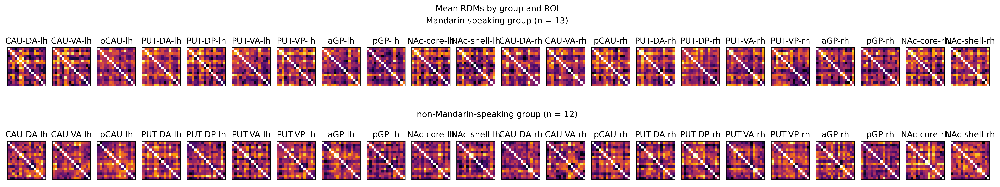

In [31]:
fig = plt.figure(constrained_layout=True, figsize=(20,4), dpi=500)
fig.suptitle('Mean RDMs by group and ROI')

subfigs = fig.subfigures(nrows=2, ncols=1)

n_mand = len(sub_group_dict['Mandarin'])
n_nman = len(sub_group_dict['non-Mandarin'])

subfigs[0].suptitle(f'Mandarin-speaking group (n = {n_mand})')
subfigs[1].suptitle(f'non-Mandarin-speaking group (n = {n_nman})')

axs0 = subfigs[0].subplots(nrows=1, ncols=len(roi_list))
axs1 = subfigs[1].subplots(nrows=1, ncols=len(roi_list))
for rx, roi in enumerate(roi_list):
    rsatoolbox.vis.show_rdm_panel(mean_rdms_mand.subset('ROI', value=roi), 
                                  rdm_descriptor='ROI', 
                                  cmap='inferno', 
                                  ax=axs0[rx])
    rsatoolbox.vis.show_rdm_panel(mean_rdms_nman.subset('ROI', value=roi), 
                                  rdm_descriptor='ROI', 
                                  cmap='inferno', 
                                  ax=axs1[rx])

#### MDS

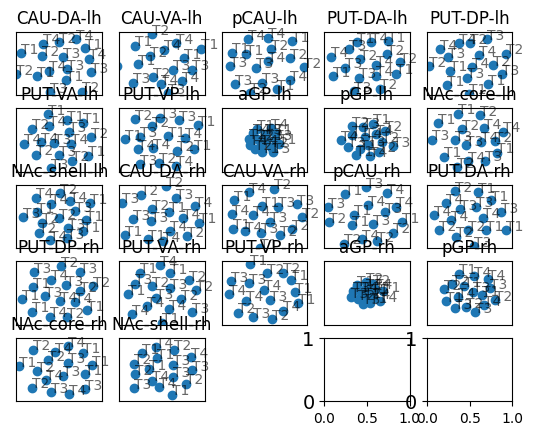

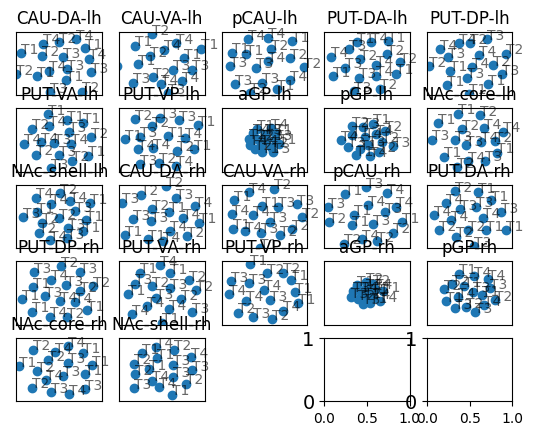

In [58]:
rsatoolbox.vis.scatter_plot.show_MDS(mean_rdms_mand, 
                                     rdm_descriptor='ROI',
                                     pattern_descriptor='tone')

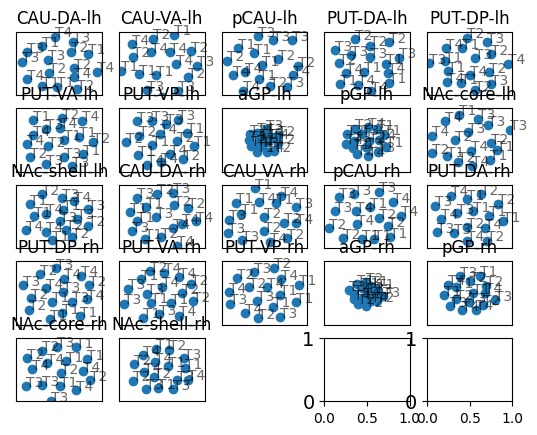

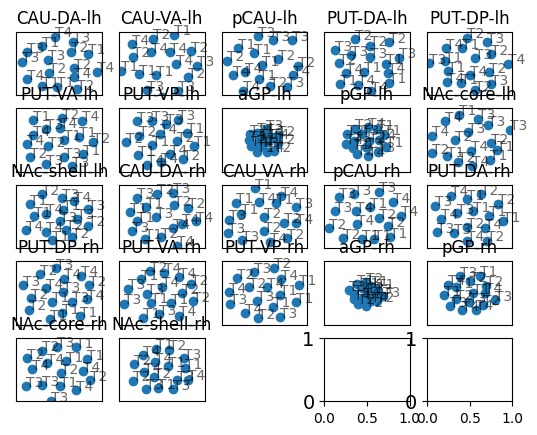

In [59]:
rsatoolbox.vis.scatter_plot.show_MDS(mean_rdms_nman, 
                                     rdm_descriptor='ROI',
                                     pattern_descriptor='tone')

### Model comparisons

In [35]:
[x.name for x in all_models]

['Tone RDM', 'Talker RDM']

In [78]:
test = {}
test['testkey'] = 'testval'
test

{'testkey': 'testval'}

group-Mandarin ROI-CAU-DA-lh
group-Mandarin ROI-CAU-DA-rh
group-Mandarin ROI-CAU-VA-lh
group-Mandarin ROI-CAU-VA-rh
group-Mandarin ROI-NAc-core-lh
group-Mandarin ROI-NAc-core-rh
group-Mandarin ROI-NAc-shell-lh
group-Mandarin ROI-NAc-shell-rh
group-Mandarin ROI-PUT-DA-lh
group-Mandarin ROI-PUT-DA-rh
group-Mandarin ROI-PUT-DP-lh
group-Mandarin ROI-PUT-DP-rh
group-Mandarin ROI-PUT-VA-lh
group-Mandarin ROI-PUT-VA-rh
group-Mandarin ROI-PUT-VP-lh
group-Mandarin ROI-PUT-VP-rh
group-Mandarin ROI-aGP-lh
group-Mandarin ROI-aGP-rh
group-Mandarin ROI-pCAU-lh
group-Mandarin ROI-pCAU-rh
group-Mandarin ROI-pGP-lh
group-Mandarin ROI-pGP-rh
group-non-Mandarin ROI-CAU-DA-lh
group-non-Mandarin ROI-CAU-DA-rh
group-non-Mandarin ROI-CAU-VA-lh


/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/rsatoolbox/vis/model_plot.py:282: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(12.5, 10))


group-non-Mandarin ROI-CAU-VA-rh
group-non-Mandarin ROI-NAc-core-lh
group-non-Mandarin ROI-NAc-core-rh
group-non-Mandarin ROI-NAc-shell-lh
group-non-Mandarin ROI-NAc-shell-rh
group-non-Mandarin ROI-PUT-DA-lh
group-non-Mandarin ROI-PUT-DA-rh
group-non-Mandarin ROI-PUT-DP-lh
group-non-Mandarin ROI-PUT-DP-rh
group-non-Mandarin ROI-PUT-VA-lh
group-non-Mandarin ROI-PUT-VA-rh
group-non-Mandarin ROI-PUT-VP-lh
group-non-Mandarin ROI-PUT-VP-rh
group-non-Mandarin ROI-aGP-lh
group-non-Mandarin ROI-aGP-rh
group-non-Mandarin ROI-pCAU-lh
group-non-Mandarin ROI-pCAU-rh
group-non-Mandarin ROI-pGP-lh
group-non-Mandarin ROI-pGP-rh


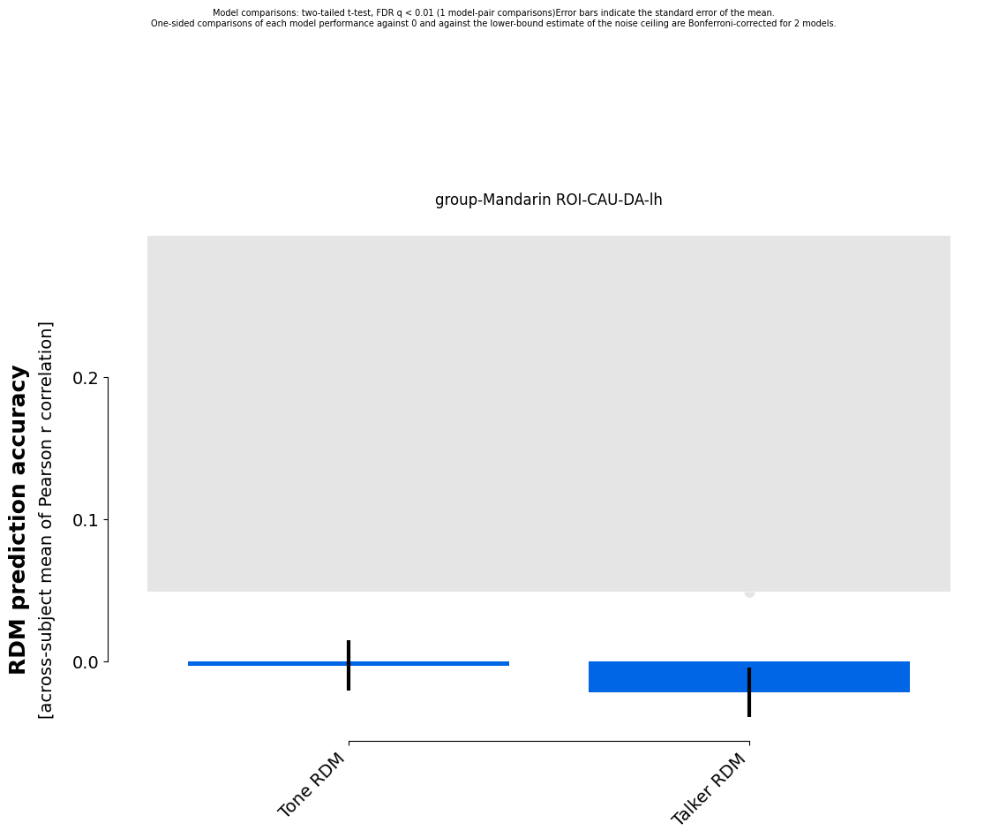

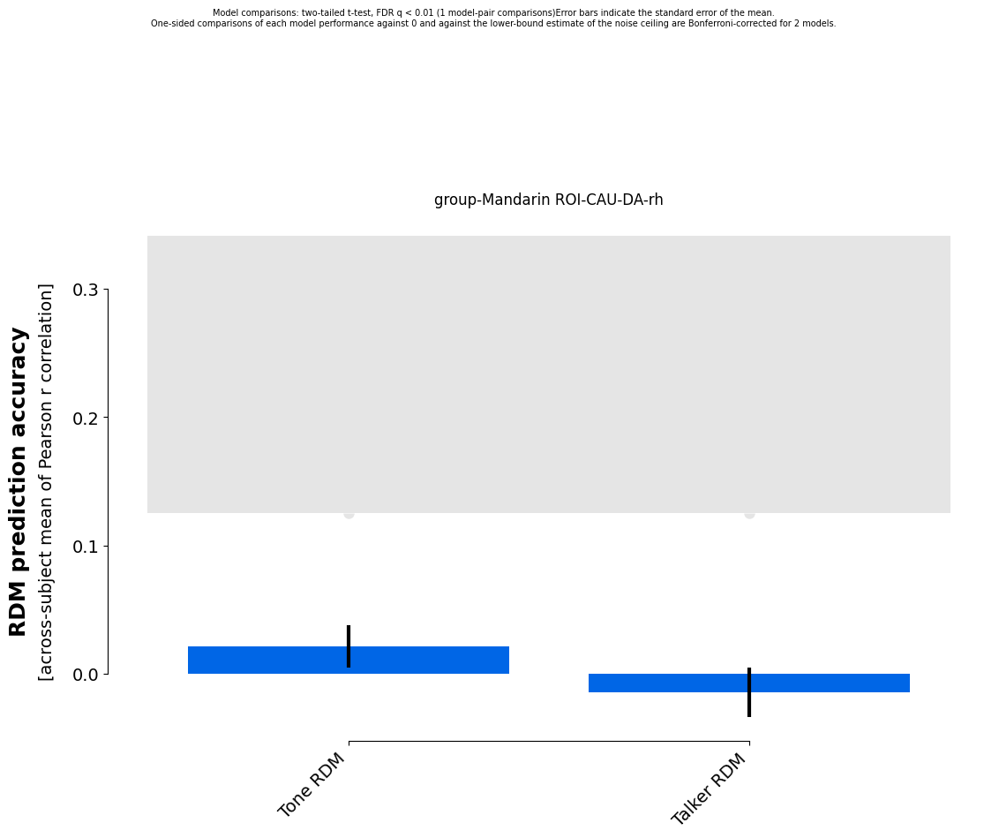

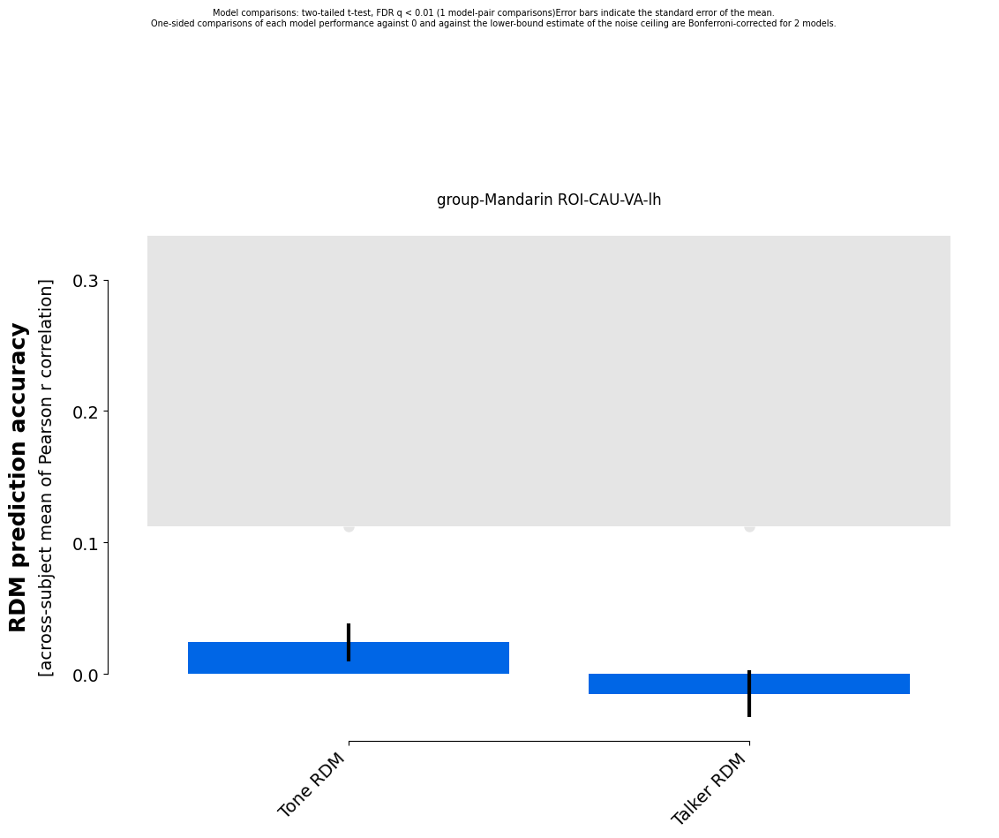

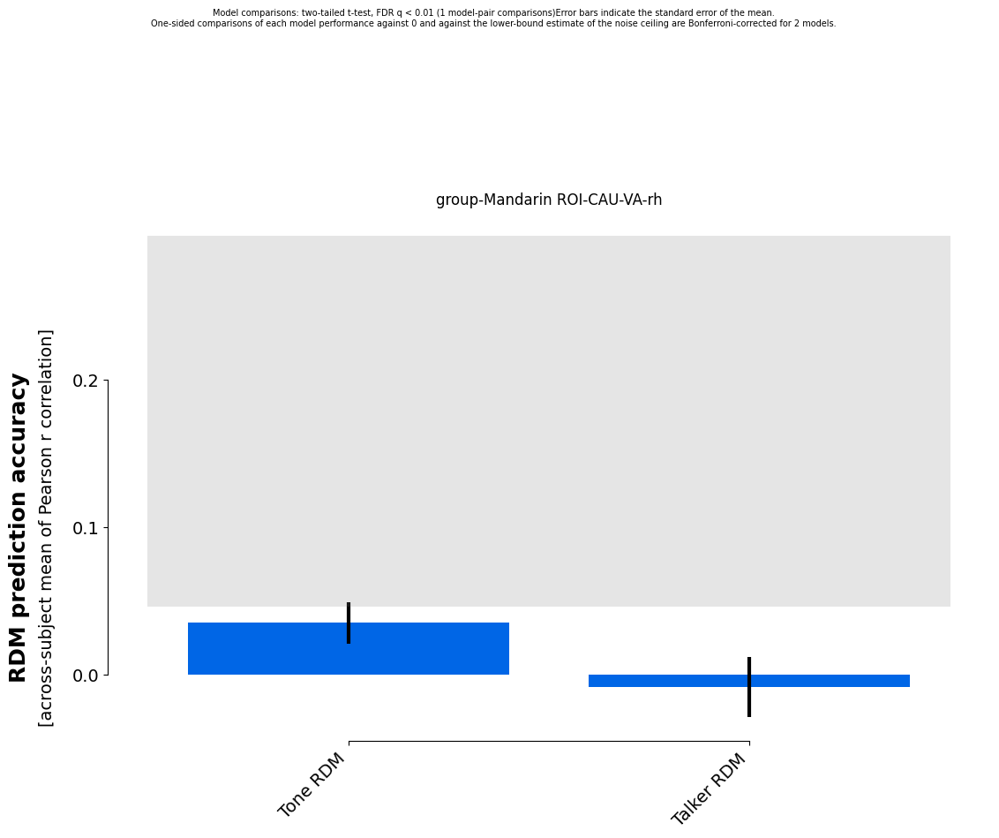

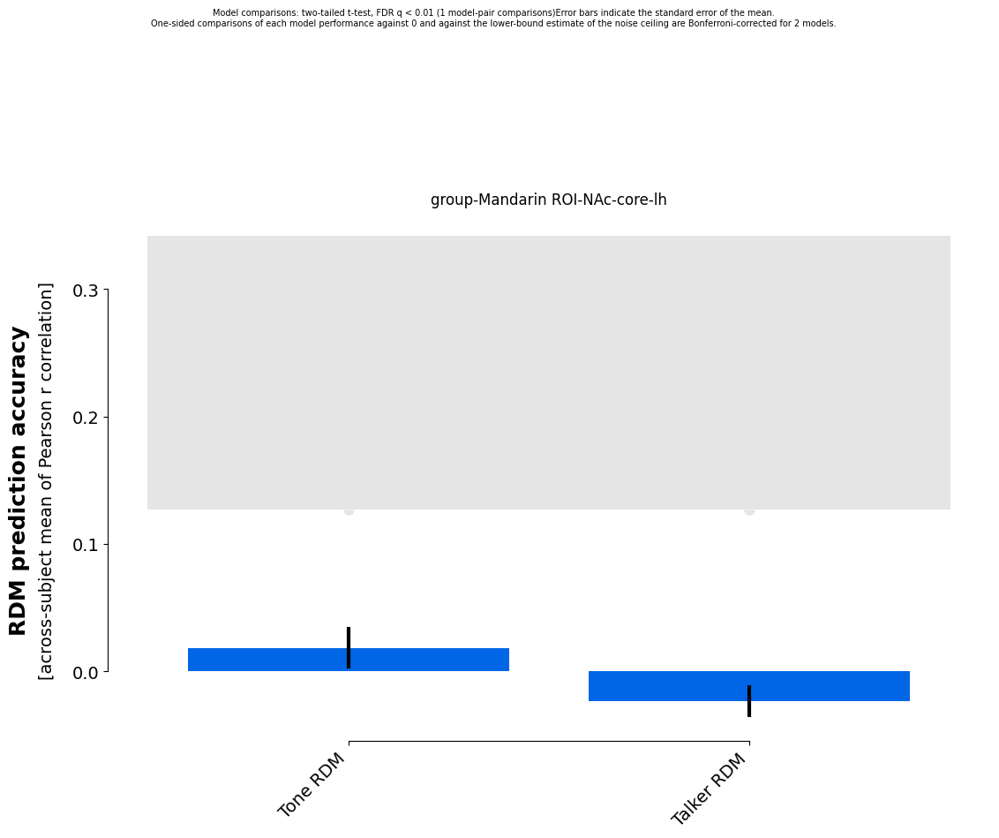

...

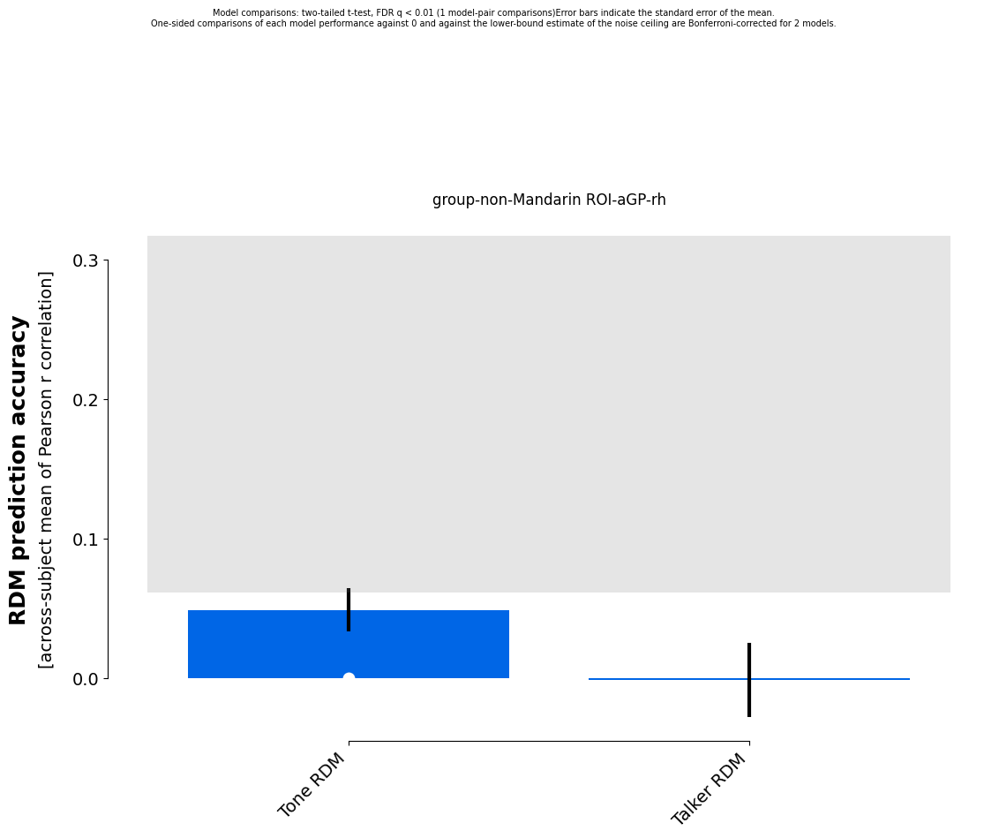

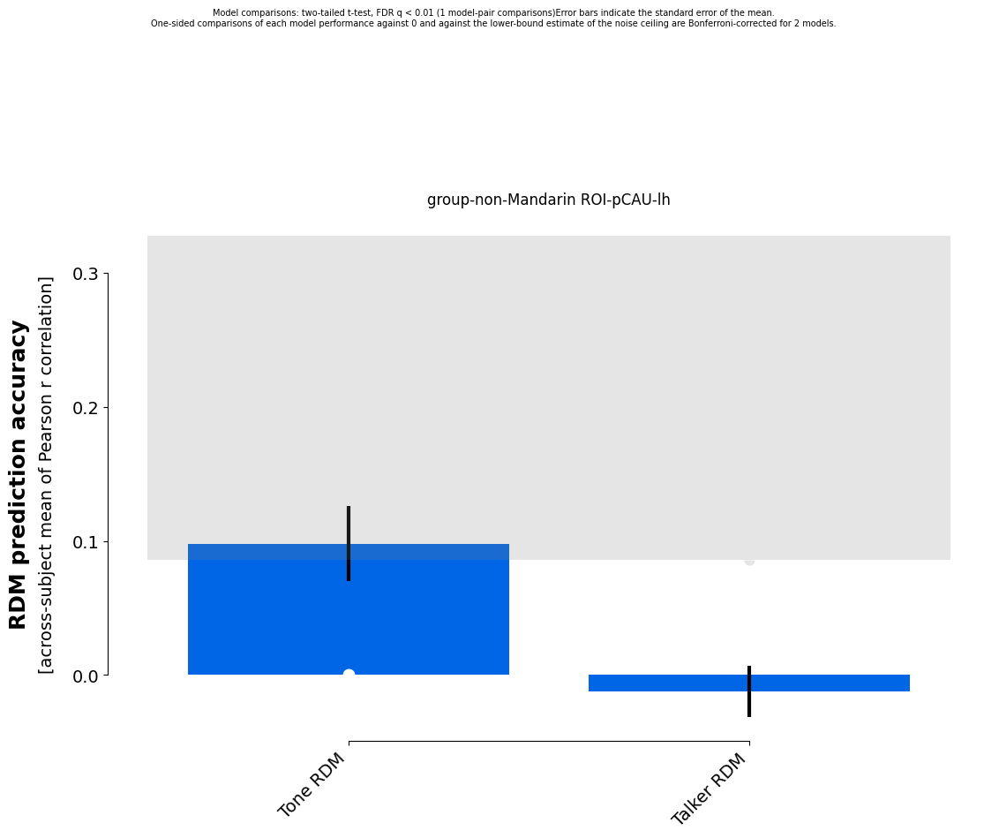

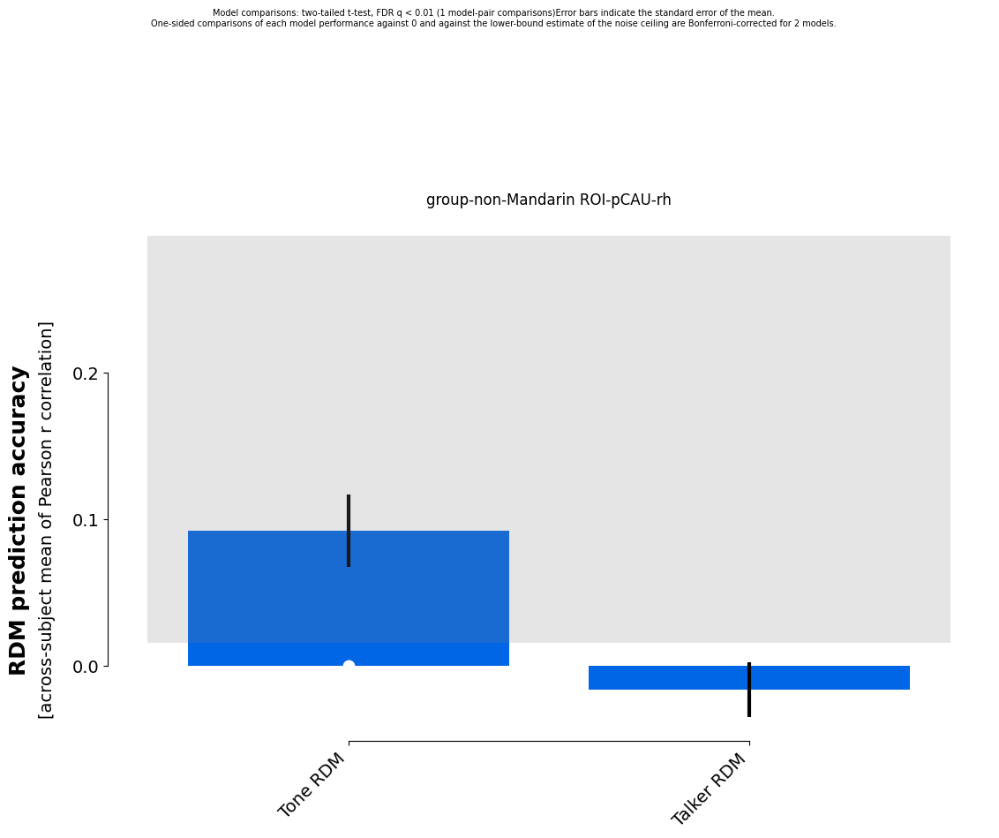

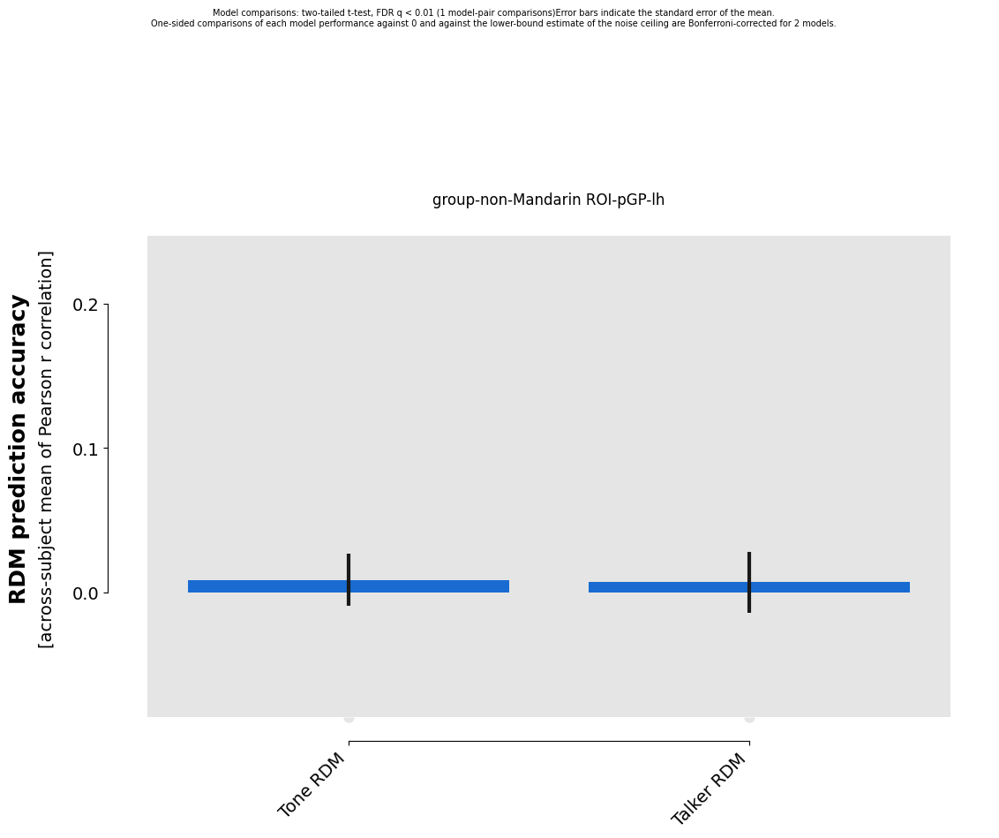

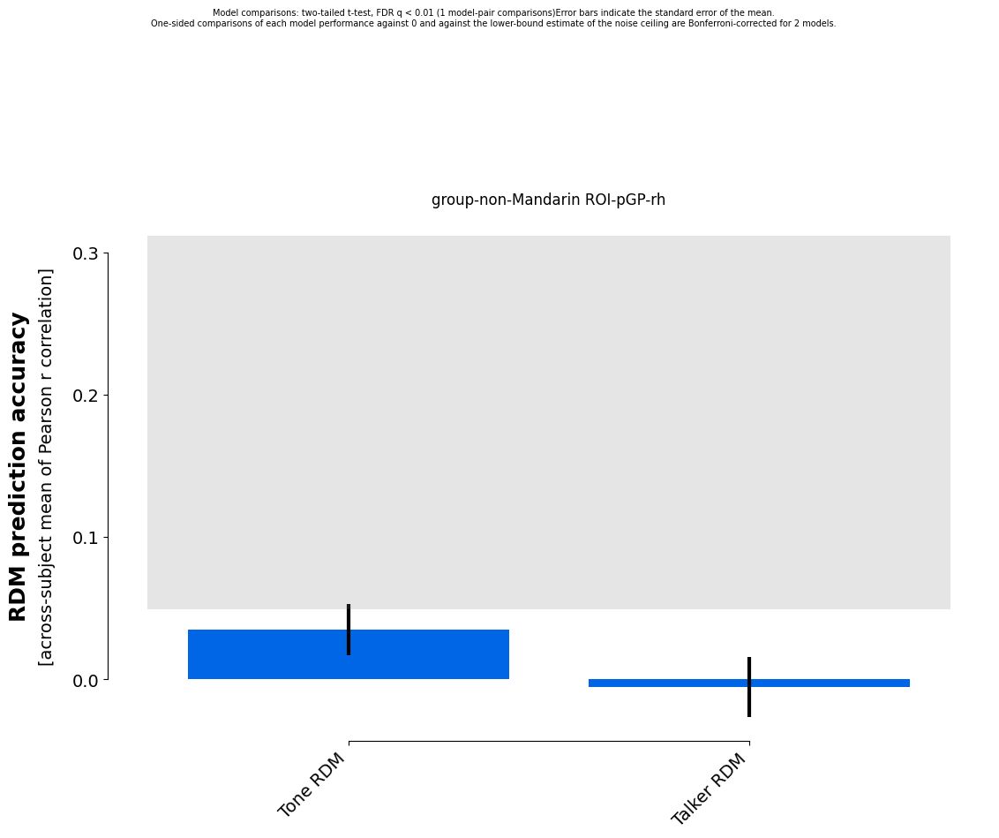

In [111]:
'''
group = 'Mandarin'
ROI = 'mask-R-ParsTri'
'''
roi_results = {}
for group in np.unique(runall_rdms.rdm_descriptors['group']):
    roi_results[group] = {}
    for ROI in np.unique(runall_rdms.rdm_descriptors['ROI']):
        print(f'group-{group} ROI-{ROI}')
        results_grr = rsatoolbox.inference.eval_fixed(all_models, 
                                                      runall_rdms.subset('group', value=group).subset('ROI',value=ROI),  
                                                      method='corr',)
        
        fig, ax1, ax2 = rsatoolbox.vis.plot_model_comparison(results_grr);
        ax1.set_title(f'group-{group} ROI-{ROI}');
        ax1.axes.set_xticklabels(ax1.xaxis.get_majorticklabels(), ha="right")
        
        results_grr.save(f'results-eval/run-all/results-eval_denoised_run-all_group-{group}_{network_name}_ROI-{ROI}.hdf5',overwrite=True)
        
        roi_results[group][ROI] = {}
        roi_results[group][ROI]['Tone'] = results_grr.to_dict()['evaluations'][0][0]
        roi_results[group][ROI]['Talker'] = results_grr.to_dict()['evaluations'][0][1]
        #roi_results[group][ROI] = results_grr.to_dict()['evaluations']
        

In [102]:
results_grr.to_dict()['evaluations']

array([[[ 0.0026862 ,  0.10090646, -0.06258141, -0.05889384,
          0.08359273, -0.01462309, -0.06051162,  0.01372249,
          0.02758022, -0.08965085,  0.09007077, -0.05359025,
         -0.01520426],
        [-0.00897834, -0.06194573,  0.00134612,  0.07898749,
          0.06318325, -0.01997125, -0.13277159, -0.07178078,
         -0.10760059,  0.03522995, -0.0260937 , -0.05064649,
          0.02250392]]])

In [61]:
print(results_grr.summary())

Results for running fixed evaluation for corr on 2 models:

Model      |   Eval ± SEM   | p (against 0) | p (against NC) |
--------------------------------------------------------------
Tone RDM   |  0.035 ± 0.018 |        0.039  |         0.436  |
Talker RDM | -0.005 ± 0.021 |        0.595  |         0.026  |

p-values are based on uncorrected t-tests


#### Custom plots

In [104]:
roi_results

{'Mandarin': {'CAU-DA-lh': {'Tone': array([ 0.0026862 ,  0.10090646, -0.06258141, -0.05889384,  0.08359273,
          -0.01462309, -0.06051162,  0.01372249,  0.02758022, -0.08965085,
           0.09007077, -0.05359025, -0.01520426]),
   'Talker': array([-0.00897834, -0.06194573,  0.00134612,  0.07898749,  0.06318325,
          -0.01997125, -0.13277159, -0.07178078, -0.10760059,  0.03522995,
          -0.0260937 , -0.05064649,  0.02250392])},
  'CAU-DA-rh': {'Tone': array([ 0.15143306,  0.10664858, -0.04309466,  0.00153343,  0.05130456,
          -0.03553317,  0.02195701, -0.00285906,  0.03608224, -0.05157451,
           0.0431768 , -0.02543118,  0.02111727]),
   'Talker': array([-0.08929137, -0.07422059,  0.01706326,  0.10044188, -0.04017822,
          -0.03724896, -0.11117269, -0.04973175, -0.00424715,  0.1096255 ,
           0.02513402, -0.06949733,  0.03191671])},
  'CAU-VA-lh': {'Tone': array([ 0.07851315,  0.00310602, -0.03887132,  0.00373254,  0.03928001,
           0.07284934,  

In [110]:
pd.DataFrame.from_dict(roi_results['Mandarin'], orient='index')

,Tone,Talker
CAU-DA-lh,"[0.002686199966923636, 0.10090646122293268, -0...","[-0.008978338640456707, -0.0619457349258626, 0..."
CAU-DA-rh,"[0.15143305957535022, 0.10664857839431807, -0....","[-0.08929137280242475, -0.07422058705843021, 0..."
CAU-VA-lh,"[0.078513151173939, 0.0031060157856165273, -0....","[-0.06188865588196005, -0.13914048713262323, 0..."
CAU-VA-rh,"[-0.005764416391944989, 0.10645080165644169, -...","[0.03499753193502037, -0.08418328018870913, -0..."
NAc-core-lh,"[0.04553763476037041, 0.08517102764530152, -0....","[-0.021642619629216417, -0.023816674919511824,..."
NAc-core-rh,"[-0.0005884875191884217, -0.007493959275046661...","[-0.03906303908748455, -0.11104536238996227, 0..."
NAc-shell-lh,"[0.02144116842368015, -0.04574958024670876, -0...","[-0.04236356001348158, -0.07937076753099506, 0..."
NAc-shell-rh,"[-0.008072166525829805, -0.03916321149795521, ...","[-0.05249848539979239, -0.013902006190481899, ..."
PUT-DA-lh,"[0.0024100939598891463, -0.05317153720171973, ...","[-0.12114140135308914, 0.07545193885277186, 0...."
PUT-DA-rh,"[-0.04343888798457437, 0.06807715185154714, -0...","[-0.056405534527782866, -0.049093743521662084,..."


## TEST: Categorical model comparisons

In [62]:
results_1 = []
for roi in roi_list:
    print(roi)
    results_1.append(rsatoolbox.inference.eval_fixed(cat_models, 
                                                     runall_rdms.subset('ROI', value=roi).subset('group', value='non-Mandarin'), 
                                                     method='corr',))


CAU-DA-lh
CAU-VA-lh
pCAU-lh
PUT-DA-lh
PUT-DP-lh
PUT-VA-lh
PUT-VP-lh
aGP-lh
pGP-lh
NAc-core-lh
NAc-shell-lh
CAU-DA-rh
CAU-VA-rh
pCAU-rh
PUT-DA-rh
PUT-DP-rh
PUT-VA-rh
PUT-VP-rh
aGP-rh
pGP-rh
NAc-core-rh
NAc-shell-rh


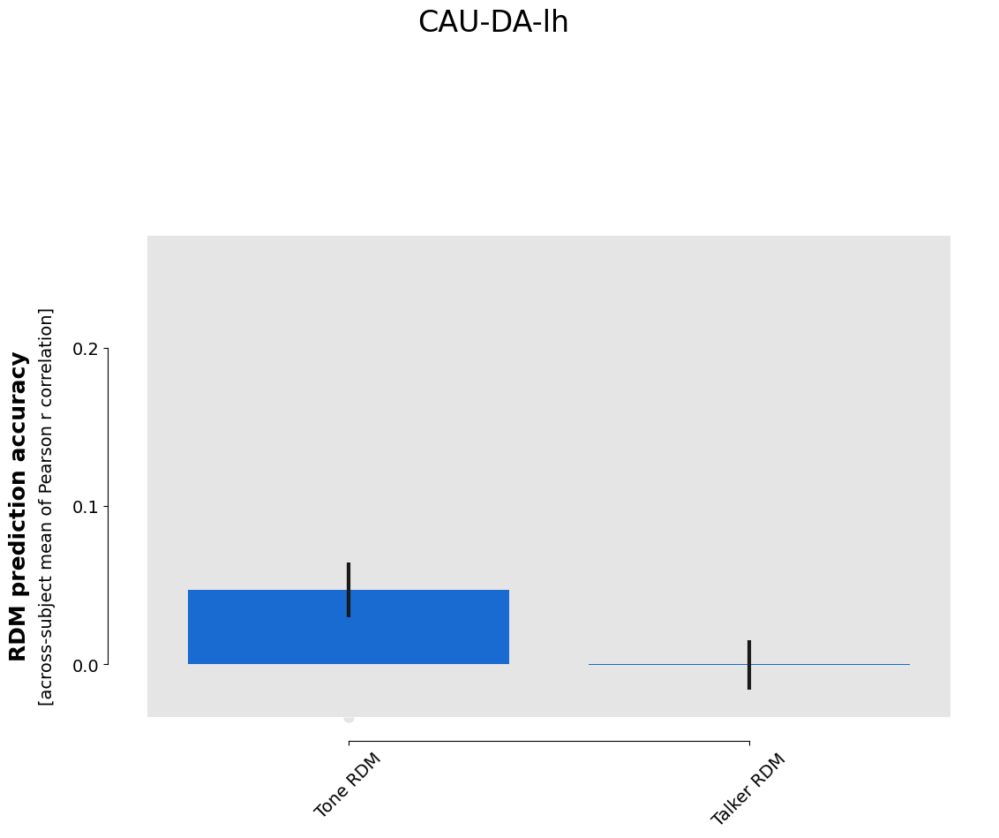

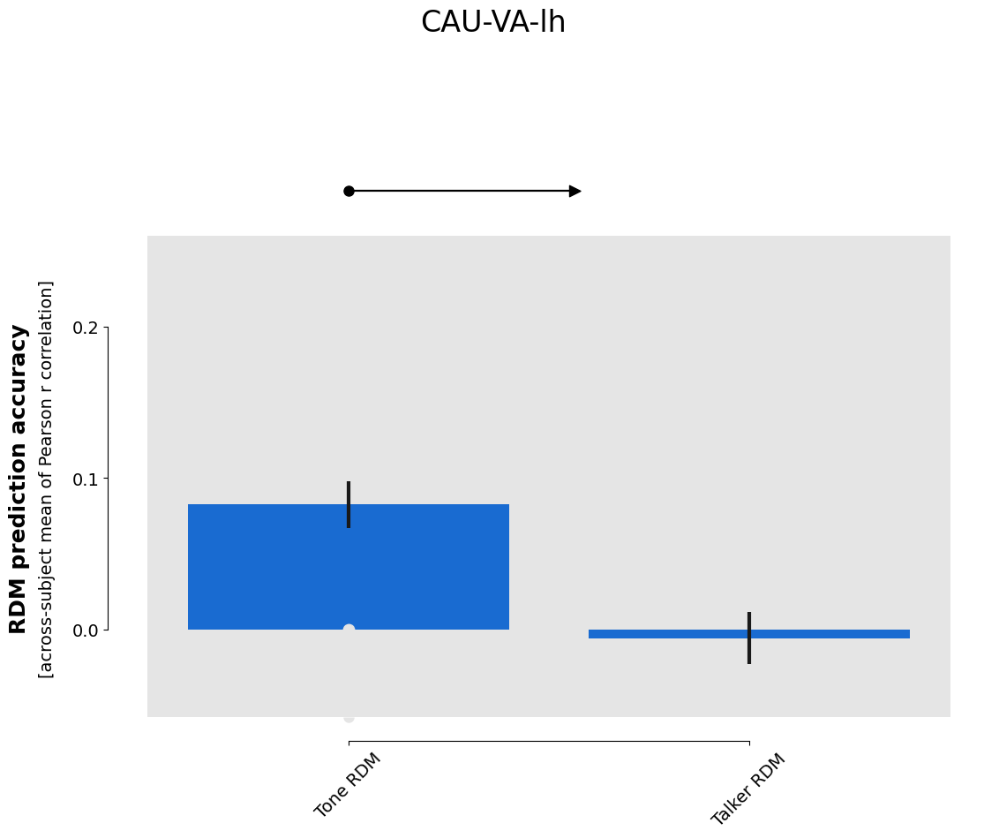

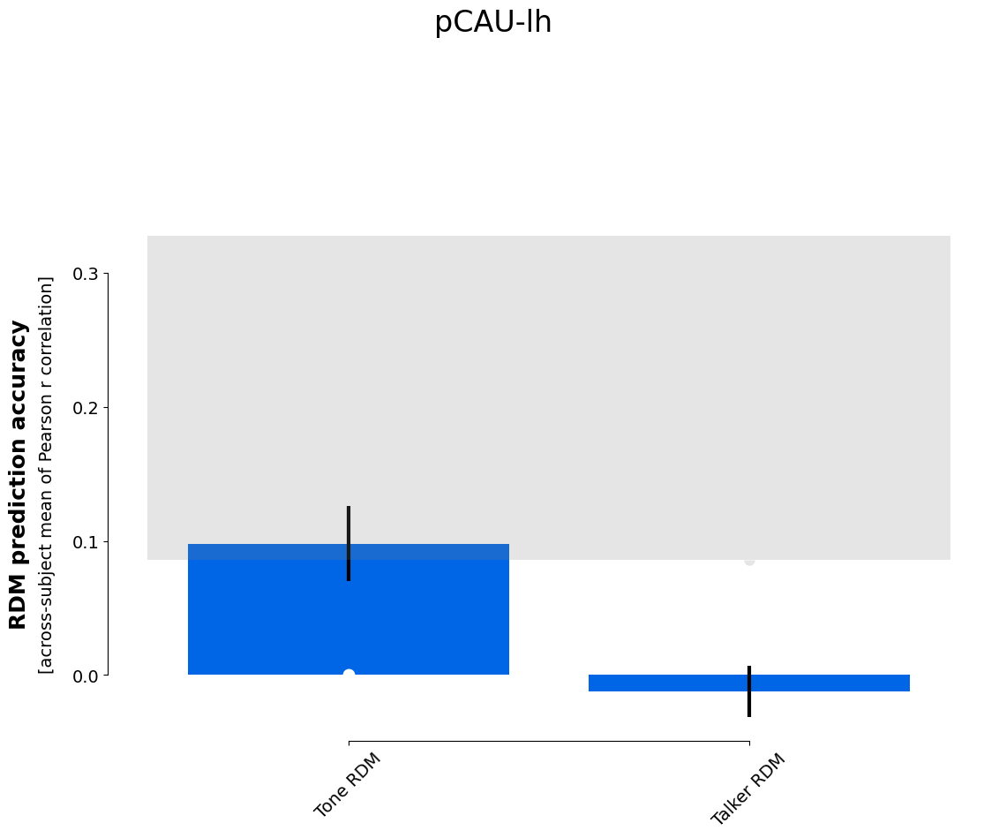

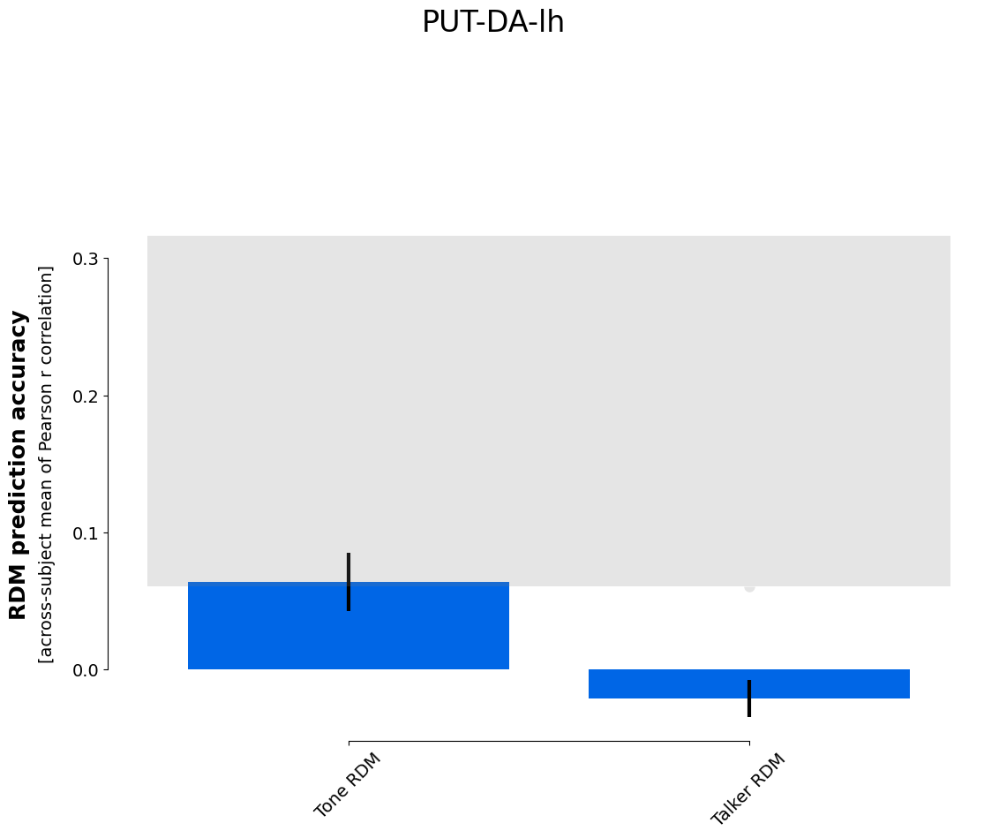

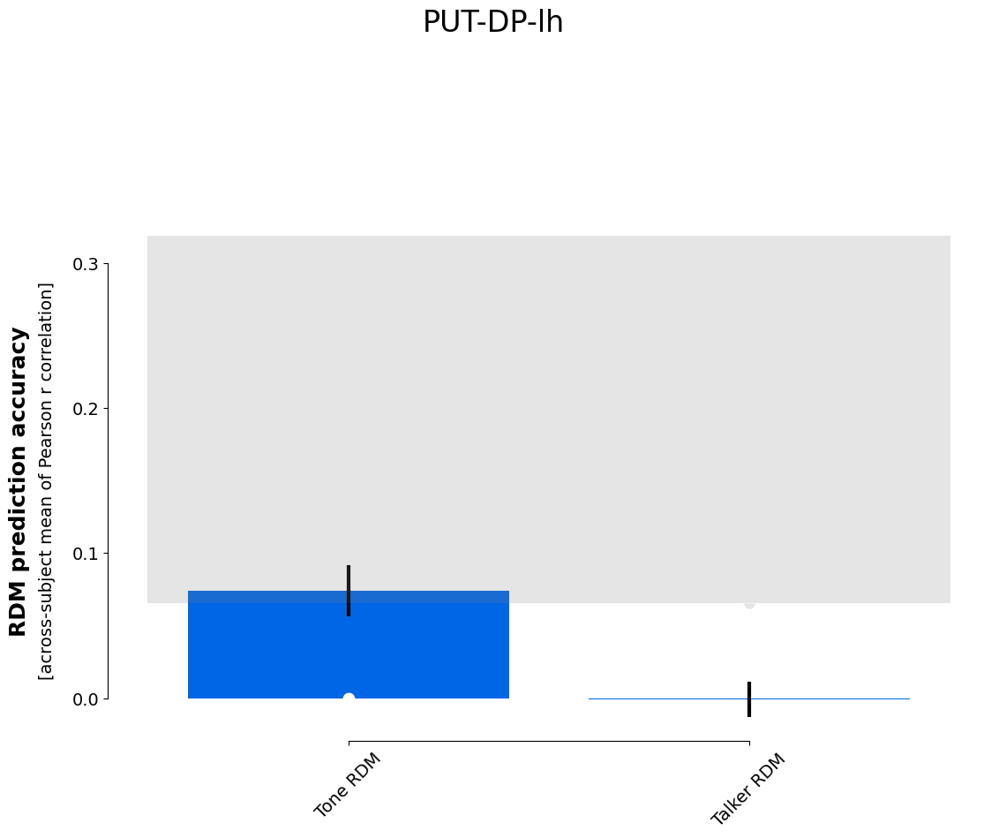

...

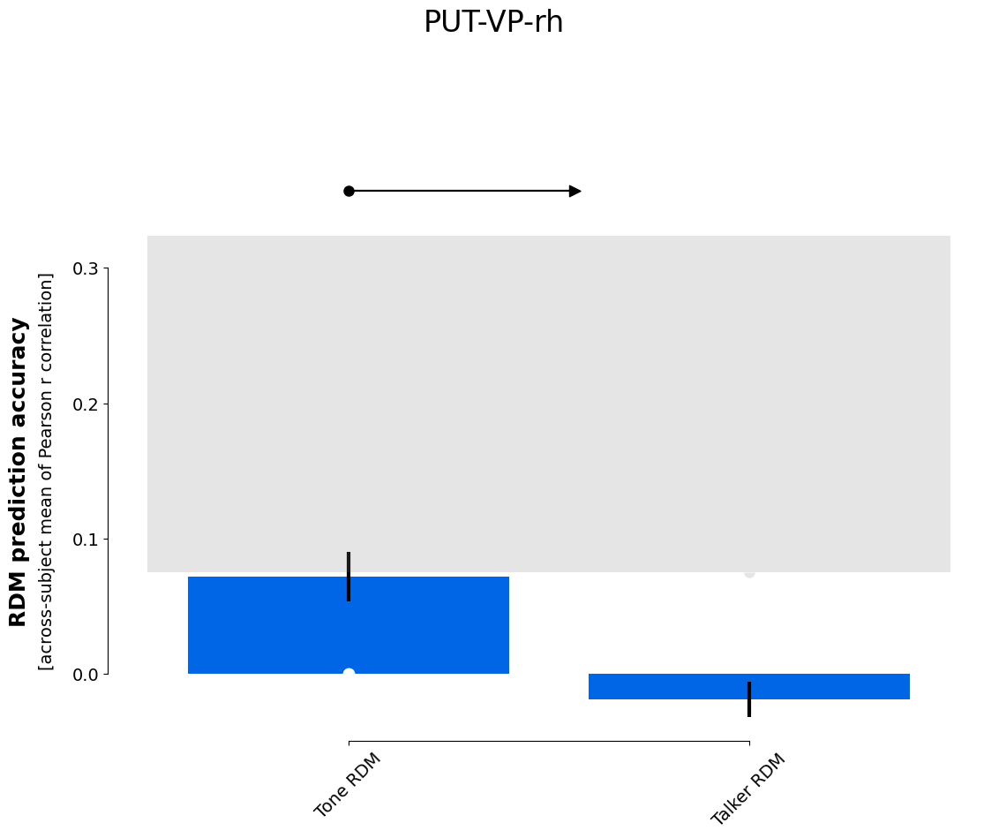

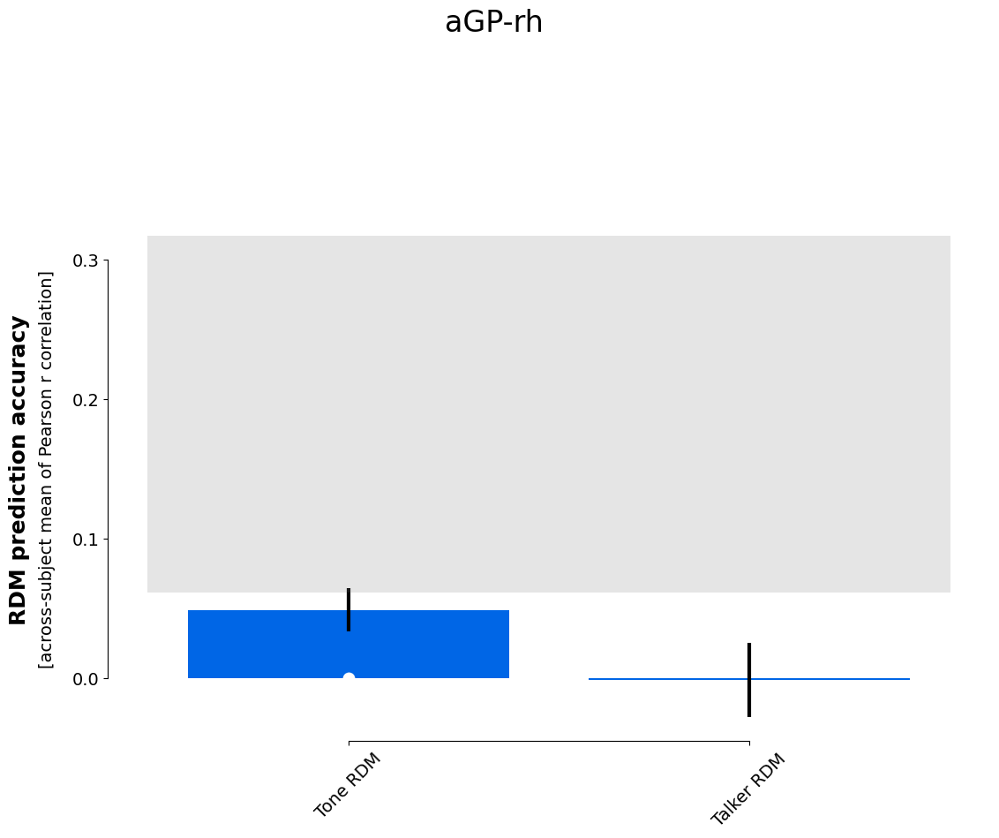

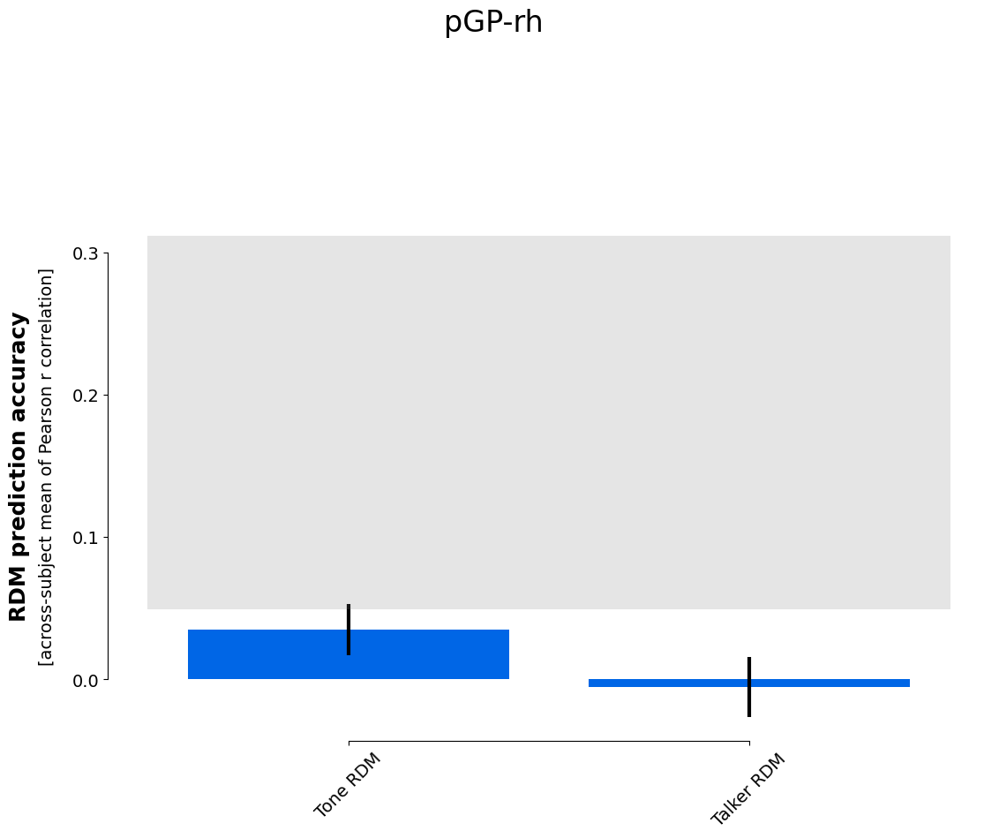

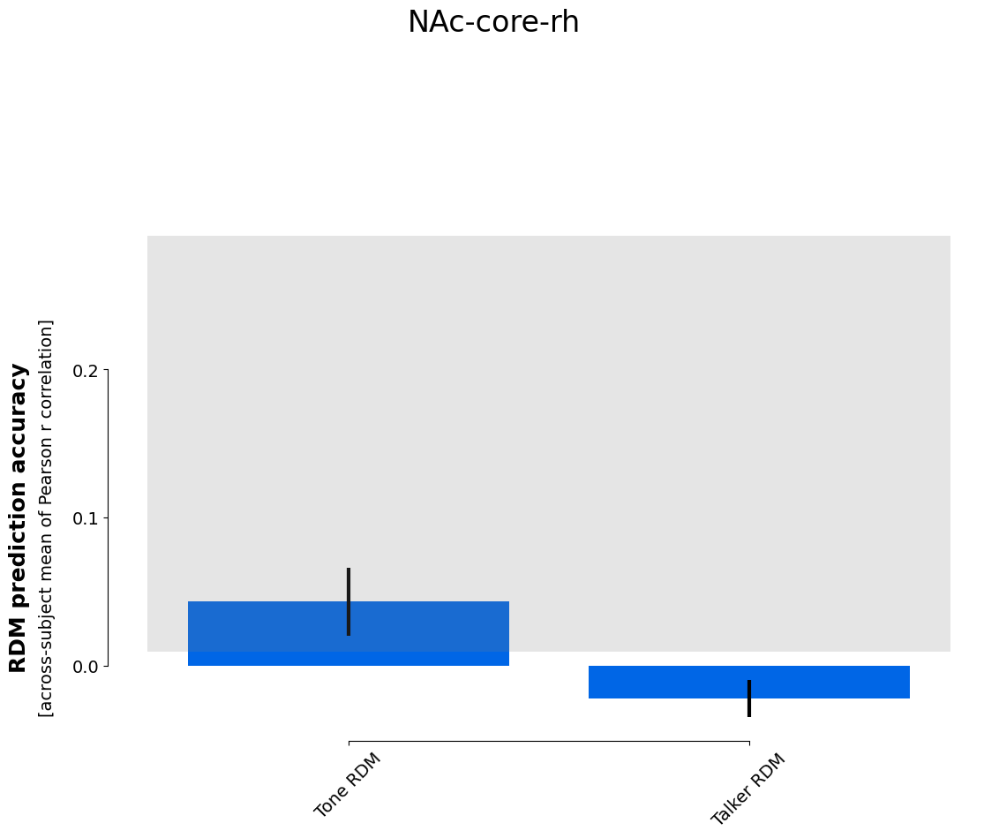

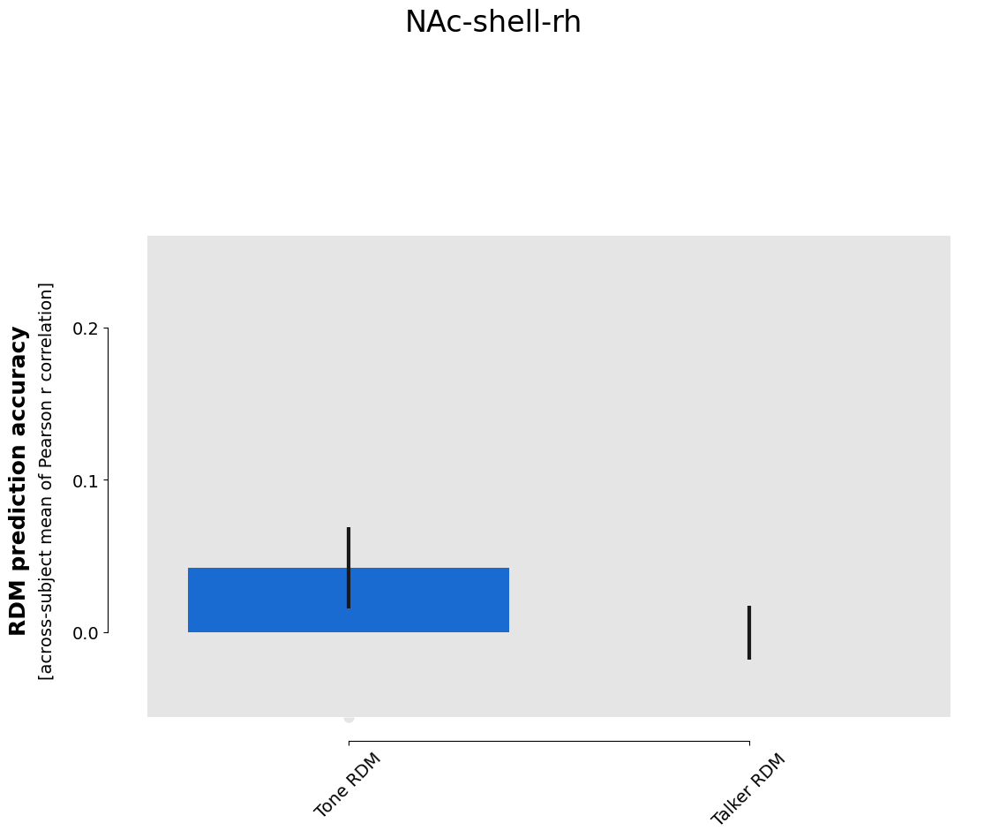

In [63]:
for rx, roi in enumerate(roi_list):
    fig = rsatoolbox.vis.plot_model_comparison(results_1[rx])
    fig[0].suptitle(roi, fontsize=24)

In [64]:
results_boot = rsatoolbox.inference.eval_dual_bootstrap(cat_models, runall_rdms, rdm_descriptor='ROI')

100%|██████████| 1000/1000 [00:56<00:00, 17.62it/s]


(<Figure size 1250x1000 with 2 Axes>, <Axes: >, <Axes: >)

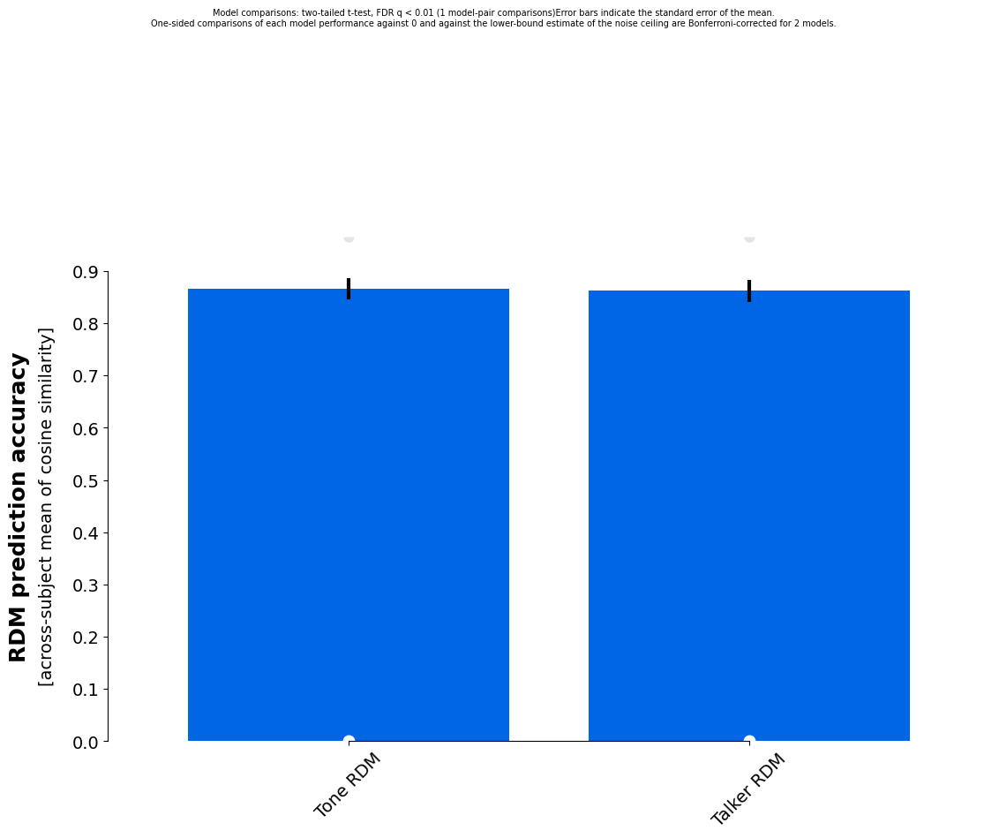

In [65]:
rsatoolbox.vis.plot_model_comparison(results_boot)

## WIP: Hierarchical representation tests

In [40]:
neural_models_dict = {}

neural_models_dict['Mandarin'] = [ModelFixed(x, rdm=mean_rdms_mand.subset('group', value='Mandarin').subset('ROI',value=x)) for x in np.unique(mean_rdms_mand.rdm_descriptors['ROI'])]
neural_models_dict['non-Mandarin'] = [ModelFixed(x, rdm=mean_rdms_nman.subset('group', value='non-Mandarin').subset('ROI',value=x)) for x in np.unique(mean_rdms_nman.rdm_descriptors['ROI'])]


In [ ]:
for group in np.unique(runall_rdms.rdm_descriptors['group']): # ['non-Mandarin']:# 
    for ROI in np.unique(runall_rdms.rdm_descriptors['ROI']):
        print(f'group-{group} ROI-{ROI}')
        results_grr = rsatoolbox.inference.eval_fixed(neural_models_dict[group], 
                                                      runall_rdms.subset('group', value=group).subset('ROI',value=ROI),  
                                                      method='corr',)
        fig, ax1, ax2 = rsatoolbox.vis.plot_model_comparison(results_grr,
                                                             test_pair_comparisons='nili', #False, # getting a bug from plot_arrow()
                                                            );
        ax1.set_title(f'group-{group} ROI-{ROI}');
        ax1.axes.set_xticklabels(ax1.xaxis.get_majorticklabels(), ha="right")